# How do results change with population variations

In [1]:
import cogsworth
import astropy.units as u
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import gala.dynamics as gd
import os

In [2]:
import sys
sys.path.append("../src")
import plotting

In [3]:
import h5py as h5

In [4]:
%config InlineBackend.figure_format = 'retina'

pd.options.display.max_columns = 999

plt.rc('font', family='serif')
plt.rcParams['text.usetex'] = False
fs = 24

# update various fontsizes to match
params = {'figure.figsize': (12, 8),
          'legend.fontsize': fs,
          'axes.labelsize': fs,
          'xtick.labelsize': 0.9 * fs,
          'ytick.labelsize': 0.9 * fs,
          'axes.linewidth': 1.1,
          'xtick.major.size': 7,
          'xtick.minor.size': 4,
          'ytick.major.size': 7,
          'ytick.minor.size': 4}
plt.rcParams.update(params)

In [5]:
from importlib import reload
reload(plotting)

<module 'plotting' from '/mnt/home/twagg/supernova-feedback/notebooks/../src/plotting.py'>

# Read data

In [24]:
pop_details = {
    "file_names": ["fiducial", "singles",
                   "imf-1.9", "imf-2.7",
                   "porb-0", "porb-minus1", "porb-max-3", "q-plus1", "q-minus1",
                   "Z-0.05", "Z-0.1", "Z-0.2", "Z-0.5",
                   "ce-0.1", "ce-10.0", "qcritB-0.0", "qcritB-1000.0",
                   "beta-0.0", "beta-0.5", "beta-1.0",
                   "ccsn-20", "ecsn-265", "no-fallback",
                   "v-disp-0.5", "v-disp-5", "r442-Zx2"],
    "labels": np.array(["Fiducial", r"$f_{\rm bin} = 0.0$",
               r"$\alpha_{\rm IMF} = -1.9$", r"$\alpha_{\rm IMF} = -2.7$",
               r"$\pi = 0$", r"$\pi = -1$", r"$P_{\rm 0, max} = 10^{3} \, {\rm d}$", r"$\kappa = 1$", r"$\kappa = -1$",
               r"$Z = 0.05 \, Z_{\rm m11h}$", r"$Z = 0.1 \, Z_{\rm m11h}$", r"$Z = 0.2 \, Z_{\rm m11h}$", r"$Z = 0.5 \, Z_{\rm m11h}$",
               r"$\alpha_{\rm CE} = 0.1$", r"$\alpha_{\rm CE} = 10.0$",
               "Case B\nUnstable", "Case B\nStable",
               r"$\beta = 0.0$", r"$\beta = 0.5$",
               r"$\beta = 1.0$", r"$\gamma = \gamma_{\rm disc}$",
               r"$\sigma_{\rm CC} = $" + "\n" + r"$20 \, {\rm km/s}$", r"$\sigma_{\rm low} = $" + "\n" + r"$265 \, {\rm km/s}$", "No fallback",
               r"$v_{\rm disp} = 0.5 \, {\rm km/s}$", r"$v_{\rm disp} = 5 \, {\rm km/s}$", "ChaNGa (r442)"]),
}

In [22]:
%%time
pops = {file_name: cogsworth.pop.load(f"/mnt/home/twagg/ceph/pops/feedback-variations/{file_name}.h5", parts=[])
        if os.path.isfile(f"/mnt/home/twagg/ceph/pops/feedback-variations/{file_name}.h5") else None
        for file_name in pop_details["file_names"]}

CPU times: user 16.5 s, sys: 294 µs, total: 16.5 s
Wall time: 20.1 s


In [25]:
%%time
for p in ["fiducial", "porb-max-3", "r442-Zx2"]:#[pops]:
    print(p)
    plotting.set_sn_subpop_masks(pops[p]);
    # pops[p]._bpp = pd.read_hdf(f"/mnt/home/twagg/ceph/pops/feedback-variations/{p}.h5", key="bpp")

fiducial
16426 283504 182812 378076
porb-max-3
16582 283886 183332 376709
r442-Zx2
17658 298648 192126 400814
CPU times: user 21.9 s, sys: 13.1 s, total: 35 s
Wall time: 1min 29s


In [35]:
for p in pops:
    sn_rows = pops[p].bpp[((pops[p].bpp["evol_type"] == 15) | (pops[p].bpp["evol_type"] == 16)) & ~pops[p].bpp["bin_num"].isin(pops[p].duplicate_sn)]
    pops[p].had_sn = np.isin(pops[p].bin_nums, sn_rows["bin_num"].unique())

AttributeError: 'Population' object has no attribute 'duplicate_sn'

In [26]:
for p in ["fiducial", "porb-max-3", "r442-Zx2"]:#pops:
    f = np.load(f"/mnt/home/twagg/ceph/pops/feedback-variations/sn_positions-{p}.npz")
    pops[p].primary_sn_distances, pops[p].secondary_sn_distances = f["arr_0"] * u.kpc, f["arr_1"] * u.kpc

## Stats

In [55]:
stats = {"Variation": pop_details["labels"]}

In [56]:
f_late = []
for p in pop_details["file_names"]:
    sn_times = np.concatenate(plotting.get_data_and_weights(pops[p], "time", [1])[0])
    f_late.append((sn_times > 44).sum() / len(sn_times))
stats[r"$f_{t > 44 \, {\rm Myr}}$"] = f_late

In [61]:
print("Fraction SN > 100pc \n")
f_far = []
for p in pop_details["file_names"]:
    total_sn = len(pops[p].sn_1) + len(pops[p].sn_2)
    total_far = (pops[p].primary_sn_distances > 100 * u.pc).sum() + (pops[p].secondary_sn_distances > 100 * u.pc).sum()
    f_far.append(total_far / total_sn)
stats[r"$f_{D > 100 \, {\rm pc}}$"] = f_far

Fraction SN > 100pc 



In [62]:
print("Fraction SN > 500pc \n")
f_tails = []
for p in pop_details["file_names"]:
    total_sn = len(pops[p].sn_1) + len(pops[p].sn_2)
    total_tails = (pops[p].primary_sn_distances > 500 * u.pc).sum() + (pops[p].secondary_sn_distances > 500 * u.pc).sum()
    f_tails.append(total_tails / total_sn)
stats[r"$f_{D > 500 \, {\rm pc}}$"] = f_tails

Fraction SN > 500pc 



In [63]:
def merger_sn_fraction(p):
    return (p.sn_1_merger.sum() + p.sn_2_merger.sum()) / (p.sn_1_merger.sum() + p.sn_2_merger.sum() + p.sn_1.sum() + p.sn_2.sum() + p.sn_1_singles.sum() + p.sn_2_singles.sum())

def n_merger_sn(p):
    return (p.sn_1_merger.sum() + p.sn_2_merger.sum())

In [64]:
def dict_to_latex_table(d, cols=None, indent=8):

    if cols is None:
        cols = "l" * len(d.keys())

    table_rows = [r"\begin{tabular}{" + cols + "}"]
    table_rows.append("\hline\hline")
    
    table_rows.append(' & '.join(stats.keys()) + r" \\")
    table_rows.append("\hline")
                      
    for i in range(len(d["Variation"])):
        table_rows.append(' & '.join([d[k][i].replace("\n", " ") if isinstance(d[k][i], str) else fr"{d[k][i] * 100:1.1f}\%" for k in d]) + r" \\")
    table_rows.append(r"\end{tabular}")

    for i in range(len(table_rows)):
        table_rows[i] = " " * indent + table_rows[i]

    return "\n".join(table_rows)

In [65]:
print(dict_to_latex_table(stats, cols="l|c|cc"))

        \begin{tabular}{l|c|cc}
        \hline\hline
        Variation & $f_{t > 44 \, {\rm Myr}}$ & $f_{D > 100 \, {\rm pc}}$ & $f_{D > 500 \, {\rm pc}}$ \\
        \hline
        Fiducial & 25.3\% & 13.4\% & 0.9\% \\
        $f_{\rm bin} = 0.0$ & 1.3\% & 0.9\% & 0.0\% \\
        $\alpha_{\rm IMF} = -1.9$ & 17.9\% & 11.0\% & 1.0\% \\
        $\alpha_{\rm IMF} = -2.7$ & 32.9\% & 15.5\% & 0.8\% \\
        $\pi = 0$ & 17.5\% & 11.6\% & 1.0\% \\
        $\pi = -1$ & 32.7\% & 14.7\% & 0.8\% \\
        $\kappa = 1$ & 27.4\% & 13.6\% & 0.6\% \\
        $\kappa = -1$ & 22.5\% & 11.9\% & 1.2\% \\
        $Z = 0.05 \, Z_{\rm m11h}$ & 34.4\% & 22.3\% & 2.4\% \\
        $Z = 0.1 \, Z_{\rm m11h}$ & 33.5\% & 21.1\% & 1.5\% \\
        $Z = 0.2 \, Z_{\rm m11h}$ & 31.8\% & 19.9\% & 1.3\% \\
        $Z = 0.5 \, Z_{\rm m11h}$ & 29.1\% & 17.0\% & 1.0\% \\
        $\alpha_{\rm CE} = 0.1$ & 24.9\% & 12.3\% & 0.5\% \\
        $\alpha_{\rm CE} = 10.0$ & 13.9\% & 12.0\% & 0.9\% \\
        Case B Unstable & 31

## Stats plot

In [178]:
stat_plot_order = [
    "fiducial",
    "ce-0.1", "ce-10.0", "qcritB-0.0", "qcritB-1000.0",
                   "beta-0.0", "beta-0.5", "beta-1.0",
                   "ccsn-20", "ecsn-265", "no-fallback",
    "imf-1.9", "imf-2.7",
    "porb-0", "porb-minus1", "q-plus1", "q-minus1",
    "r442", "Z-0.5", "Z-0.2", "Z-0.1", "Z-0.05",
    "alpha-vir-0.1", "alpha-vir-10.0",
]
stat_plot_inds = [pop_details["file_names"].index(o) for o in stat_plot_order]
y_vals = np.array([v for v in np.arange(len(stat_plot_inds))], dtype="float")
gaps = [1, 11, 22]
gap_size = 0.5
for gap in gaps:
    y_vals[gap:] += gap_size

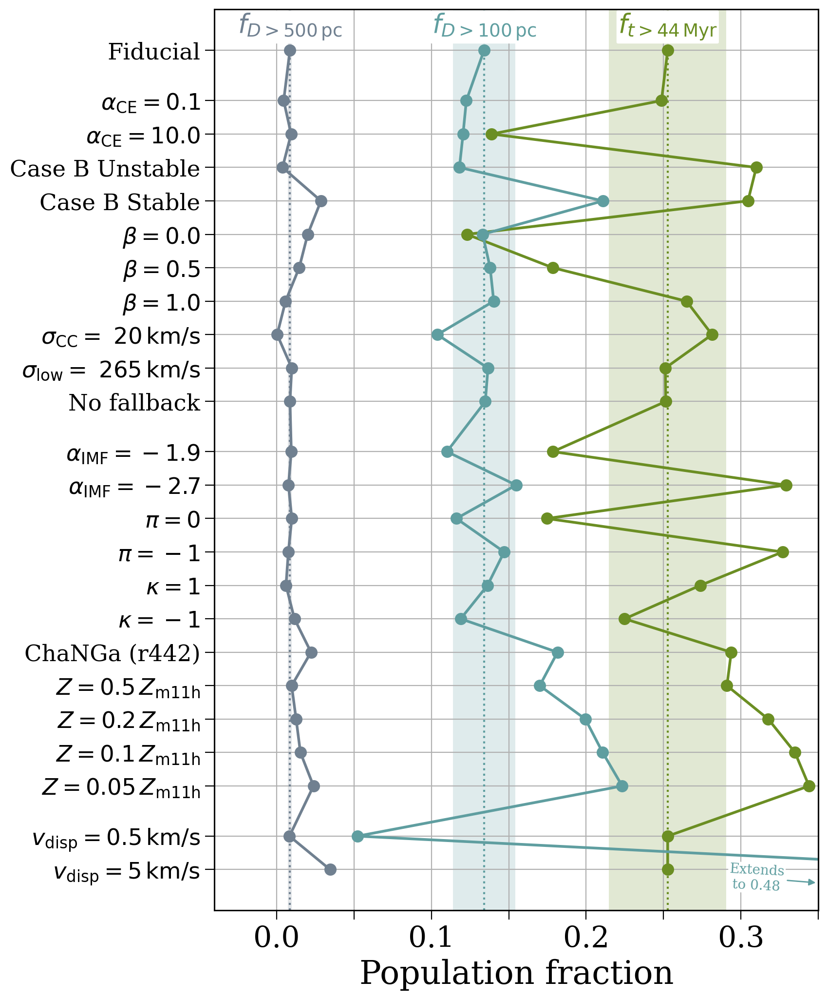

In [214]:
fig, ax = plt.subplots(figsize=(8, 12))

stat_cs = ["olivedrab", "cadetblue", "slategrey"]
stat_ls = [r"$f_{t > 44 \, {\rm Myr}}$", r"$f_{D > 100 \, {\rm pc}}$", r"$f_{D > 500 \, {\rm pc}}$"]

span = 0.15

for stat, c, l in zip([f_late, f_far, f_tails], stat_cs, stat_ls):
    ax.plot([stat[i] for i in stat_plot_inds], y_vals, marker="o", color=c, label=l, markersize=8, lw=2)
    ax.axvline(stat[0], color=c, linestyle="dotted")
    ax.axvspan(stat[0] * (1 - span), stat[0] * (1 + span), color=c, alpha=0.2, zorder=-1, lw=0)

ax.set(xlim=(-0.04, 0.35), xlabel="Population fraction")
ax.set_yticks(y_vals)
ax.set_yticklabels([pop_details["labels"][i].replace("\n", " ") if i != 1 else "Singles" for i in stat_plot_inds], fontsize=0.7*fs)

ax.set_xticks([0.0, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35])
ax.set_xticklabels([0.0, "", 0.1, "", 0.2, "", 0.3, ""])

for l, c, loc in zip(stat_ls, stat_cs,
                  [(f_late[0], -0.25), (f_far[0], -0.25), (f_tails[0], -0.25)]):
    ax.annotate(l, xy=loc, ha="center", va="bottom", fontsize=0.8*fs, bbox=dict(boxstyle="round", fc="white", ec="white", pad=0.03), color=c)

ax.grid()

ax.invert_yaxis()

ax.annotate("Extends\nto 0.48", xy=(0.35, len(stat_plot_inds) + 0.9), xytext=(0.31, len(stat_plot_inds) + 0.75), color=stat_cs[1], ha="center", va="center",
            bbox=dict(boxstyle="round", fc="white", ec="white", pad=0.03),
            arrowprops=dict(arrowstyle="-|>", color=stat_cs[1]), rotation=-3)

plt.savefig("../plots/tail_trends.pdf", format="pdf", bbox_inches="tight")

plt.show()

# Binary physics variations

In [11]:
bin_pop_file_names = ["fiducial", "ce-0.1", "ce-10.0",
                      "qcritB-0.0", "qcritB-1000.0",
                      "beta-0.0", "beta-0.5", "beta-1.0",
                      "ccsn-20", "ecsn-265", "no-fallback"]
bin_pops = {p:pops[p] for p in bin_pop_file_names}
bin_pop_labels = pop_details["labels"][np.isin(pop_details["file_names"], bin_pop_file_names)]

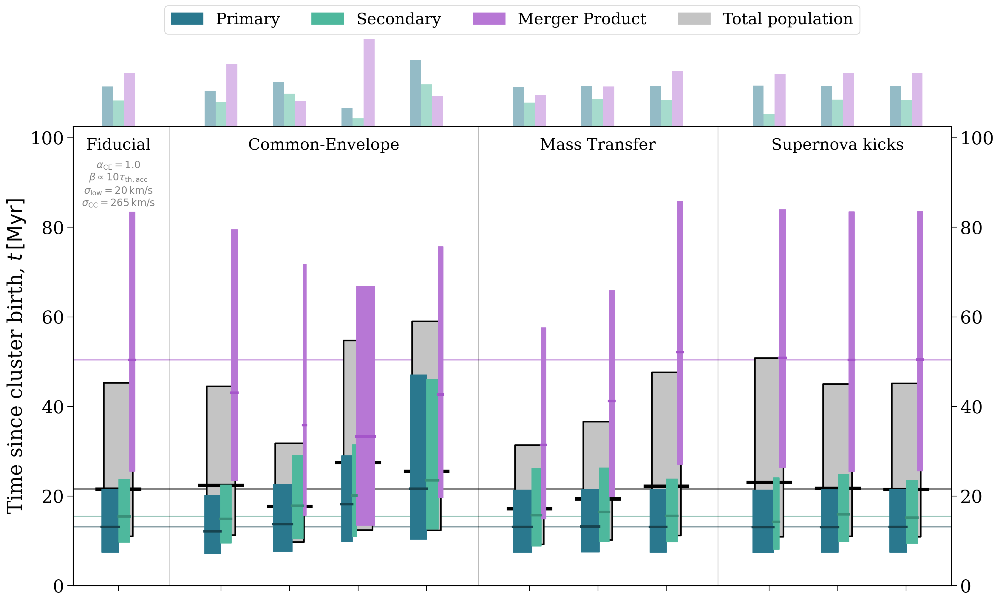

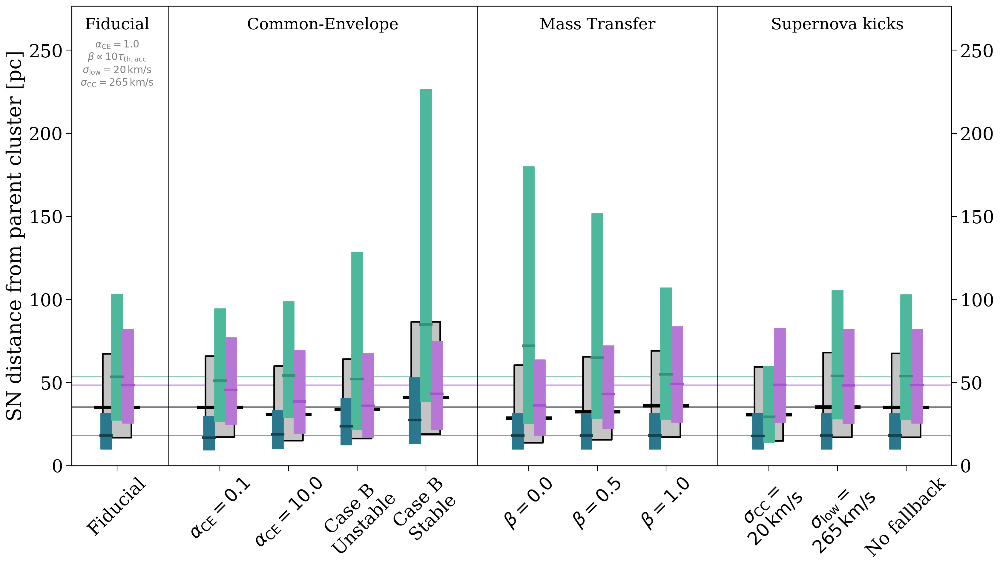

In [37]:
reload(plotting)
fig, ax = plotting.compare_variations(bin_pops, bin_pop_labels, quantity="time", annotate_loc=100,
                                      group_start_inds=[1,5,8],
                                    fiducial_settings=[r"$\alpha_{\rm CE} = 1.0$",
                                                       r"$\beta \propto 10 \tau_{\rm th, acc}$",
                                                       r"$\sigma_{\rm low} = 20 \, {\rm km/s}$",
                                                       r"$\sigma_{\rm CC} = 265 \, {\rm km/s}$"],
                                      show=False, show_labels=False, variable_widths="area")
# plt.savefig("../plots/variations/var-bin-time.pdf", format="pdf", bbox_inches="tight")
plt.show()

reload(plotting)
fig, ax = plotting.compare_variations(bin_pops, bin_pop_labels, quantity="distance", annotate_loc=270,
                                      group_start_inds=[1,5,8],
                                    fiducial_settings=[r"$\alpha_{\rm CE} = 1.0$",
                                                       r"$\beta \propto 10 \tau_{\rm th, acc}$",
                                                       r"$\sigma_{\rm low} = 20 \, {\rm km/s}$",
                                                       r"$\sigma_{\rm CC} = 265 \, {\rm km/s}$"],
                                      show=False, show_rel_bars=False, show_legend=False, variable_widths="are")
# plt.savefig("../plots/variations/var-bin-dist.pdf", format="pdf", bbox_inches="tight")
plt.show()

In [88]:
import matplotlib.colors as mcolors

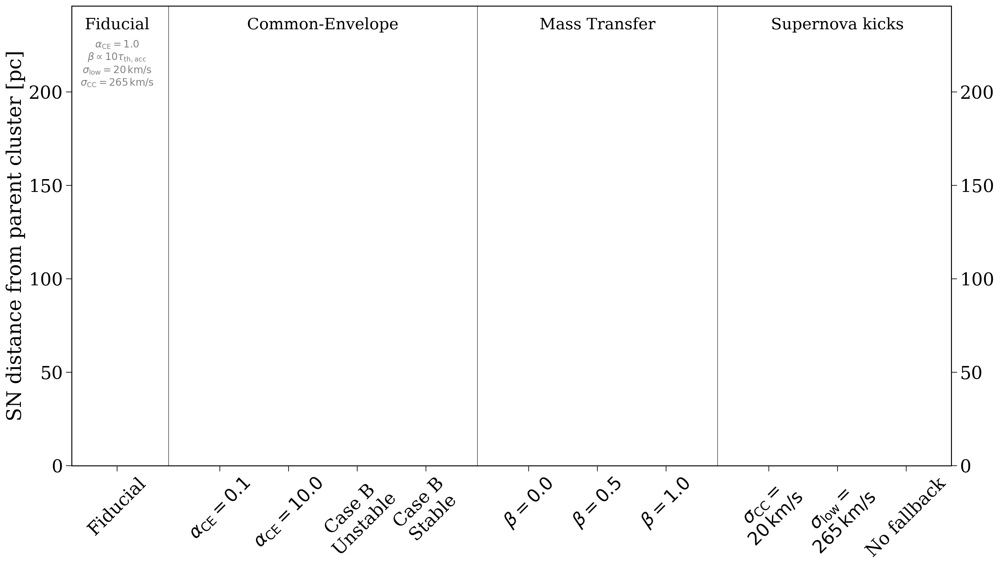

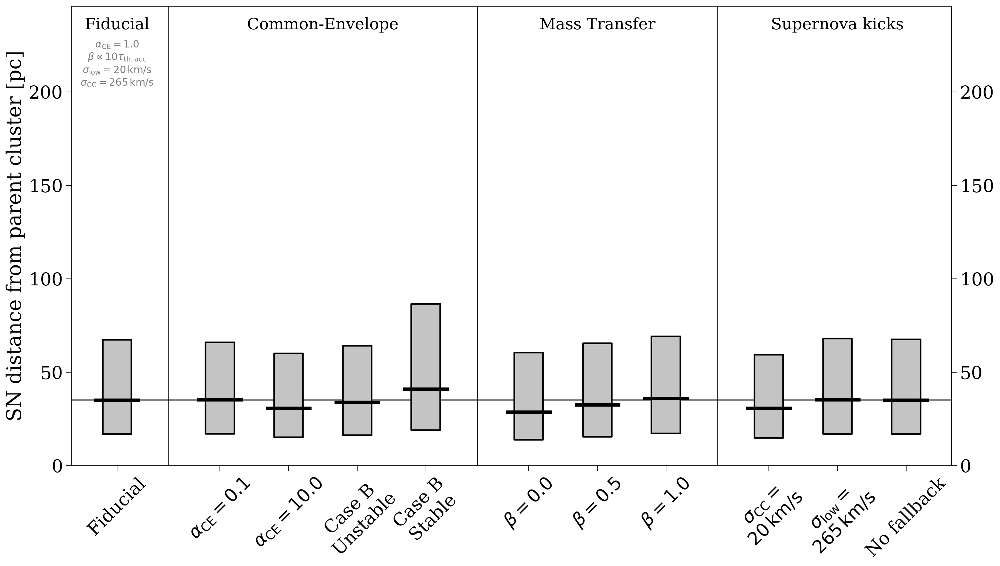

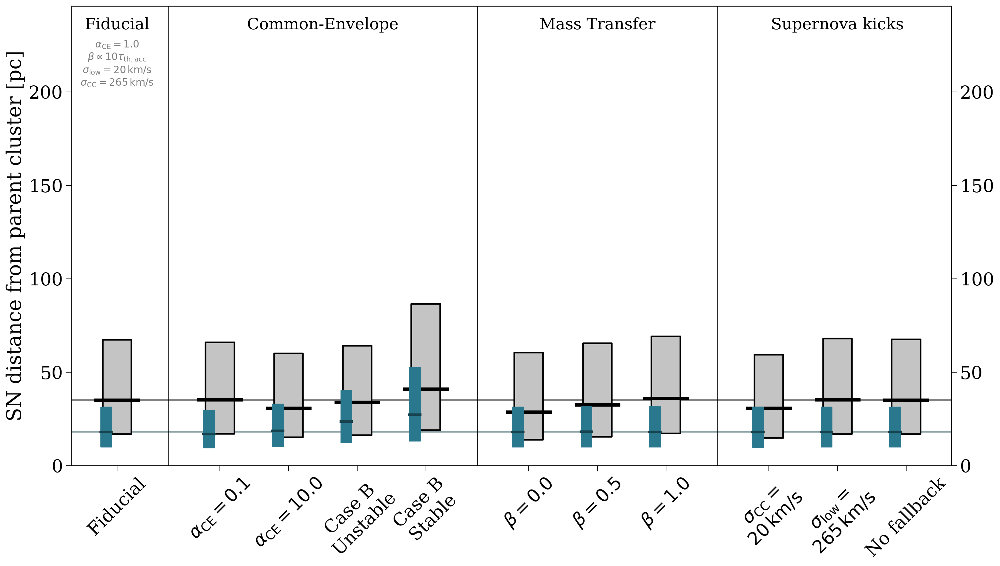

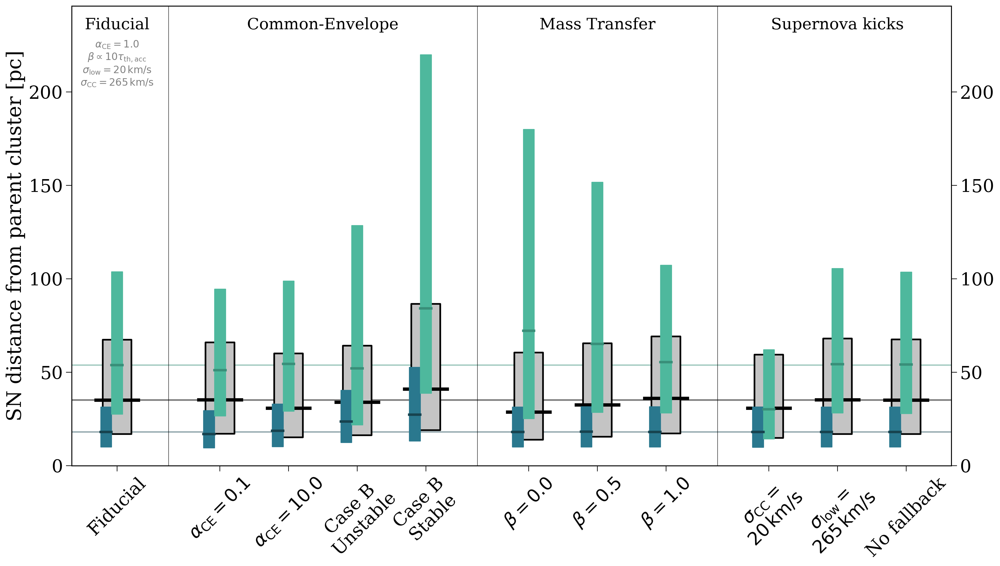

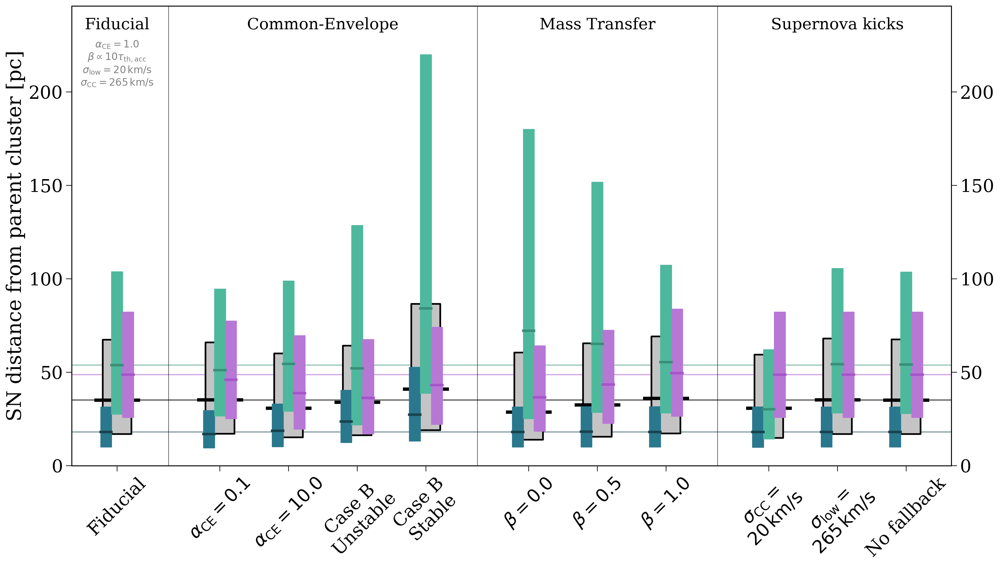

In [22]:
args = [
    {'combo': False, 'parts': [False, False, False]},
    {'combo': True, 'parts': [False, False, False]},
    {'combo': True, 'parts': [True, False, False]},
    {'combo': True, 'parts': [True, True, False]},
    {'combo': True, 'parts': [True, True, True]},
]

for i, arg in enumerate(args):
    fig, ax = plotting.compare_variations(bin_pops, bin_pop_labels, quantity="distance", annotate_loc=240,
                                          group_start_inds=[1,5,8],
                                        fiducial_settings=[r"$\alpha_{\rm CE} = 1.0$",
                                                           r"$\beta \propto 10 \tau_{\rm th, acc}$",
                                                           r"$\sigma_{\rm low} = 20 \, {\rm km/s}$",
                                                           r"$\sigma_{\rm CC} = 265 \, {\rm km/s}$"],
                                          show=False, show_rel_bars=False, show_legend=False,
                                          **arg)
    plt.savefig(f"../plots/var-bin-dist-part{i}.png", bbox_inches="tight")

## Merger products

In [217]:
fid_mergers = np.concatenate((pops["fiducial"].sn_1_merger[pops["fiducial"].sn_1_merger].index,
                              pops["fiducial"].sn_2_merger[pops["fiducial"].sn_2_merger].index))

In [219]:
bet_mergers = np.concatenate((pops["beta-0.0"].sn_1_merger[pops["beta-0.0"].sn_1_merger].index,
                              pops["beta-0.0"].sn_2_merger[pops["beta-0.0"].sn_2_merger].index))

In [227]:
pops["fiducial"].bpp.loc[7886]

,tphys,mass_1,mass_2,kstar_1,kstar_2,sep,porb,ecc,RRLO_1,RRLO_2,evol_type,aj_1,aj_2,tms_1,tms_2,massc_1,massc_2,rad_1,rad_2,mass0_1,mass0_2,lum_1,lum_2,teff_1,teff_2,radc_1,radc_2,menv_1,menv_2,renv_1,renv_2,omega_spin_1,omega_spin_2,B_1,B_2,bacc_1,bacc_2,tacc_1,tacc_2,epoch_1,epoch_2,bhspin_1,bhspin_2,bin_num
7886,0.000000,118.740425,83.383153,1.0,1.0,121.358325,10.898533,0.278349,5.499982e-01,0.505429,1.0,0.000000,0.000000,3.243740e+00,3.478185e+00,0.000000,0.000000,19.742028,15.437802,118.740425,83.383153,1.700492e+06,9.333771e+05,47121.311349,45866.030268,0.000000,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,4.986492e+02,6.457078e+02,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,7886
7886,3.012812,77.394020,63.022682,1.0,1.0,144.894973,17.058575,0.000000,1.000281e+00,0.682624,3.0,3.170209,3.160995,3.546448e+00,3.782246e+00,0.000000,0.000000,57.514021,35.733821,77.394020,63.022682,1.633653e+06,1.051868e+06,27332.081555,31061.343402,0.000000,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1.345289e+02,1.345289e+02,0.0,0.0,0.0,0.0,0.0,0.0,-0.157397,-0.148183,0.0,0.0,7886
7886,3.391660,72.245858,63.489252,2.0,1.0,143.791129,17.152373,0.000000,1.405038e+00,0.902705,2.0,3.617046,3.407612,3.617046e+00,3.772372e+00,31.108809,0.000000,78.823838,47.739548,72.245858,63.489252,1.703362e+06,1.139692e+06,23592.150816,27417.468894,1.870914,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,2.343017e+02,1.339515e+02,0.0,0.0,0.0,0.0,0.0,0.0,-0.225386,-0.015952,0.0,0.0,7886
7886,3.395166,69.619274,66.076395,4.0,1.0,144.049422,17.201109,0.000000,5.442081e+01,0.789052,2.0,3.620552,3.232339,3.617046e+00,3.720889e+00,31.732627,0.000000,3005.976753,42.556105,72.245858,66.076395,1.593178e+06,1.187087e+06,3757.014451,29336.568690,1.893560,0.000000,2.107938e+01,1.000000e-10,2.594507e+03,1.000000e-10,7.857043e+01,2.684893e+02,0.0,0.0,0.0,0.0,0.0,0.0,-0.225386,0.162828,0.0,0.0,7886
7886,3.402364,32.011572,103.520018,4.0,1.0,244.061689,37.957824,0.000000,8.266488e-01,0.267554,4.0,3.627750,1.845725,3.617046e+00,3.319809e+00,31.858327,0.000000,57.157495,31.520592,72.245858,103.520018,1.570040e+06,1.976292e+06,27146.304586,38719.985898,1.900504,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,2.786775e+01,1.135742e+03,0.0,0.0,0.0,0.0,0.0,0.0,-0.225386,1.556639,0.0,0.0,7886
7886,3.407350,31.945259,103.461485,7.0,1.0,244.120153,37.988965,0.000000,2.756007e-02,0.267850,2.0,0.010350,1.850905,3.311089e-01,3.320157e+00,0.000000,0.000000,1.905297,31.571632,31.945259,103.461485,1.009306e+06,1.977010e+06,133135.534461,38692.188830,0.000000,0.000000,3.194526e+01,1.000000e-10,1.905297e+00,1.000000e-10,1.972409e-02,1.122678e+03,0.0,0.0,0.0,0.0,0.0,0.0,3.397000,1.556445,0.0,0.0,7886
7886,3.833955,12.303358,95.154838,8.0,1.0,308.357260,60.538779,0.000000,1.549446e-02,0.210114,2.0,0.563706,2.311813,5.637060e-01,3.375231e+00,8.703957,0.000000,1.063930,36.117522,12.303358,95.154838,2.997398e+05,1.923774e+06,131522.231120,35929.330811,0.000070,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1.933254e+00,4.379662e+02,0.0,0.0,0.0,0.0,0.0,0.0,3.270249,1.522142,0.0,0.0,7886
7886,3.850737,11.951413,94.842851,8.0,1.0,310.276861,61.294609,0.000000,1.549446e-02,0.210114,15.0,0.580230,2.329901,5.637060e-01,3.377506e+00,9.152522,0.000000,1.127218,36.360170,12.303358,94.842851,3.853582e+05,1.921878e+06,136060.427604,35800.418966,0.000070,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1.665509e+08,4.211888e+02,0.0,0.0,0.0,0.0,0.0,0.0,3.270249,1.520554,0.0,0.0,7886
7886,3.850737,9.041041,94.842851,14.0,1.0,314.154503,63.315930,0.041608,6.243954e-07,0.207542,2.0,0.000000,2.330183,5.637060e-01,3.377542e+00,9.041041,0.000000,0.000038,36.364019,12.303358,94.842851,1.000000e-10,1.921849e+06,2961.266365,35798.388119,0.000038,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1.665509e+08,4.209311e+02,0.0,0.0,0.0,0.0,0.0,0.0,3.850737,1.520554,0.0,0.0,7886
7886,4.931062,9.041167,61.938721,14.0,2.0,459.

In [228]:
pops["beta-0.0"].bpp.loc[7886]

,tphys,mass_1,mass_2,kstar_1,kstar_2,sep,porb,ecc,RRLO_1,RRLO_2,evol_type,aj_1,aj_2,tms_1,tms_2,massc_1,massc_2,rad_1,rad_2,mass0_1,mass0_2,lum_1,lum_2,teff_1,teff_2,radc_1,radc_2,menv_1,menv_2,renv_1,renv_2,omega_spin_1,omega_spin_2,B_1,B_2,bacc_1,bacc_2,tacc_1,tacc_2,epoch_1,epoch_2,bhspin_1,bhspin_2,bin_num
7886,0.000000,118.740425,83.383153,1.0,1.0,121.358325,10.898533,0.278349,0.549998,0.505429,1.0,0.000000,0.000000,3.243740e+00,3.478185,0.000000,0.0,19.742028,15.437802,118.740425,83.383153,1.700492e+06,9.333771e+05,47121.311349,45866.030268,0.000000,0.0,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,4.986492e+02,645.707809,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,7886
7886,3.012812,77.394020,63.022682,1.0,1.0,144.894973,17.058575,0.000000,1.000281,0.682624,3.0,3.170209,3.160995,3.546448e+00,3.782246,0.000000,0.0,57.514021,35.733821,77.394020,63.022682,1.633653e+06,1.051868e+06,27332.081555,31061.343402,0.000000,0.0,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1.345289e+02,134.528856,0.0,0.0,0.0,0.0,0.0,0.0,-0.157397,-0.148183,0.0,0.0,7886
7886,3.369657,72.875182,61.401278,1.0,1.0,144.932652,17.451051,0.000000,1.941592,1.004288,5.0,3.585770,3.549310,3.607720e+00,3.818090,0.000000,0.0,110.825728,53.009017,72.875182,61.401278,1.637352e+06,1.098376e+06,19700.842859,25779.973121,0.000000,0.0,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1.294773e+02,129.967677,0.0,0.0,0.0,0.0,0.0,0.0,-0.216114,-0.179653,0.0,0.0,7886
7886,3.369657,134.276460,0.000000,1.0,15.0,0.000000,0.000000,-1.000000,0.000000,-1.000000,6.0,3.074834,3.549310,3.607720e+00,3.818090,0.000000,0.0,110.825728,53.009017,134.276460,61.401278,1.637352e+06,1.098376e+06,19700.842859,25779.973121,0.000000,0.0,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1.294773e+02,129.967677,0.0,0.0,0.0,0.0,0.0,0.0,0.294823,-0.179653,0.0,0.0,7886
7886,3.483881,117.142891,0.000000,2.0,15.0,0.000000,0.000000,-1.000000,0.000100,-1.000000,2.0,3.250554,3.549310,3.250554e+00,3.818090,59.754361,0.0,175.233074,53.009017,117.142891,61.401278,4.126072e+06,1.098376e+06,19739.937308,25779.973121,2.774761,0.0,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,5.084878e+00,129.967677,0.0,0.0,0.0,0.0,0.0,0.0,0.233326,-0.179653,0.0,0.0,7886
7886,3.486514,116.747957,0.000000,4.0,15.0,0.000000,0.000000,-1.000000,0.000100,-1.000000,2.0,3.253187,3.549310,3.250554e+00,3.818090,60.949287,0.0,4387.637770,53.009017,117.142891,61.401278,3.840055e+06,1.098376e+06,3874.704517,25779.973121,2.808070,0.0,2.567861e+01,1.000000e-10,3.611517e+03,1.000000e-10,5.884262e-03,129.967677,0.0,0.0,0.0,0.0,0.0,0.0,0.233326,-0.179653,0.0,0.0,7886
7886,3.793566,71.051489,0.000000,7.0,15.0,0.000000,0.000000,-1.000000,0.000100,-1.000000,2.0,0.191637,3.549310,2.202730e-01,3.818090,0.000000,0.0,3.079884,53.009017,71.051489,61.401278,4.174610e+06,1.098376e+06,149333.205030,25779.973121,0.000000,0.0,7.105149e+01,1.000000e-10,3.079884e+00,1.000000e-10,1.978321e-12,129.967677,0.0,0.0,0.0,0.0,0.0,0.0,3.601929,-0.179653,0.0,0.0,7886
7886,3.824941,50.204587,0.000000,7.0,15.0,0.000000,0.000000,-1.000000,0.000100,-1.000000,15.0,0.262572,3.549310,2.625720e-01,3.818090,0.000000,0.0,2.498201,53.009017,50.204587,61.401278,2.730027e+06,1.098376e+06,149106.859725,25779.973121,0.000000,0.0,5.020477e+01,1.000000e-10,2.498201e+00,1.000000e-10,3.005861e-04,129.967677,0.0,0.0,0.0,0.0,0.0,0.0,3.562368,-0.179653,0.0,0.0,7886
7886,3.824941,44.500000,0.000000,14.0,15.0,0.000000,0.000000,-1.000000,0.000100,-1.000000,2.0,0.000000,3.549310,2.625725e-01,3.818090,44.500000,0.0,0.000189,53.009017,50.204587,61.401278,1.000000e-10,1.098376e+06,1334.770738,25779.973121,0.000189,0.0,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,3.005861e-04,129.967677,0.0,0.0,0.0,0.0,0.0,0.0,3.824941,-0.179653,0.0,0.0,7886
7886,271.981427,44.500000,0.000000,14.0,15.0,0.000000,0.000000,-1.000000,0.000100,-1.000000,10.0,268.156486,3.549310,1.000000e+10,3.818090,44.500000,0.0,0.000189,53.009017,50.204587,61.401278,1.000000e-10,1.098376e+06,1334

In [222]:
bet_mergers[~np.isin(bet_mergers, fid_mergers)]

array([  6943,   7886,   7914,  12425,  20004,  23727,  34038,  38201,
        42821,  44799,  46146,  49349,  64285,  64324,  66049,  66077,
        68527,  71736,  73062,  73376,  81404,  83720,  88710,  91951,
        92368,  92761, 101678, 101691, 101939, 112123, 112144, 113874,
       115791, 118087, 119692, 120168, 124620, 124936, 129298, 129308,
       131833, 137873, 139663, 140572, 140889, 160256, 163031, 181488,
       184849, 187340, 191246, 199860, 200791, 207654, 210571, 211484,
       211518, 215327, 217536, 233031, 234491, 235434, 256403, 261861,
       262153, 263601, 263622, 279363, 282366, 288298, 290167, 309829,
       309855, 312399, 315651, 317698, 323926, 323958, 325511, 326505,
       326743, 328203, 330357, 332147, 332165, 338520, 339151, 341580,
       345282, 345785, 346336, 347103, 351436, 352194, 357941, 366542,
       366557, 369353, 375076, 376136, 377029, 378933, 381741, 384785,
       385470, 390548, 396838, 399401, 416868, 425322, 427101, 430518,
      

/tmp/ipykernel_2048269/1990248453.py:12: RuntimeWarning: invalid value encountered in divide
  plt.plot(bin_centres, counts / f_counts, label=p, marker="o")


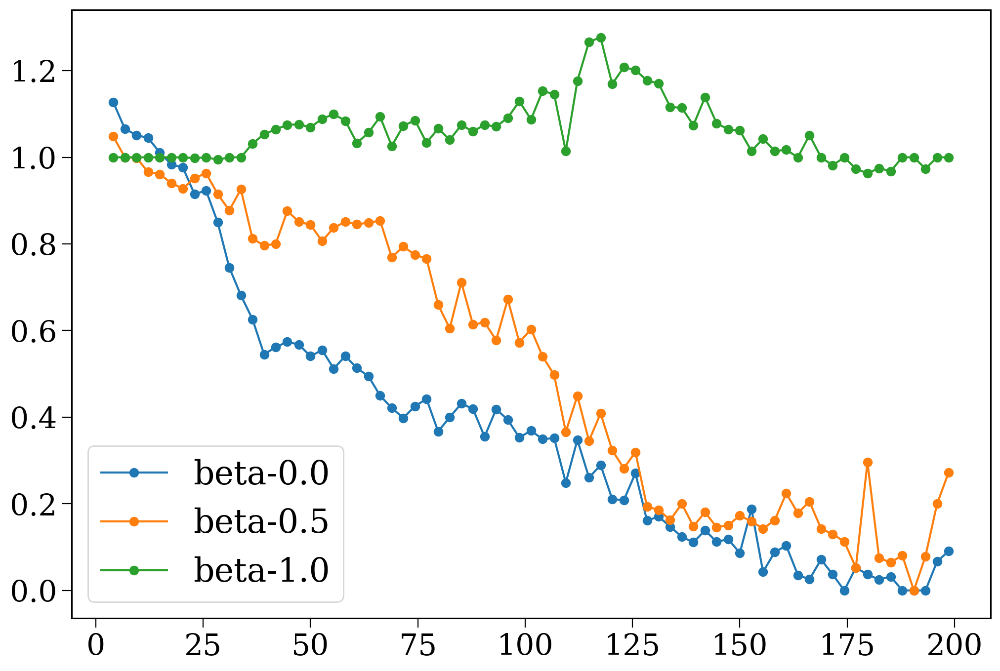

In [200]:
for p in ["fiducial", "beta-0.0", "beta-0.5", "beta-1.0"]:
    sn_time_1 = pops[p].bpp["tphys"][(pops[p].bpp["evol_type"] == 15) & (~pops[p].bpp["bin_num"].isin(pops[p].duplicate_sn))]
    sn_time_2 = pops[p].bpp["tphys"][(pops[p].bpp["evol_type"] == 16) & (~pops[p].bpp["bin_num"].isin(pops[p].duplicate_sn))]
    sn_merger_time = np.concatenate((sn_time_1[pops[p].sn_1_merger], sn_time_2[pops[p].sn_2_merger]))

    if p == "fiducial":
        f_counts, f_bins = np.histogram(sn_merger_time, bins=np.linspace(0, 200, 75))
    else:
        counts, bins = np.histogram(sn_merger_time, bins=np.linspace(0, 200, 75))
        bin_centres = np.array([(bins[i] + bins[i + 1]) / 2. for i in range(len(bins) - 1)])
        
        plt.plot(bin_centres, counts / f_counts, label=p, marker="o")

plt.legend()
plt.show()

## Detailed plots

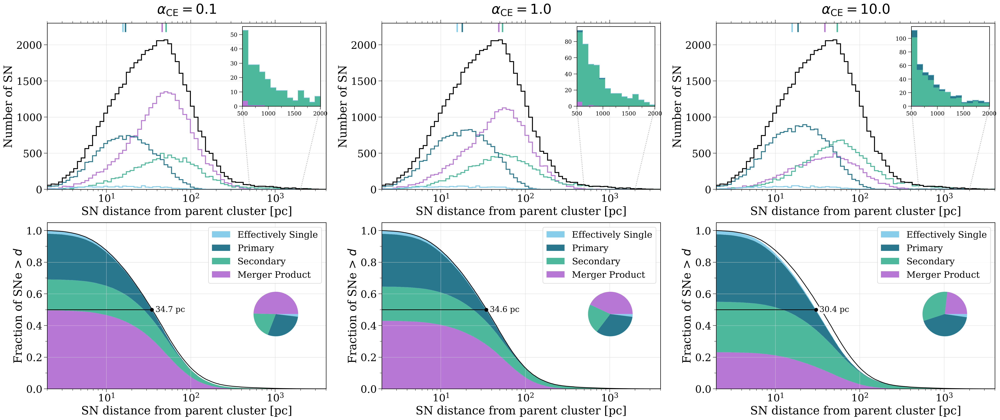

In [43]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["ce-0.1", "fiducial", "ce-10.0"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   [r"$\alpha_{\rm CE} = 0.1$", r"$\alpha_{\rm CE} = 1.0$", r"$\alpha_{\rm CE} = 10.0$"]):
    plotting.sandpile(pops[p], bins=np.geomspace(2e0, 4e3, 75),
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 2300)}, fig=fig, axes=x, show=False, stacked=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

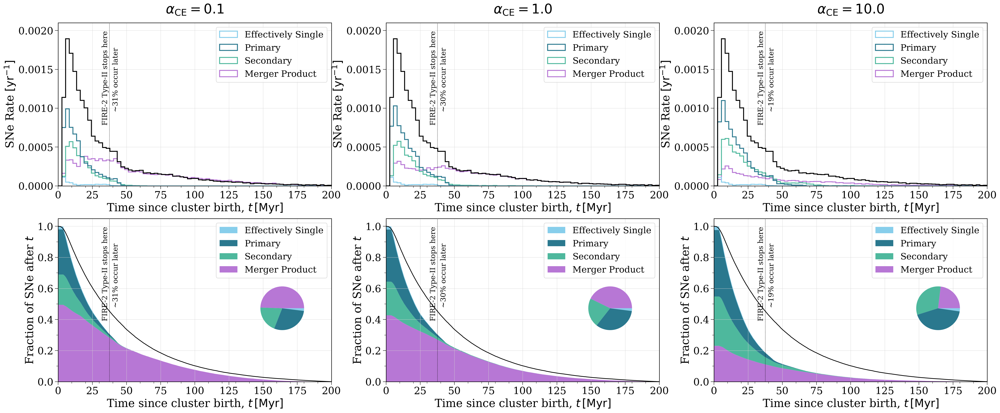

In [44]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["ce-0.1", "fiducial", "ce-10.0"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   [r"$\alpha_{\rm CE} = 0.1$", r"$\alpha_{\rm CE} = 1.0$", r"$\alpha_{\rm CE} = 10.0$"]):
    plotting.sandpile(pops[p], bins=np.linspace(0, 200, 75),var="time",
                      comparison_pop=pops["fiducial"], 
                      top_ax_dict={"ylim": (0, 0.0021)}, fig=fig, axes=x, show=False, stacked=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

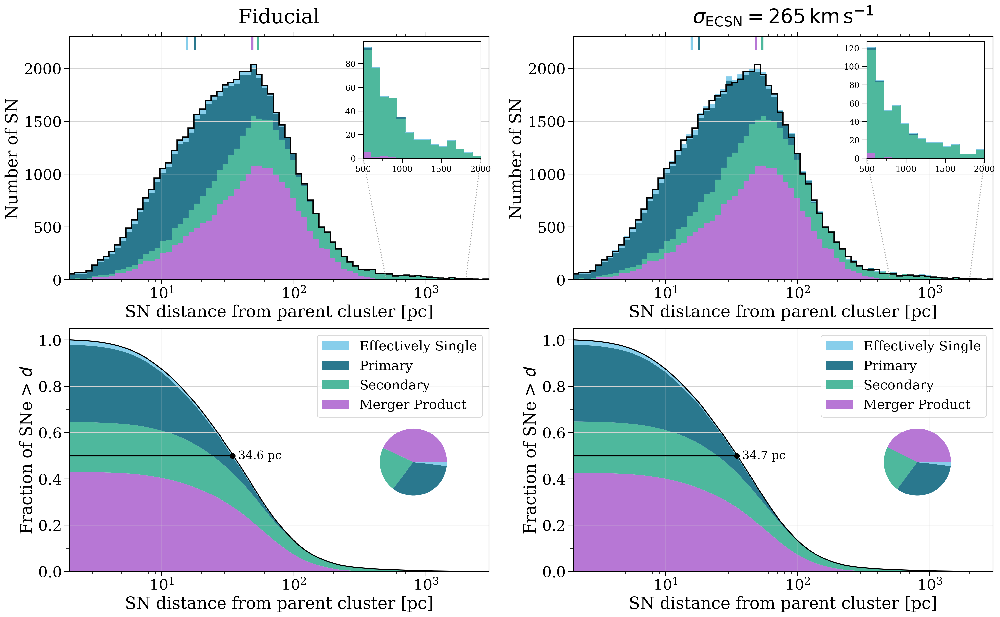

In [45]:
fig, axes = plt.subplots(2, 2, figsize=(24, 14))

for p, x, l in zip(["fiducial", "ecsn-265"],
                   [axes[:, 0], axes[:, 1]],
                   [r"Fiducial", r"$\sigma_{\rm ECSN} = 265 \, {\rm km \, s^{-1}}$"]):
    plotting.sandpile(pops[p], bins=np.geomspace(2e0, 3e3, 75),
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 2300)}, fig=fig, axes=x, show=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

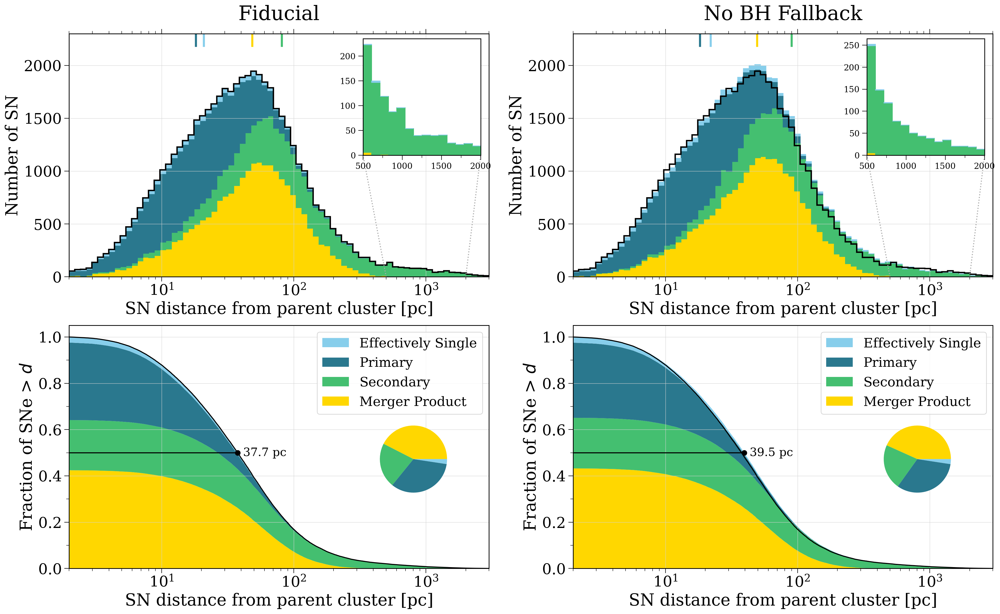

In [140]:
fig, axes = plt.subplots(2, 2, figsize=(24, 14))

for p, x, l in zip(["fiducial", "no-fallback"],
                   [axes[:, 0], axes[:, 1]],
                   [r"Fiducial", r"No BH Fallback"]):
    plotting.sandpile(pops[p], bins=np.geomspace(2e0, 3e3, 75),
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 2300)}, fig=fig, axes=x, show=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

## Understand CEs

In [47]:
for p in ["fiducial", "ce-0.1", "ce-10.0"]:
    ce_start_rows = pops[p].bpp[pops[p].bpp["evol_type"] == 7]
    two_ms = ce_start_rows[(ce_start_rows["kstar_1"] <= 1) & (ce_start_rows["kstar_2"] <= 1)]

    double_core = ce_start_rows[(ce_start_rows["kstar_1"] > 1) & (ce_start_rows["kstar_2"] > 1) & (ce_start_rows["kstar_1"] < 13) & (ce_start_rows["kstar_2"] < 13)]
    merger = (pops[p].final_bpp["sep"] == 0.0)# & pops[p].has_sn
    
    double_core_fail = np.isin(pops[p].bin_nums, double_core["bin_num"].unique()) & merger
    print((double_core_fail & pops[p].has_sn).sum() / double_core_fail.sum())
    
    # print(len(two_ms) / len(ce_start_rows))
    print(double_core_fail.sum() / len(ce_start_rows))
    print()

0.6800950912361861
0.341420611591278

0.7080185737057315
0.36095059412132585

0.8061127029608405
0.022368449163586643



In [396]:
for p in ["fiducial", "ce-0.1", "ce-10.0"]:
    ce_start_rows = pops[p].bpp[pops[p].bpp["evol_type"] == 7]
    ce_nums = ce_start_rows["bin_num"].unique()
    sn_nums = np.concatenate((pops[p].sn_1.index, pops[p].sn_2.index))
    print(np.isin(sn_nums, ce_nums).sum() / len(sn_nums))

0.3458157015052267
0.3596113127646703
0.2985878162918789


In [48]:
(ce_start_rows["kstar_1"] <= 2).sum()

4867

In [49]:
for p in ["fiducial", "ce-0.1", "ce-10.0"]:
    x = pops[p].sn_2[pops[p].sn_2].index.isin(pops[p].bin_nums[pops[p].had_ce]).sum() / pops[p].sn_2.sum()
    print(p, x)

AttributeError: 'Population' object has no attribute 'had_ce'

In [345]:
for p in ["ce-0.1", "fiducial", "ce-10.0"]:
    sn_times = np.concatenate(plotting.get_data_and_weights(pops[p], "time", [1])[0])
    f_late = (sn_times > 50).sum() / len(sn_times)
    print(f"{p}  \t{f_late * 100:1.1f}%")

ce-0.1  	21.8%
fiducial  	22.2%
ce-10.0  	11.5%


In [325]:
for p in ["fiducial", "ce-0.1", "ce-10.0"]:
    ce_sn = (pops[p].has_sn) & (pops[p].had_ce)
    ce_sn_merged = (pops[p].final_bpp["sep"] == 0.0) & ce_sn

    m1 = pops[p].initC["mass_1"].values

    for low, high in [(4, 7), (7, 15), (15, 1000)]:
        mask = (m1 >= low) & (m1 < high)
        print(pops[p].bin_nums[ce_sn & mask])
        print(p, low, high, (ce_sn_merged & mask).sum() / (ce_sn & mask).sum(), (ce_sn & mask).sum())
    
    print()

[   102    109    113 ... 776937 776938 776956]
fiducial 4 7 0.9414834140887067 5366
[    93     95    110 ... 776941 776947 776951]
fiducial 7 15 0.8279942868802285 9802
[   130    134    149 ... 776714 776944 776964]
fiducial 15 1000 0.7877571500250878 1993

[    98    102    109 ... 776938 776956 776957]
ce-0.1 4 7 0.9976521884957237 5963
[    95    110    111 ... 776941 776947 776951]
ce-0.1 7 15 0.9867045662937832 10906
[   130    134    149 ... 776714 776944 776964]
ce-0.1 15 1000 0.9497991967871486 1992

[   160    395    429 ... 776658 776923 776956]
ce-10.0 4 7 0.2572463768115942 1932
[    93     95    110 ... 776910 776912 776947]
ce-10.0 7 15 0.1712707182320442 8326
[   130    134    149 ... 776714 776944 776964]
ce-10.0 15 1000 0.24435524335173106 1993



In [347]:
for p in ["ce-0.1", "fiducial", "ce-10.0"]:
    times = plotting.get_data_and_weights(pops[p], "time", [1])[0]
    print(len(times[0]) / 22345, len(times[0]) / len(np.concatenate(times)))

1.1782949205638846 0.49925100024650626
1.0 0.4369292739680491
0.4792123517565451 0.24139408011902883


In [355]:
for p in ["ce-0.1", "fiducial", "ce-10.0"]:
    times = plotting.get_data_and_weights(pops[p], "time", [1])[0]
    print(len(times[1]) / 10871, len(times[1]) / len(np.concatenate(times)))

0.9444393340079109 0.19468304985114815
1.0 0.21256917150622787
1.2755036335203753 0.31258594648211185


In [353]:
for p in ["ce-0.1", "fiducial", "ce-10.0"]:
    times = plotting.get_data_and_weights(pops[p], "time", [1])[0]
    print(len(times[2]) / 16898, len(times[2]) / len(np.concatenate(times)))

0.8944253757841165 0.286591956311508
1.0 0.3304198197141237
1.1100721978932417 0.4228679636601366


## MT Stability

### Times

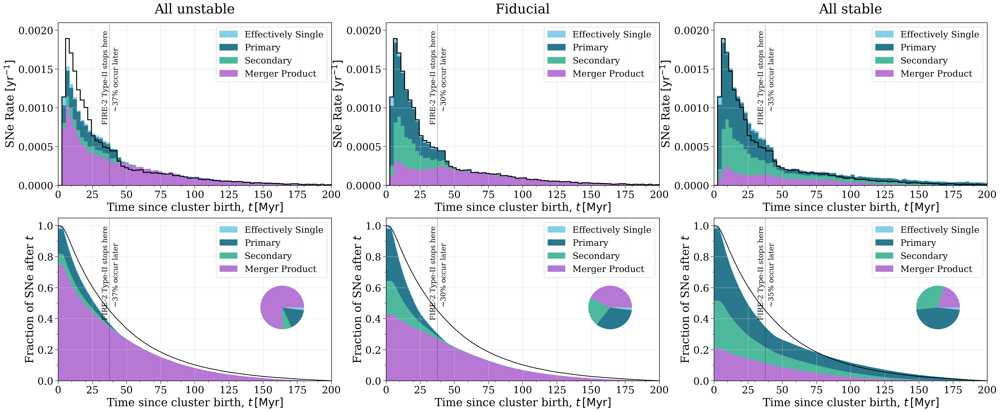

In [156]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["qcritB-0.0", "fiducial", "qcritB-1000.0"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   [r"All unstable", r"Fiducial", r"All stable"]):
    plotting.sandpile(pops[p], bins=np.linspace(0, 200, 75),var="time",
                      comparison_pop=pops["fiducial"], 
                      top_ax_dict={"ylim": (0, 0.0021)}, fig=fig, axes=x, show=False, stacked=True)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

In [96]:
sn_times = plotting.get_data_and_weights(pops["qcritB-1000.0"], "time", [1])[0]

In [97]:
no_ce_mergers = np.concatenate((pops["qcritB-1000.0"].sn_1_merger[pops["qcritB-1000.0"].sn_1_merger].index,
                                pops["qcritB-1000.0"].sn_2_merger[pops["qcritB-1000.0"].sn_2_merger].index))
print(len(no_ce_mergers))
pops["qcritB-1000.0"].bpp.loc[no_ce_mergers][pops["qcritB-1000.0"].bpp.loc[no_ce_mergers]["evol_type"] == 5]

12207


,tphys,mass_1,mass_2,kstar_1,kstar_2,sep,porb,ecc,RRLO_1,RRLO_2,evol_type,aj_1,aj_2,tms_1,tms_2,massc_1,massc_2,rad_1,rad_2,mass0_1,mass0_2,lum_1,lum_2,teff_1,teff_2,radc_1,radc_2,menv_1,menv_2,renv_1,renv_2,omega_spin_1,omega_spin_2,B_1,B_2,bacc_1,bacc_2,tacc_1,tacc_2,epoch_1,epoch_2,bhspin_1,bhspin_2,bin_num
100,2.798848,34.790389,31.969266,1,1,32.897858,2.676496,0.0,1.064221,1.000782,5,2.856468,2.845335,5.029124,5.345285,0.000000,0.000000,13.523290,12.235162,34.790389,31.969266,255374.034525,205521.692624,35442.357899,35292.235747,0.000000,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,856.558727,855.362990,0.0,0.0,0.0,0.0,0.0,0.0,-0.057620,-0.046487,0.0,0.0,100
149,10.398373,12.317870,2.551893,2,1,7.410405,0.606294,0.0,75.693357,1.003441,5,10.888908,9.208109,10.873964,606.032163,4.201158,0.000000,290.397604,1.890255,16.232483,2.551893,80452.562466,40.812753,5730.045450,10658.801602,0.544704,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,2409.667291,5565.946576,0.0,0.0,0.0,0.0,0.0,0.0,-0.490535,1.190264,0.0,0.0,149
414,16.067168,8.219955,1.958232,2,1,6.121541,0.550209,0.0,94.174672,1.009937,5,16.886806,14.434621,16.850517,1270.295459,2.887303,0.000000,291.479438,1.632886,12.247431,1.958232,17847.215541,14.038496,3925.168153,8782.575052,0.427689,0.000000,1.671756e-01,1.000000e-10,9.466698e+01,1.000000e-10,78.521717,4768.415025,0.0,0.0,0.0,0.0,0.0,0.0,-0.819638,1.632547,0.0,0.0,414
441,78.604939,3.538270,7.777288,1,1,16.049254,2.215218,0.0,1.115387,1.000684,5,237.809906,34.397076,248.182104,38.996769,0.000000,0.000000,5.606940,7.201622,3.538270,7.777288,284.239560,5263.364653,10053.742737,18402.224641,0.000000,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1006.873786,1037.454630,0.0,0.0,0.0,0.0,0.0,0.0,-159.204967,44.207863,0.0,0.0,441
2554,25.598489,5.080085,2.675883,2,1,5.989642,0.610036,0.0,24.181529,1.000430,5,26.949759,18.130721,26.907367,528.766017,2.007432,0.000000,63.057944,1.947504,9.358164,2.675883,9705.871832,49.911798,7247.001407,11042.850711,0.335968,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,376.769706,11016.899060,0.0,0.0,0.0,0.0,0.0,0.0,-1.351270,7.467768,0.0,0.0,2554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
776696,93.652600,1.371528,5.702801,6,2,33.772203,8.552018,0.0,1.094241,1.363345,5,43.864608,76.850986,38.801818,76.701648,1.358705,1.020587,9.785755,23.241665,7.769659,5.702801,29633.321134,1774.860161,24317.421698,7805.972717,0.016007,0.207810,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,263.630433,261.042174,0.0,0.0,0.0,0.0,0.0,0.0,49.787992,16.801614,0.0,0.0,776696
776893,53.124654,1.065762,10.181023,6,2,138.473391,56.312844,0.0,1.096019,1.610845,5,87.760019,22.668513,76.281136,22.621591,1.053880,2.242824,31.801628,128.155743,5.715466,10.181023,20296.197128,10657.001696,12271.526870,5203.665037,0.037230,0.361963,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,42.966922,40.484846,0.0,0.0,0.0,0.0,0.0,0.0,-34.635365,30.456141,0.0,0.0,776893
776910,49.607376,1.080622,11.658589,6,2,219.828887,105.834686,0.0,1.005141,1.697921,5,84.092130,17.819274,73.193230,17.781255,1.067956,2.698302,44.688042,218.030951,5.817446,11.658589,21013.759992,15098.414440,10442.389549,4352.546020,0.036419,0.409131,1.000000e-10,1.726745e-02,1.000000e-10,3.524519e+01,46.983772,21.548437,0.0,0.0,0.0,0.0,0.0,0.0,-34.484754,31.788102,0.0,0.0,776910
776937,103.498976,0.846991,8.301353,6,2,102.172924,39.573518,0.0,1.195800,1.472480,5,217.283101,33.696529,181.229891,33.619122,0.837640,1.701806,25.411250,86.744515,4.021184,8.301353,12979.987924,5559.041804,12276.517047,5375.248977,0.049404,0.300143,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,56.446067,57.577386,0.0,0.0,0.0,0.0,0.0,0.0,-113.784125,69.802447,0.0,0.0,776937


In [474]:
no_ce_mergers = np.concatenate((pops["fiducial"].sn_1_merger[pops["fiducial"].sn_1_merger].index,
                                pops["fiducial"].sn_2_merger[pops["fiducial"].sn_2_merger].index))
print(len(no_ce_mergers))
pops["fiducial"].bpp.loc[no_ce_mergers][pops["fiducial"].bpp.loc[no_ce_mergers]["evol_type"] == 5]

21970


,tphys,mass_1,mass_2,kstar_1,kstar_2,sep,porb,ecc,RRLO_1,RRLO_2,evol_type,aj_1,aj_2,tms_1,tms_2,massc_1,massc_2,rad_1,rad_2,mass0_1,mass0_2,lum_1,lum_2,teff_1,teff_2,radc_1,radc_2,menv_1,menv_2,renv_1,renv_2,omega_spin_1,omega_spin_2,B_1,B_2,bacc_1,bacc_2,tacc_1,tacc_2,epoch_1,epoch_2,bhspin_1,bhspin_2,bin_num
100,2.798848,34.790389,31.969266,1.0,1.0,32.897858,2.676496,0.0,1.064221,1.000782,5.0,2.856468,2.845335,5.029124,5.345285,0.000000,0.000000,13.523290,12.235162,34.790389,31.969266,255374.034525,205521.692624,35442.357899,35292.235747,0.000000,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,856.558727,855.362990,0.0,0.0,0.0,0.0,0.0,0.0,-0.057620,-0.046487,0.0,0.0,100
394,217.219934,0.658825,1.288915,7.0,7.0,0.554743,0.034312,0.0,1.000899,1.203055,5.0,34.499668,5.935368,61.894149,11.684526,0.000000,0.000000,0.179104,0.292343,0.658825,1.288915,81.151439,833.228215,41118.847280,57612.189909,0.000000,0.000000,6.588247e-01,1.288915e+00,1.791041e-01,2.923428e-01,67238.632949,65463.877138,0.0,0.0,0.0,0.0,0.0,0.0,182.720267,211.284566,0.0,0.0,394
441,78.604939,3.538270,7.777288,1.0,1.0,16.049254,2.215218,0.0,1.115387,1.000684,5.0,237.809906,34.397076,248.182104,38.996769,0.000000,0.000000,5.606940,7.201622,3.538270,7.777288,284.239560,5263.364653,10053.742737,18402.224641,0.000000,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1006.873786,1037.454630,0.0,0.0,0.0,0.0,0.0,0.0,-159.204967,44.207863,0.0,0.0,441
2533,187.135200,0.686155,1.426490,7.0,7.0,0.574560,0.034727,0.0,1.000050,1.123360,5.0,27.591906,2.006460,55.245086,9.332067,0.000000,0.000000,0.182531,0.286221,0.686155,1.426490,89.894483,925.123204,41786.379914,59767.995616,0.000000,0.000000,6.861553e-01,1.426490e+00,1.825308e-01,2.862211e-01,63920.272408,65764.086588,0.0,0.0,0.0,0.0,0.0,0.0,159.543294,185.128740,0.0,0.0,2533
2563,3.332544,51.644058,44.084751,1.0,1.0,62.071130,5.792757,0.0,1.392990,1.001525,5.0,3.522222,3.434507,4.048865,4.372701,0.000000,0.000000,33.954121,22.709366,51.644058,44.084751,746491.552347,505312.097724,29246.883135,32438.220935,0.000000,0.000000,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,394.097661,395.955980,0.0,0.0,0.0,0.0,0.0,0.0,-0.189678,-0.101963,0.0,0.0,2563
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
686059,159.009229,0.842074,1.368717,8.0,8.0,1.164384,0.097936,0.0,1.006945,2.412529,5.0,41.235667,9.803071,37.320782,9.161862,0.586694,0.782536,0.395987,1.184228,0.794757,1.438572,3296.996939,5948.627759,69816.570331,46790.343661,0.064799,0.052566,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,70788.352363,11993.079856,0.0,0.0,0.0,0.0,0.0,0.0,117.773562,149.206157,0.0,0.0,686059
702652,120.552753,1.364554,4.855766,6.0,2.0,23.304688,5.227942,0.0,1.078276,1.319243,5.0,44.307484,112.728564,39.176743,112.531239,1.352252,0.819812,6.939794,15.099916,7.730084,4.855766,29208.937994,1023.910405,28772.345134,8440.104834,0.016651,0.175108,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,472.385606,421.449066,0.0,0.0,0.0,0.0,0.0,0.0,76.245270,7.824189,0.0,0.0,702652
712781,128.879534,0.928701,1.602679,7.0,8.0,0.694095,0.042123,0.0,1.000765,1.990070,5.0,21.309433,6.941419,25.221373,6.631313,0.000000,0.840396,0.231171,0.589653,0.928701,1.674410,368.495012,5563.453744,52833.638081,65209.016914,0.000000,0.049248,9.287011e-01,1.000000e-10,2.311713e-01,1.000000e-10,66578.300727,36983.376757,0.0,0.0,0.0,0.0,0.0,0.0,107.570100,121.938114,0.0,0.0,712781
724154,126.692099,1.347623,4.719490,6.0,2.0,23.788641,5.459283,0.0,1.145764,1.321394,5.0,44.508272,121.772055,39.283114,121.557094,1.335460,0.788758,7.559553,15.394409,7.665355,4.719490,28960.904045,893.262780,27508.986660,8078.540461,0.018231,0.169672,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,427.178074,402.371517,0.0,0.0,0.0,0.0,0.0,0.0,82.183827,4.920045,0.0,0.0,724154


In [117]:
def get_mt_1_type(p):
    mt_1_type = pd.Series(np.zeros(len(p)), index=p.bin_nums)
    print(p)

    kstar_mt_1 = p.bpp[(p.bpp["evol_type"] == 3) & (p.bpp["RRLO_1"] >= 1)].drop_duplicates(subset="bin_num", keep="first")["kstar_1"]
    
    for low, high, t in [(-np.inf, 1, 1), (1, 4, 2), (4, 6, 3)]:
        mt_1_type.loc[kstar_mt_1[(kstar_mt_1 > low) & (kstar_mt_1 <= high)].index] = t
    return mt_1_type

In [127]:
pops[p].had_sn.sum()

45537

In [154]:
for p in ["qcritB-0.0", "fiducial", "qcritB-1000.0"]:
    print(pops[p].had_sn.sum())

45537
40513
43567


In [383]:
sn_nums = np.unique(np.concatenate((pops["fiducial"].sn_1.index, pops["fiducial"].sn_2.index)))
mt_nums = pops["fiducial"].bpp[pops["fiducial"].bpp["evol_type"] == 3]["bin_num"].unique()

In [384]:
np.isin(sn_nums, mt_nums).sum() / len(sn_nums)

0.8451361291437316

In [385]:
caseB_nums = pops["fiducial"].bpp[((pops["fiducial"].bpp["evol_type"] == 3) & (pops["fiducial"].bpp["RRLO_1"] >= 1) & (pops["fiducial"].bpp["kstar_1"].isin([2,3,4]))) |
                                  ((pops["fiducial"].bpp["evol_type"] == 3) & (pops["fiducial"].bpp["RRLO_2"] >= 1) & (pops["fiducial"].bpp["kstar_2"].isin([2,3,4])))]["bin_num"].unique()

In [386]:
np.isin(mt_nums, caseB_nums).sum() / len(mt_nums)

0.6582923345500714

In [394]:
for p in ["qcritB-0.0", "fiducial", "qcritB-1000.0"]:
    print((pops[p].sn_1_merger.sum() + pops[p].sn_2_merger.sum()) / (len(pops[p].sn_1) + len(pops[p].sn_2)))

0.7469000729394603
0.4317624099086043
0.20910610264648136


In [392]:
for p in ["qcritB-0.0", "fiducial", "qcritB-1000.0"]:
    sn_demographics(pops[p], show=True, norm=True)

qcritB-0.0
  SN S: 1.0
  SN 1: 0.4610013019292224
  SN 2: 0.3144144972863582
  SN M: 1.6497650481091968
  TOT : 3.4251808473247776
fiducial
  SN S: 1.0
  SN 1: 1.0
  SN 2: 1.0
  SN M: 1.0
  TOT : 4.0
qcritB-1000.0
  SN S: 1.0
  SN 1: 1.6584211149248431
  SN 2: 1.626805261705455
  SN M: 0.5767285746251958
  TOT : 4.861954951255494


In [151]:
for p in ["qcritB-0.0", "fiducial", "qcritB-1000.0"]:
    x = get_mt_1_type(bin_pops[p])[pops[p].had_sn]
    # x = x[x > 0]
    print(x.value_counts() / len(x), len(x))

<Population - 75971 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
2.0    0.481542
1.0    0.337572
0.0    0.137888
3.0    0.042998
Name: count, dtype: float64 45537
<Population - 75942 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
2.0    0.425666
1.0    0.371683
0.0    0.154987
3.0    0.047664
Name: count, dtype: float64 40513
<Population - 75970 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
2.0    0.446554
1.0    0.366585
0.0    0.144123
3.0    0.042739
Name: count, dtype: float64 43567


In [132]:
for p in ["qcritB-0.0", "fiducial", "qcritB-1000.0"]:
    sn_1_mask = np.isin(pops[p].bin_nums, pops[p].sn_1[pops[p].sn_1].index)
    x = get_mt_1_type(bin_pops[p])[sn_1_mask]
    # x = x[x > 0]
    print(x.value_counts() / len(x))

<Population - 75971 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
0.0    0.715395
2.0    0.142493
3.0    0.142111
Name: count, dtype: float64
<Population - 75942 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
2.0    0.513615
0.0    0.328269
1.0    0.092906
3.0    0.065210
Name: count, dtype: float64
<Population - 75970 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
2.0    0.531313
1.0    0.230184
0.0    0.198888
3.0    0.039615
Name: count, dtype: float64


In [134]:
for p in ["qcritB-0.0", "fiducial", "qcritB-1000.0"]:
    sn_2_mask = np.isin(pops[p].bin_nums, pops[p].sn_2[pops[p].sn_2].index)
    x = get_mt_1_type(bin_pops[p])[sn_2_mask]
    # x = x[x > 0]
    print(x.value_counts() / len(x))

<Population - 75971 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
0.0    0.733762
2.0    0.167349
3.0    0.098888
Name: count, dtype: float64
<Population - 75942 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
2.0    0.637494
0.0    0.227690
1.0    0.104040
3.0    0.030776
Name: count, dtype: float64
<Population - 75970 systems - galactic_potential=CompositePotential, SFH=StarFormationHistory>
2.0    0.586958
1.0    0.256105
0.0    0.138250
3.0    0.018687
Name: count, dtype: float64


### Secondary distances

Qcrit variations show higher secondary distances - why?

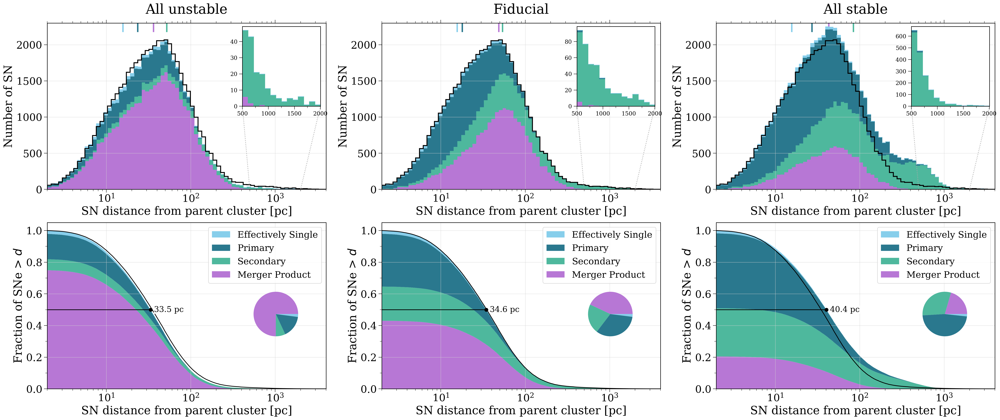

In [98]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["qcritB-0.0", "fiducial", "qcritB-1000.0"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   [r"All unstable", r"Fiducial", r"All stable"]):
    plotting.sandpile(pops[p], bins=np.geomspace(2e0, 4e3, 75),
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 2300)}, fig=fig, axes=x, show=False, stacked=True)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

#### Always unstable

This seems to preferentially eliminate short distances but not change the overall distribution. It also retains only those at large initial periods.
Still confused here.

In [99]:
bn_s, d_s = [], []
for p in ["fiducial", "qcritB-0.0"]:
    bn_s.append(pops[p].sn_2[pops[p].sn_2].index)
    d_s.append(pops[p].secondary_sn_distances[pops[p].sn_2])

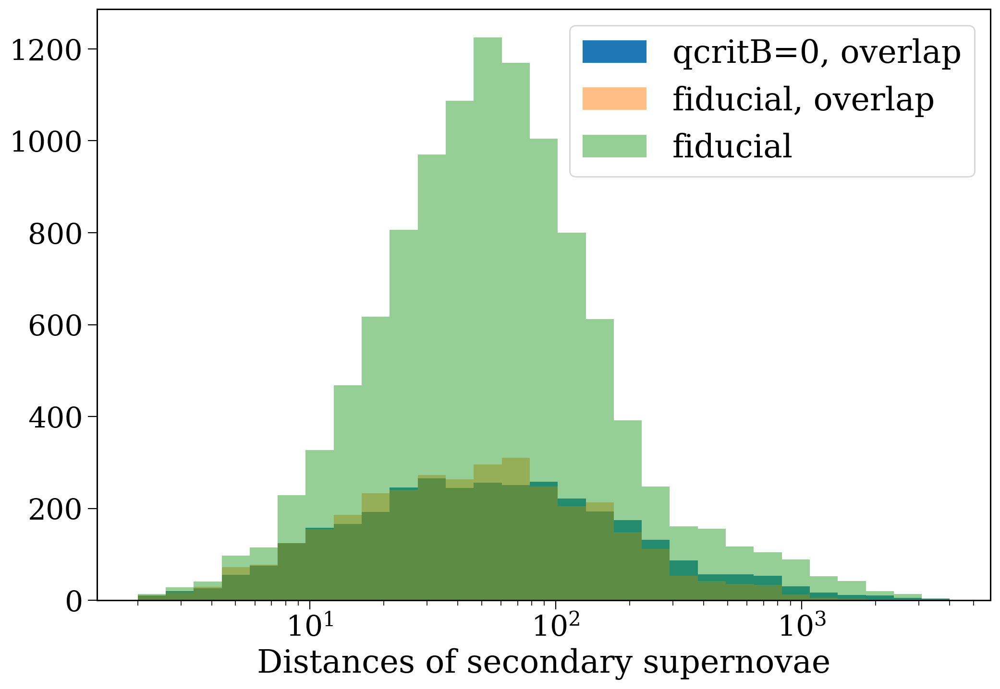

In [102]:
plt.hist(d_s[1][bn_s[1].isin(bn_s[0])].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), label="qcritB=0, overlap")
plt.hist(d_s[0][bn_s[0].isin(bn_s[1])].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), alpha=0.5, label="fiducial, overlap")
plt.hist(d_s[0].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), alpha=0.5, label="fiducial")

plt.legend()

plt.xlabel("Distances of secondary supernovae")

plt.xscale("log")
plt.show()

Check disruptions, perhaps those things are not getting kicked out

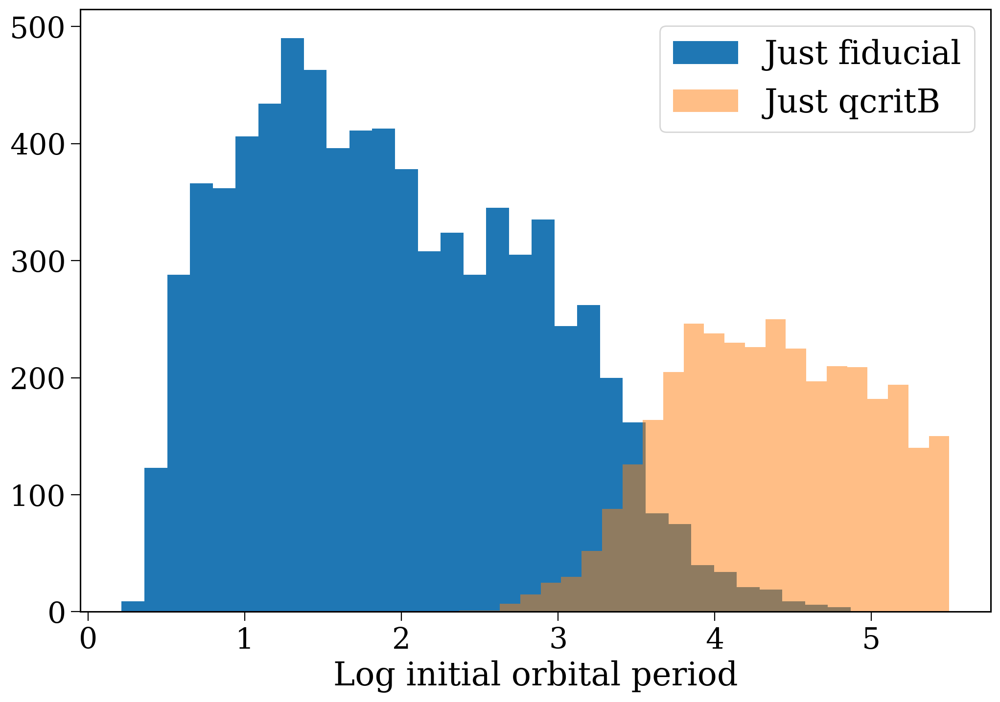

In [103]:
plt.hist(np.log10(pops["fiducial"].initC["porb"].loc[bn_s[0][~bn_s[0].isin(bn_s[1])]]), bins="fd", label="Just fiducial")
plt.hist(np.log10(pops["fiducial"].initC["porb"].loc[bn_s[0][bn_s[0].isin(bn_s[1])]]), bins="fd", alpha=0.5, label="Just qcritB")

plt.xlabel("Log initial orbital period")

plt.legend()
plt.show()

#### Always stable

In [104]:
bn_s, d_s = [], []
for p in ["fiducial", "qcritB-1000.0"]:
    bn_s.append(pops[p].sn_2[pops[p].sn_2].index)
    d_s.append(pops[p].secondary_sn_distances[pops[p].sn_2])

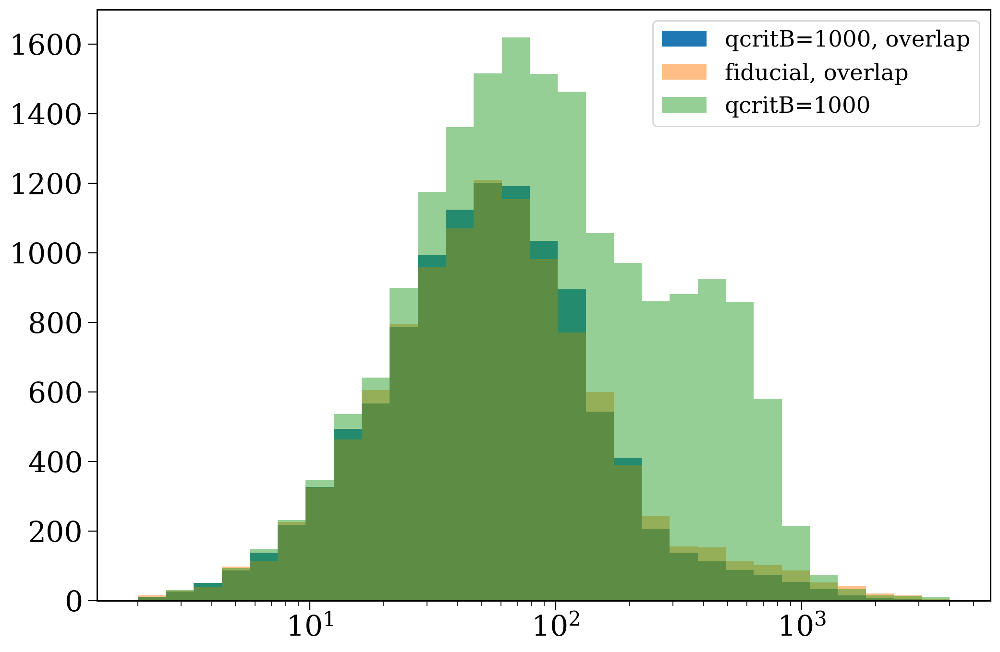

In [107]:
plt.hist(d_s[1][bn_s[1].isin(bn_s[0])].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), label="qcritB=1000, overlap")
plt.hist(d_s[0][bn_s[0].isin(bn_s[1])].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), alpha=0.5, label="fiducial, overlap")
plt.hist(d_s[1].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), alpha=0.5, label="qcritB=1000")

plt.legend(fontsize=0.7*fs)

plt.xscale("log")
plt.show()

In [108]:
p = "qcritB-1000.0"
sn_rows = pops[p].bpp[((pops[p].bpp["evol_type"] == 15) | (pops[p].bpp["evol_type"] == 16)) & ~pops[p].bpp["bin_num"].isin(pops[p].duplicate_sn)]
    
primary_sn_rows = sn_rows[sn_rows["evol_type"] == 15]
secondary_sn_rows = sn_rows[sn_rows["evol_type"] == 16]

sn_2_nums = secondary_sn_rows[pops[p].sn_2]["bin_num"]
sn_1_rows = pops[p].bpp.loc[sn_2_nums][(pops[p].bpp.loc[sn_2_nums]["evol_type"] == 15)]

time_before_first_sn = secondary_sn_rows[pops[p].sn_2]["tphys"].copy()
time_before_first_sn[np.isin(sn_2_nums, sn_1_rows["bin_num"])] = sn_1_rows["tphys"]

time_spent_ejected = np.ones(len(sn_2_nums)) * 1e-4
time_spent_ejected[np.isin(sn_2_nums, sn_1_rows["bin_num"])] = secondary_sn_rows[pops[p].sn_2][np.isin(sn_2_nums, sn_1_rows["bin_num"])]["tphys"] - sn_1_rows["tphys"]
time_spent_ejected[secondary_sn_rows[pops[p].sn_2]["sep"] > 0.0] = 1e-4

vel = np.zeros(len(sn_2_nums))
vel[np.isin(sn_2_nums, sn_1_rows["bin_num"])] = pops[p].kick_info.loc[sn_1_rows["bin_num"]].drop_duplicates(subset="bin_num", keep="first")["vsys_2_total"]

porb_sn_1 = np.repeat(1e7, len(sn_2_nums))
porb_sn_1[np.isin(sn_2_nums, sn_1_rows["bin_num"])] = sn_1_rows["porb"]

sep_sn_1 = np.repeat(1e14, len(sn_2_nums))
sep_sn_1[np.isin(sn_2_nums, sn_1_rows["bin_num"])] = sn_1_rows["sep"] * (1 - sn_1_rows["ecc"])

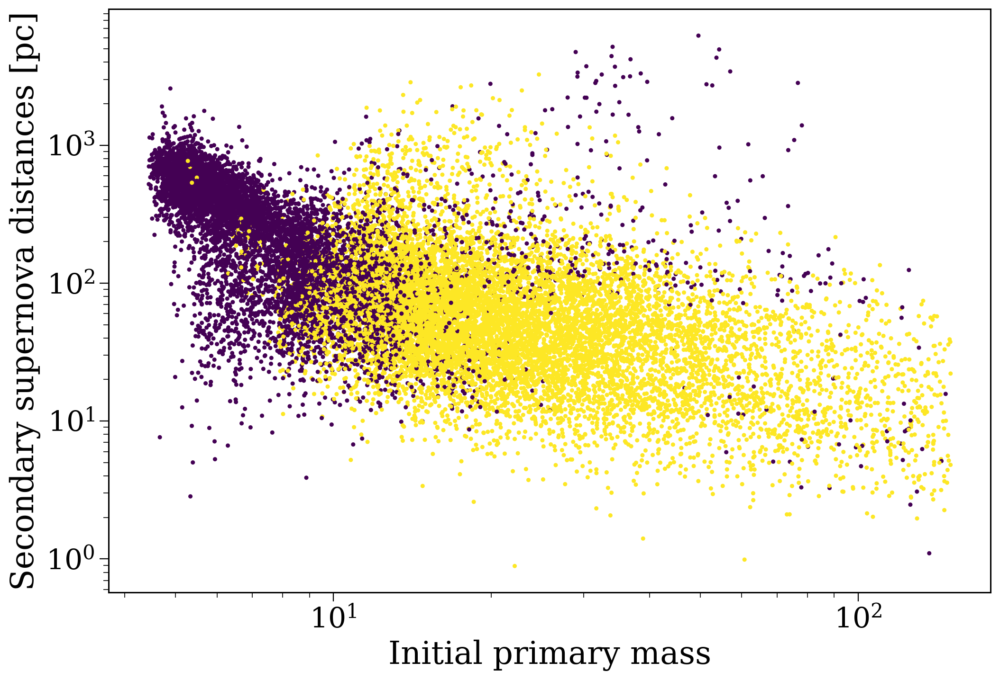

In [109]:
plt.scatter(pops[p].initC.loc[secondary_sn_rows[pops[p].sn_2]["bin_num"]]["mass_1"],
            pops[p].secondary_sn_distances[pops[p].sn_2].to(u.pc), s=5,
            c=bn_s[1].isin(bn_s[0]) if p == "qcritB-1000.0" else bn_s[0].isin(bn_s[1]))
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Initial primary mass")
plt.ylabel("Secondary supernova distances [pc]")
plt.show()

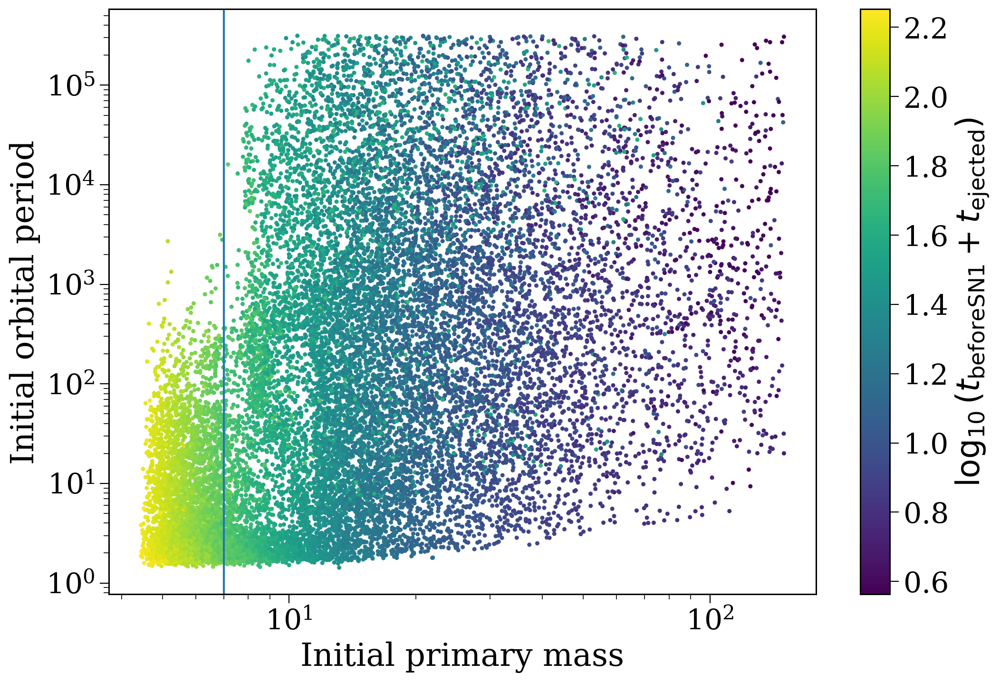

In [110]:
fig, ax = plt.subplots()

scatter = ax.scatter(pops[p].initC.loc[secondary_sn_rows[pops[p].sn_2]["bin_num"]]["mass_1"],
            pops[p].initC.loc[secondary_sn_rows[pops[p].sn_2]["bin_num"]]["porb"],
            c=np.log10(time_before_first_sn + time_spent_ejected),
            s=5)
fig.colorbar(scatter, label=r"$\log_{10}(t_{\rm before SN1} + t_{\rm ejected})$")
ax.set(xscale="log", yscale="log", xlabel="Initial primary mass", ylabel="Initial orbital period")

plt.axvline(7)
plt.show()

## Mass transfer efficiency

### Times

Question: Why do merger times reduce? What removes the late mergers?

41053
46365
52685


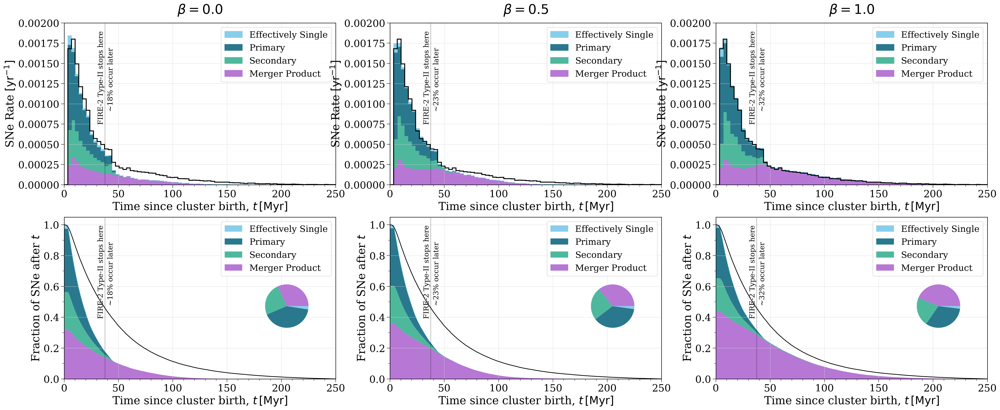

In [357]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))
for p, x, l in zip(["beta-0.0", "beta-0.5", "beta-1.0"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   [r"$\beta = 0.0$", r"$\beta = 0.5$", r"$\beta = 1.0$"]):
    plotting.sandpile(pops[p], bins=np.linspace(0, 250, 75),
                      comparison_pop=pops["fiducial"],
                      var="time",
                      top_ax_dict={"ylim": (0, 0.002)}, fig=fig, axes=x, show=False, stacked=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
    print(get_total_sn(pops[p]))
plt.show()

In [257]:
for p in ["beta-0.0", "beta-0.5", "beta-1.0", "fiducial"]:
    merger_nums = np.unique(np.concatenate((
        pops[p].sn_1_merger[pops[p].sn_1_merger].index,
        pops[p].sn_2_merger[pops[p].sn_2_merger].index,
    )))
    reverse_mt_nums = pops[p].bpp[(pops[p].bpp["RRLO_2"] >= 1) & (pops[p].bpp["RRLO_1"] < 1)]["bin_num"].unique()

    print(np.isin(merger_nums, reverse_mt_nums).sum() / len(merger_nums))

0.1686241610738255
0.3527043269230769
0.49993509584180695
0.47393558951965065


### Distances

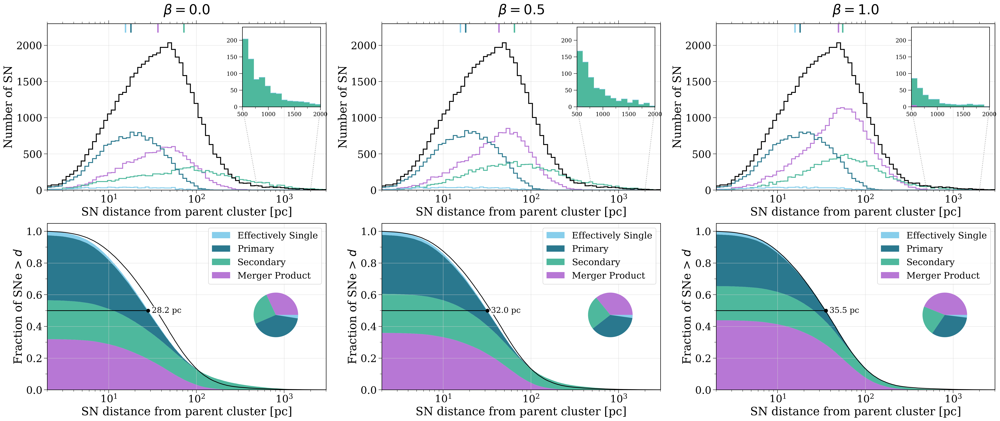

In [238]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["beta-0.0", "beta-0.5", "beta-1.0"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   [r"$\beta = 0.0$", r"$\beta = 0.5$", r"$\beta = 1.0$"]):
    plotting.sandpile(pops[p], bins=np.geomspace(2e0, 3e3, 75),
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 2300)},
                      inset_ax_dict={"ylim": (0, 240)}, fig=fig, axes=x, show=False, stacked=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

11015
10063


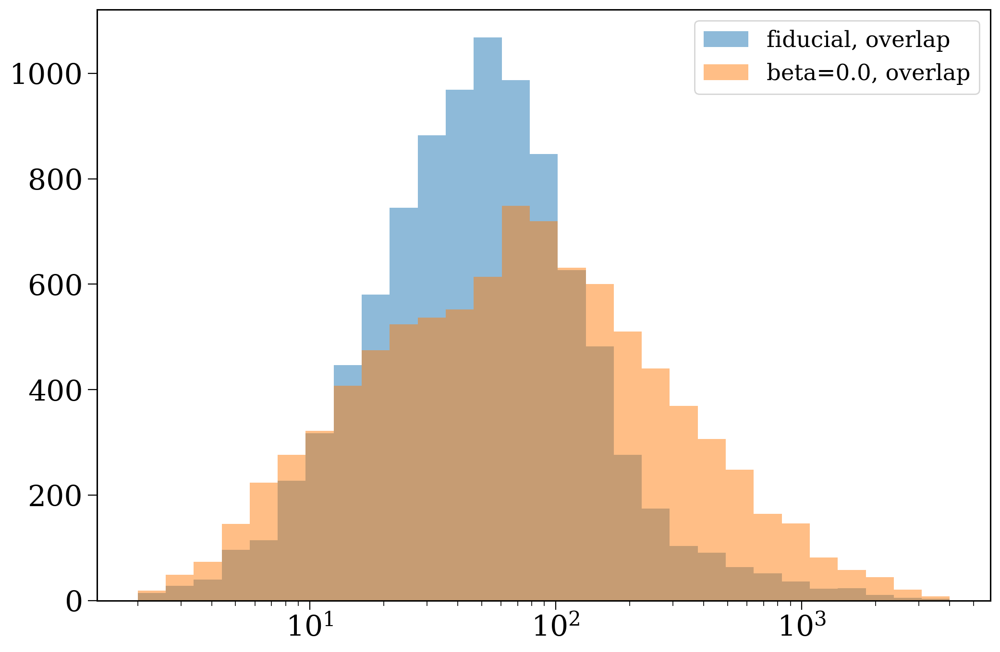

In [248]:
bn_s, d_s = [], []
for p in ["fiducial", "beta-0.0"]:
    bn_s.append(pops[p].sn_2[pops[p].sn_2].index)
    d_s.append(pops[p].secondary_sn_distances[pops[p].sn_2])
    print(len(bn_s[-1]))

intersect = np.intersect1d(bn_s[0], bn_s[1])

plt.hist(d_s[0][bn_s[0].isin(intersect)].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), alpha=0.5, label="fiducial, overlap")
plt.hist(d_s[1][bn_s[1].isin(intersect)].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), alpha=0.5, label="beta=0.0, overlap")

# plt.hist(d_s[1].to(u.pc).value, bins=np.geomspace(2e0, 4e3, 30), alpha=0.5, label="qcritB=1000")

plt.legend(fontsize=0.7*fs)

plt.xscale("log")
plt.show()

In [249]:
diffs = [(d_s[0][bn_s[0] == num] - d_s[1][bn_s[1] == num])[0].to(u.pc).value for num in intersect] * u.pc

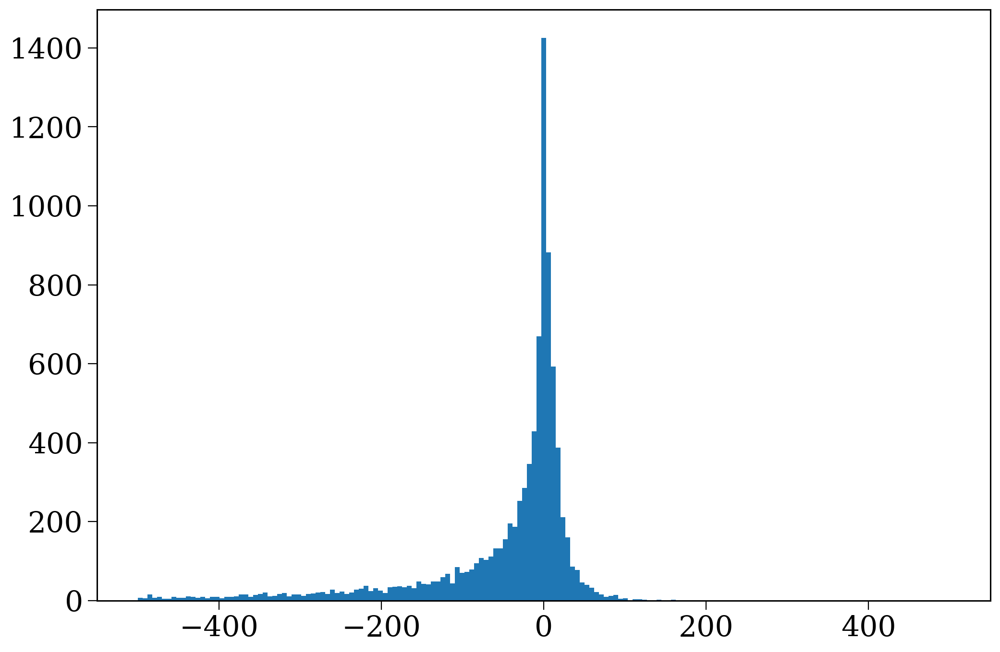

In [250]:
plt.hist(diffs.value, bins="fd", range=(-500, 500));
plt.show()

In [251]:
intersect[diffs < -500 * u.pc]

array([  6978,   7895,   8761,  10679,  16403,  16553,  16720,  17230,
        18727,  19968,  22492,  23738,  24417,  24464,  30304,  30997,
        32263,  32360,  38208,  39159,  44774,  44992,  46905,  46913,
        49096,  49152,  49319,  55069,  56830,  57143,  62364,  67245,
        68093,  68572,  71495,  71542,  72017,  72034,  72282,  72413,
        72423,  73420,  74570,  74571,  76478,  76829,  91976,  93648,
       101692, 101796, 101801, 101863, 105733, 107583, 109381, 113541,
       117589, 117970, 117985, 118371, 123978, 124177, 124179, 124473,
       124681, 124897, 125445, 127213, 132064, 132527, 133854, 134352,
       142647, 143322, 144959, 148555, 152693, 156751, 156759, 165126,
       165169, 169465, 169996, 171404, 172090, 176605, 178406, 187353,
       188223, 189215, 190986, 191251, 191979, 196683, 196719, 197991,
       199247, 199899, 204860, 205184, 207593, 208124, 208899, 208904,
       212082, 212135, 215257, 217012, 221415, 221787, 222103, 222114,
      

      star  disrupted  natal_kick        phi      theta  mean_anomaly  \
6978   1.0        1.0  243.136676  20.568431  54.954359           0.0   
6978   2.0        1.0  208.446086  -6.668195  77.608291           0.0   

      delta_vsysx_1  delta_vsysy_1  delta_vsysz_1  vsys_1_total  \
6978     -10.742285     149.610619      62.917489    162.657138   
6978       0.000000       0.000000       0.000000    162.657138   

      delta_vsysx_2  delta_vsysy_2  delta_vsysz_2  vsys_2_total  theta_euler  \
6978      30.584496      -8.305671       1.926714     31.750713    27.267011   
6978      44.428683     202.212755     -24.204637    209.101028     0.000000   

       phi_euler   psi_euler   randomseed  bin_num  
6978  279.631705  127.116998 -438488881.0   6978.0  
6978    0.000000    0.000000   52121136.0   6978.0  


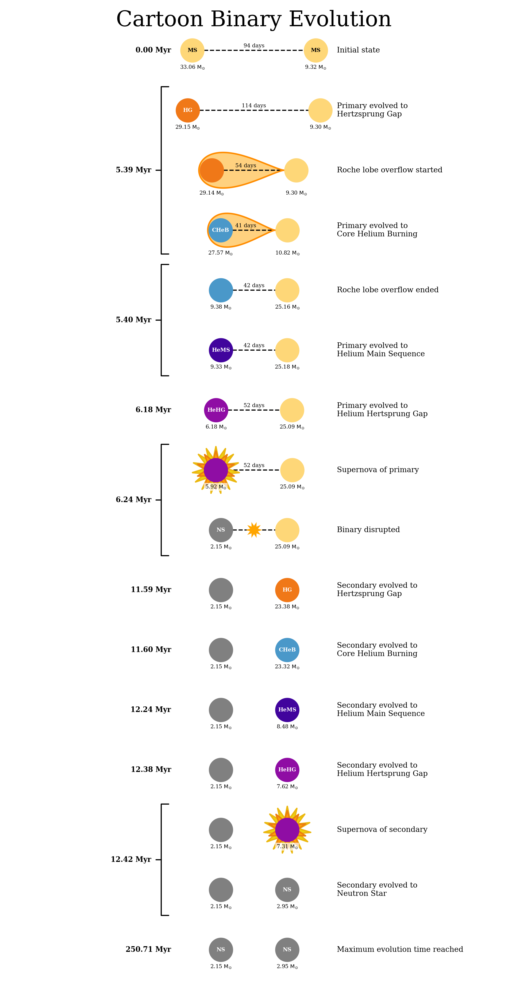

      star  disrupted  natal_kick        phi      theta  mean_anomaly  \
6978   1.0        1.0  243.136676  20.568431  54.954359           0.0   
6978   2.0        1.0  208.446086  -6.668195  77.608291           0.0   

      delta_vsysx_1  delta_vsysy_1  delta_vsysz_1  vsys_1_total  \
6978      18.878998     156.515132      68.215683    171.775384   
6978       0.000000       0.000000       0.000000    171.775384   

      delta_vsysx_2  delta_vsysy_2  delta_vsysz_2  vsys_2_total  theta_euler  \
6978      65.301399     -17.569360       3.974937     67.740352    26.090818   
6978      44.428683     202.212755     -24.204637    215.738534     0.000000   

       phi_euler   psi_euler   randomseed  bin_num  
6978  279.631705  127.116998 -438488881.0   6978.0  
6978    0.000000    0.000000   52121136.0   6978.0  


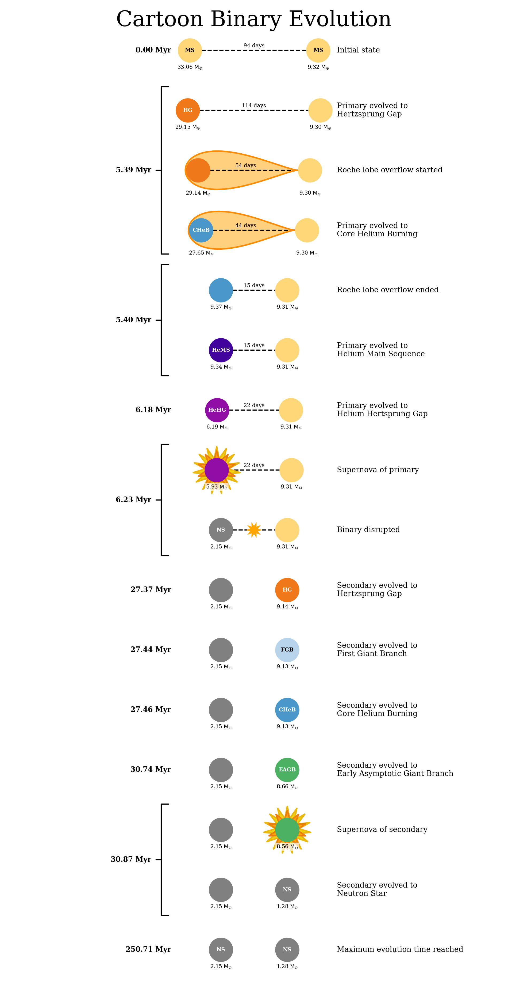

In [252]:
for p in ["fiducial", "beta-0.0"]:
    num = 6978
    print(pops[p].kick_info.loc[num])
    pops[p].plot_cartoon_binary(num)

In [260]:
sn_2_nums

Index([    81,     82,     89,     92,    114,    125,    130,    131,    138,
          140,
       ...
       776898, 776909, 776918, 776926, 776934, 776943, 776944, 776947, 776965,
       776966],
      dtype='int64', length=10063)

In [262]:
pops[p].kick_info.loc[sn_2_nums]

,star,disrupted,natal_kick,phi,theta,mean_anomaly,delta_vsysx_1,delta_vsysy_1,delta_vsysz_1,vsys_1_total,delta_vsysx_2,delta_vsysy_2,delta_vsysz_2,vsys_2_total,theta_euler,phi_euler,psi_euler,randomseed,bin_num
81,1.0,1.0,208.674121,-22.002832,68.479044,0.000000,60.638833,185.514610,-77.997349,210.181648,5.452973,-3.290638,-0.034925,6.369021,66.807097,272.941461,286.924760,-2.812638e+08,81.0
81,2.0,1.0,309.693482,12.355272,212.202430,0.000000,0.000000,0.000000,0.000000,210.181648,-255.984249,-161.217046,66.265988,306.945031,0.000000,0.000000,0.000000,1.427483e+09,81.0
82,1.0,1.0,443.284459,-0.651170,240.098691,0.000000,-145.240684,-412.844506,0.083258,437.647631,15.494630,-8.443690,-0.673968,17.658814,1.451209,95.336416,259.428234,-4.871756e+08,82.0
82,2.0,1.0,493.870197,-51.594038,263.006794,0.000000,0.000000,0.000000,0.000000,437.647631,-37.354213,-304.524189,-387.010921,498.724682,0.000000,0.000000,0.000000,2.099336e+09,82.0
89,1.0,1.0,245.246717,8.615175,83.315104,0.000000,35.627961,243.863580,35.078747,248.936369,-3.139633,-0.989655,0.243181,3.300886,25.955211,120.299617,30.574187,-1.960764e+08,89.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
776947,2.0,1.0,769.305700,-3.585518,72.299931,0.000000,0.000000,0.000000,0.000000,162.730088,233.437414,731.453048,-48.111039,773.614190,0.000000,0.000000,0.000000,1.836442e+09,776947.0
776965,1.0,1.0,186.850098,-29.799705,251.146281,0.000000,-22.002051,-172.024206,-90.567617,195.649971,-6.858442,5.481237,-0.272850,8.783885,38.034987,266.377645,352.150998,-1.329787e+09,776965.0
776965,2.0,1.0,232.179992,53.416831,30.902918,0.000000,0.000000,0.000000,0.000000,195.649971,118.732593,71.068205,186.438812,230.289834,0.000000,0.000000,0.000000,1.554088e+09,776965.0
776966,1.0,0.0,61.031882,-18.207951,153.733492,272.512908,-42.095889,6.170198,-5.472688,42.896218,0.000000,0.000000,0.000000,0.000000,10.328125,255.053337,-23.213427,-2.123049e+09,776966.0


beta-0.0 22.14447858020348 7.550084120037134
beta-0.5 16.462470612055977 7.307301079693154
beta-1.0 14.60028279194402 5.970820133482104
fiducial 14.689544966379762 6.171504557948687


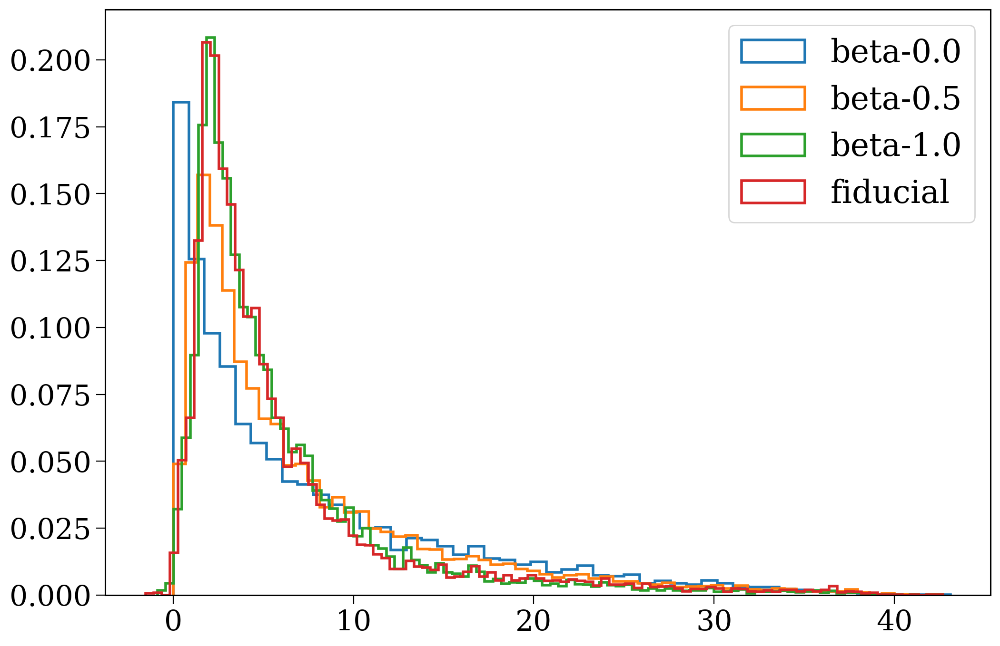

In [295]:
for p in ["beta-0.0", "beta-0.5", "beta-1.0", "fiducial"]:
    # find binaries that have a secondary supernova
    sn_1_nums = pops[p].sn_1[pops[p].sn_1].index
    sn_2_nums = pops[p].sn_2[pops[p].sn_2].index
    sn_2_nums = sn_2_nums[np.isin(sn_2_nums, sn_1_nums)]
    
    # get ejection velocity of each secondary
    ki = pops[p].kick_info.loc[sn_2_nums]
    v_ej = ki[ki["star"] == 1]["vsys_2_total"]
    
    # find time between two supernovae
    bpp = pops[p].bpp.loc[sn_2_nums]
    sn_1_time = bpp[bpp["evol_type"] == 15]["tphys"]
    sn_2_time = bpp[bpp["evol_type"] == 16]["tphys"]
    t_diff = sn_2_time - sn_1_time

    print(p, np.mean(v_ej), np.mean(t_diff))

    plt.hist(t_diff, bins="fd", label=p, density=True, histtype="step", lw=2)
plt.legend()
plt.show()

In [290]:
sn_2_time[11071]

54.51318403900431

In [268]:
sn_1_time

81         9.900690
82         6.844789
89         6.478879
92         5.737758
114       15.603520
            ...    
776918     6.123664
776926    14.616555
776934    13.754047
776943     8.383009
776965     4.717279
Name: tphys, Length: 10829, dtype: float64

## Supernova kicks

In [1]:
import astropy.constants as const

In [170]:
np.sqrt(0.1*const.G * 10000 * u.Msun / (5 * 3 * u.pc)).to(u.km / u.s)

<Quantity 0.53546972 km / s>

In [213]:
first_co_rows = pops[p].bpp[pops[p].bpp["kstar_1"].isin([13, 14])
            | pops[p].bpp["kstar_2"].isin([13, 14])].drop_duplicates(subset="bin_num", keep="first")

In [221]:
for p in ["fiducial", "ccsn-20", "ecsn-265", "no-fallback"]:
    first_co_rows = pops[p].bpp[pops[p].bpp["kstar_1"].isin([13, 14]) | pops[p].bpp["kstar_2"].isin([13, 14])].drop_duplicates(subset="bin_num", keep="first")
    print((first_co_rows["sep"] == -1).sum() / ((first_co_rows["sep"] == -1) | (first_co_rows["sep"] > 0)).sum())

0.8505182465990067
0.3509915930157361
0.8951595515308323
0.8703244583378247


### Small kicks remove secondaries?

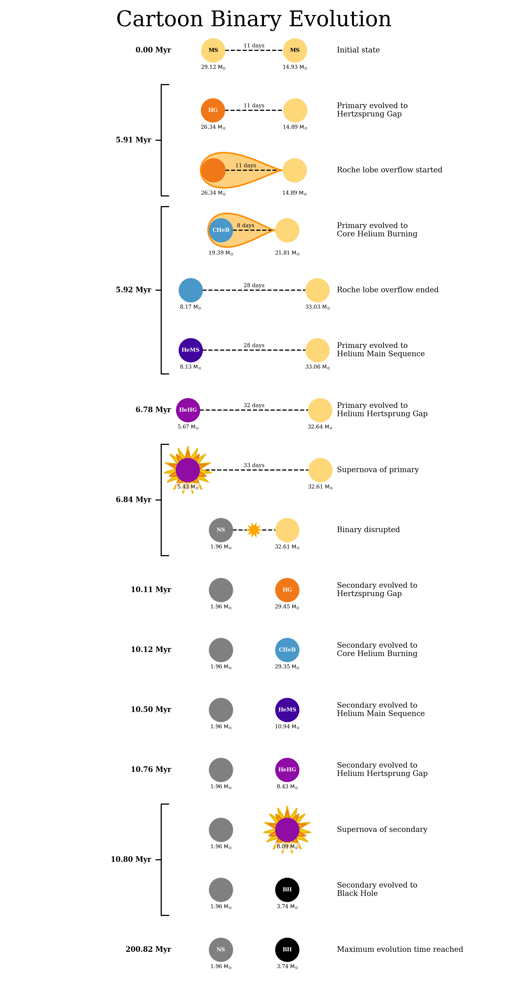

(<Figure size 1200x2400 with 1 Axes>, <Axes: >)

In [199]:
pops["fiducial"].plot_cartoon_binary(82)

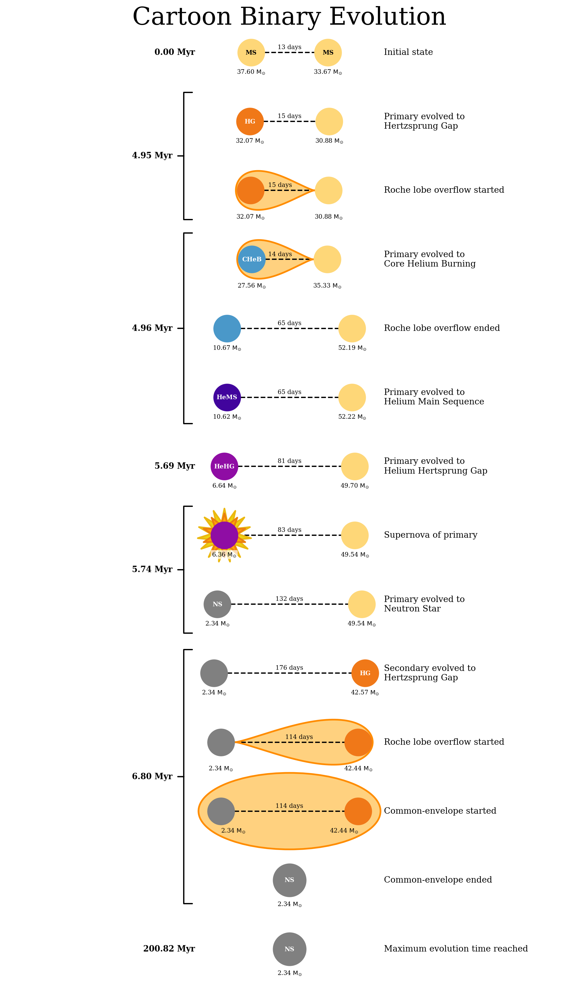

(<Figure size 1200x2100 with 1 Axes>, <Axes: >)

In [201]:
pops["ccsn-20"].plot_cartoon_binary(92)

In [203]:
x = pops["fiducial"].sn_2[pops["fiducial"].sn_2].index

In [204]:
y = pops["ccsn-20"].sn_2[pops["ccsn-20"].sn_2].index

In [208]:
pops["ccsn-20"].final_bpp.loc[x[~np.isin(x, y)]]

,tphys,mass_1,mass_2,kstar_1,kstar_2,sep,porb,ecc,RRLO_1,RRLO_2,evol_type,aj_1,aj_2,tms_1,tms_2,massc_1,massc_2,rad_1,rad_2,mass0_1,mass0_2,lum_1,lum_2,teff_1,teff_2,radc_1,radc_2,menv_1,menv_2,renv_1,renv_2,omega_spin_1,omega_spin_2,B_1,B_2,bacc_1,bacc_2,tacc_1,tacc_2,epoch_1,epoch_2,bhspin_1,bhspin_2,bin_num,metallicity
82,200.815870,0.0,1.962311,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,3.271709,190.699372,1.000000e+10,1.000000e+10,0.0,1.962311,0.000014,0.000014,5.670836,29.450188,0.002935,8.639446e-07,360673.600255,47241.867918,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,1.707904e+09,7.677754e+07,2.371511e+10,8.725224e+11,0.000023,0.0,3.271713,0.0,6.844789,10.116498,0.0,0.0,82,0.017819
92,200.815870,0.0,2.343639,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,1.066262,194.011850,1.000000e+10,1.000000e+10,0.0,2.343639,0.000014,0.000014,6.642779,42.574778,0.031126,9.401566e-07,650860.374867,48250.925105,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,8.927038e+08,1.521092e+08,8.223604e+10,4.345545e+11,0.000026,0.0,1.066265,0.0,5.737758,6.804020,0.0,0.0,92,0.017819
114,200.815870,0.0,1.277585,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,1.111999,184.100351,1.000000e+10,1.000000e+10,0.0,1.277585,0.000014,0.000014,2.992079,22.332464,0.019059,6.953477e-07,575746.291892,44746.192953,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,4.748682e+08,3.234020e+07,2.247770e+11,2.105960e+12,0.000002,0.0,1.111999,0.0,15.603520,16.715519,0.0,0.0,114,0.017819
125,200.815870,0.0,1.277598,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,1.226253,182.707405,1.000000e+10,1.000000e+10,0.0,1.277598,0.000014,0.000014,2.825082,21.222049,0.015673,7.059952e-07,548269.401530,44916.512011,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,5.720140e+08,6.015077e+06,6.469457e+11,1.138780e+13,0.000014,0.0,1.226253,0.0,16.882211,18.108464,0.0,0.0,125,0.017819
140,200.815870,0.0,1.502185,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,3.872356,185.614852,1.000000e+10,1.000000e+10,0.0,1.502185,0.000014,0.000014,4.389193,21.330963,0.001752,7.624462e-07,317012.665733,45788.656076,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,9.855815e+07,7.306321e+06,8.267843e+12,9.284394e+12,0.000003,0.0,3.872360,0.0,11.328662,15.201018,0.0,0.0,140,0.017819
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
776715,240.394208,0.0,1.631547,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,2.319107,229.670607,1.000000e+10,1.000000e+10,0.0,1.631547,0.000014,0.000014,4.802509,28.981812,0.005162,5.263334e-07,415348.960309,41736.961547,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,5.632697e+08,6.108832e+06,2.927502e+11,9.944474e+12,0.000019,0.0,2.319107,0.0,8.404494,10.723601,0.0,0.0,776715,0.018003
776895,266.098204,0.0,1.277612,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,12.001648,233.389888,1.000000e+10,1.000000e+10,0.0,1.277612,0.000014,0.000014,2.408598,9.046107,0.000164,4.326665e-07,175252.612283,39741.469373,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,9.196683e+08,1.772523e+08,1.608823e+10,3.374586e+11,0.000029,0.0,12.001648,0.0,20.706669,32.708316,0.0,0.0,776895,0.019747
776896,266.098204,0.0,1.417403,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,1.512226,254.880241,1.000000e+10,1.000000e+10,0.0,1.417403,0.000014,0.000014,4.121780,28.055193,0.011048,3.889181e-07,502377.082099,38696.361778,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,4.313321e+08,1.150015e+07,5.677339e+11,4.914926e+12,0.000010,0.0,1.512226,0.0,9.705737,11.217963,0.0,0.0,776896,0.019747
776917,266.098204,0.0,1.242007,15,13,0.0,0.0,-1.0,-1.0,0.0001,10,4.425962,235.677262,1.000000e+10,1.000000e+10,0.0,1.242007,0.000014,0.000014,1.421645,15.316268,0.001181,4.163493e-07,287226.843591,39361.355266,0.000014,0.000014,1.000000e-10,1.000000e-10,1.000000e-10,1.000000e-10,2.985602e+08,6.870433e+06,2.424719

# Galaxy variations

In [21]:
gal_pop_file_names = ["fiducial", "alpha-vir-0.1", "alpha-vir-10.0", "r442", "Z-0.5"]
gal_pops = {p:pops[p] for p in gal_pop_file_names}
gal_pop_labels = [pop_details["labels"][pop_details["file_names"].index(f)] for f in gal_pop_file_names]

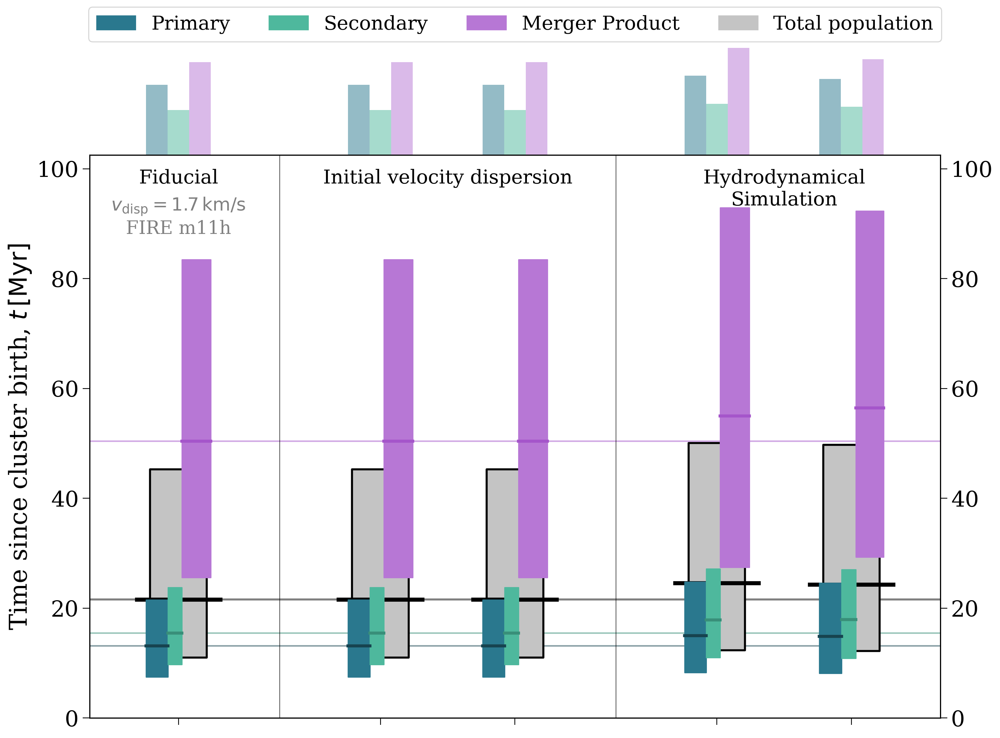

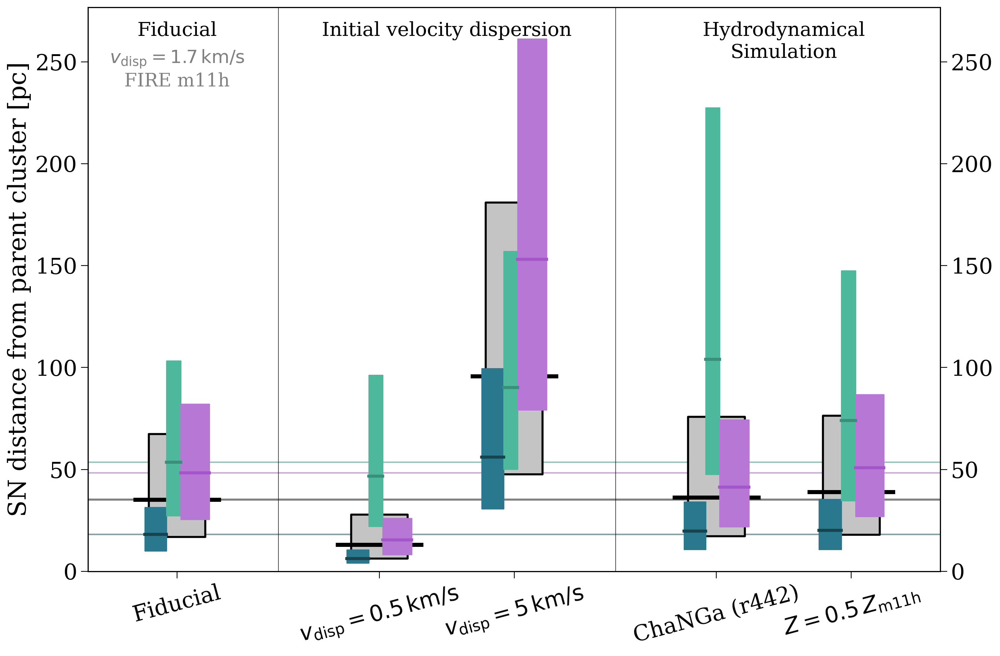

In [188]:
reload(plotting)
fig, ax = plotting.compare_variations(gal_pops, gal_pop_labels, quantity="time", annotate_loc=100,
                                      group_start_inds=[1, 3], figwidth=15,
                                      group_labels=["Fiducial", "Initial velocity dispersion", "Hydrodynamical\nSimulation"],
                                    fiducial_settings=[r"$v_{\rm disp} = 1.7 \, {\rm km/s}$", "FIRE m11h"],
                                      show=False, show_labels=False, an_fs_mod=1.5,
                                      rel_bars_mod={"r442": 0.1})
plt.savefig("../plots/variations/var-gal-time.pdf", format="pdf", bbox_inches="tight")
fig, ax = plotting.compare_variations(gal_pops, gal_pop_labels, quantity="distance", annotate_loc=270,
                                      group_start_inds=[1, 3], figwidth=15,
                                      group_labels=["Fiducial", "Initial velocity dispersion", "Hydrodynamical\nSimulation"],
                                    fiducial_settings=[r"$v_{\rm disp} = 1.7 \, {\rm km/s}$", "FIRE m11h"],
                                      show=False, show_rel_bars=False, show_legend=False, an_fs_mod=1.5,
                                      rel_bars_mod={"r442": 0.1}, rotate_labels=15)
plt.savefig("../plots/variations/var-gal-dist.pdf", format="pdf", bbox_inches="tight")
plt.show()

## Virial parameter

In [365]:
for a in [0.0875, 1.0, 8.75]:
    print(a, cogsworth.hydro.utils.dispersion_from_virial_parameter(a, 3 * u.pc, 10000 * u.Msun))

0.0875 0.5008860556574882 km / s
1.0 1.6933039242924428 km / s
8.75 5.0088605565748825 km / s


In [48]:
for a in [0.1, 1.0, 10.0]:
    print(a, cogsworth.hydro.utils.dispersion_from_virial_parameter(a, 3 * u.pc, 10000 * u.Msun))

0.1 0.535469717166544 km / s
1.0 1.6933039242924428 km / s
10.0 5.354697171665442 km / s


## r442

In [49]:
all_times = np.concatenate((plotting.get_data_and_weights(pops["r442-Zx2"], "time", [1])[0]))
print(np.percentile(all_times, [25, 50, 75]).round(1))
(all_times > 44).sum() / len(all_times)

[10.8 21.3 44.5]


0.25304703017665187

In [50]:
all_times = np.concatenate((plotting.get_data_and_weights(pops["fiducial"], "time", [1])[0]))
print(np.percentile(all_times, [25, 50, 75]).round(1))
(all_times > 44).sum() / len(all_times)

[10.8 21.4 44.6]


0.2540688043233297

In [38]:
pops["r442-Zx2"].initC["metallicity"].mean() / pops["fiducial"].initC["metallicity"].mean()

1.039752296408787

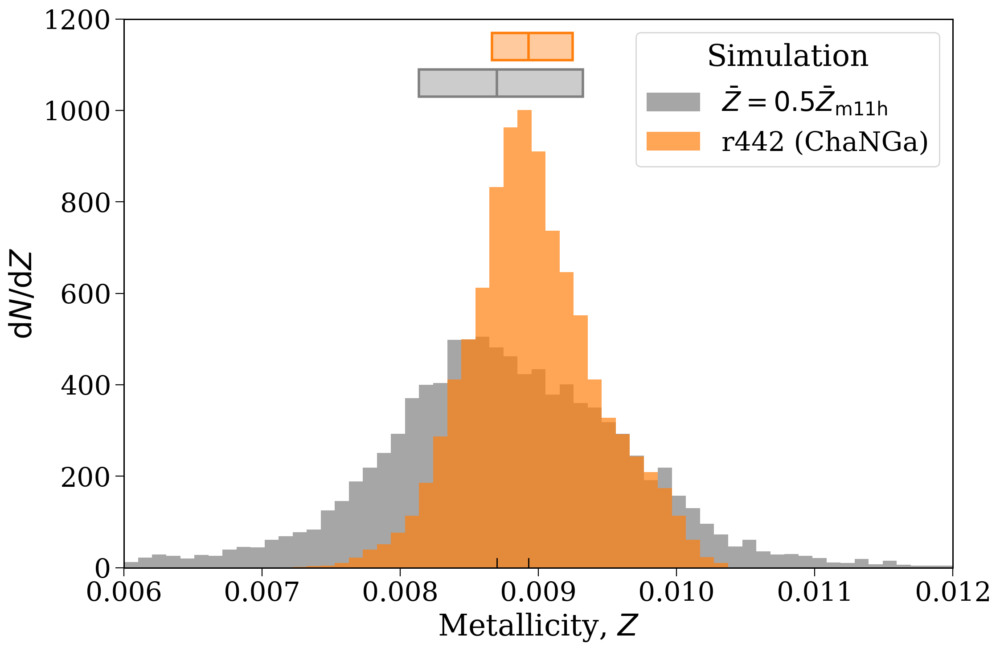

In [399]:
fig, ax = plt.subplots()

right_ax = ax.twinx()
bins=np.linspace(0.006, 0.012, 60)

for dist, l, c, ac, pos in zip([pops["fiducial"].initC["metallicity"], pops["r442"].initC["metallicity"]],
                           [r"$\bar{Z} = 0.5 \bar{Z}_{\rm m11h}$", "r442 (ChaNGa)"],
                           ["grey", "tab:orange"],
                           ["#a6a6a6", "#ffa556"],
                           [2.65, 2.85]):
                           #[0.9, 1.7]):
    patches = ax.hist(dist, bins=bins, density=True, label=l, alpha=0.7, color=c, edgecolor="none", rasterized=True)[-1]
    # for patch in patches:
    #     patch.set_edgecolor(ac)

    # ax.axvline(np.median(dist), color=c)

    bplot = right_ax.boxplot(dist, showfliers=False, vert=False, positions=[pos],
                             medianprops=dict(lw=2, color=c), boxprops=dict(lw=2, color=c),
                             whiskerprops=dict(lw=0),
                             showcaps=False, whis=0, zorder=-pos,
                             patch_artist=True)
    right_ax.plot([np.median(dist), np.median(dist)], [0, 0.05], color='k', lw=1, zorder=-pos)

    # fill with colors
    bplot['boxes'][0].set_facecolor(mpl.colors.to_rgba(c, alpha=0.4))

    # print(np.percentile(dist, [25, 50, 75]))

# plt.xlim(0.006, 0.012)

ax.set_ylim(0, 1200)
right_ax.set_ylim(0, 3)
right_ax.axis("off")

ax.legend(title="Simulation", title_fontsize=fs, fontsize=0.9*fs)
ax.set(xlabel=r"Metallicity, $Z$", ylabel=r"${\rm d}N/{\rm d}Z$", xlim=(bins[0], bins[-1]))

plt.savefig("../plots/metallicity_dists.pdf", format="pdf", bbox_inches="tight")
plt.show()

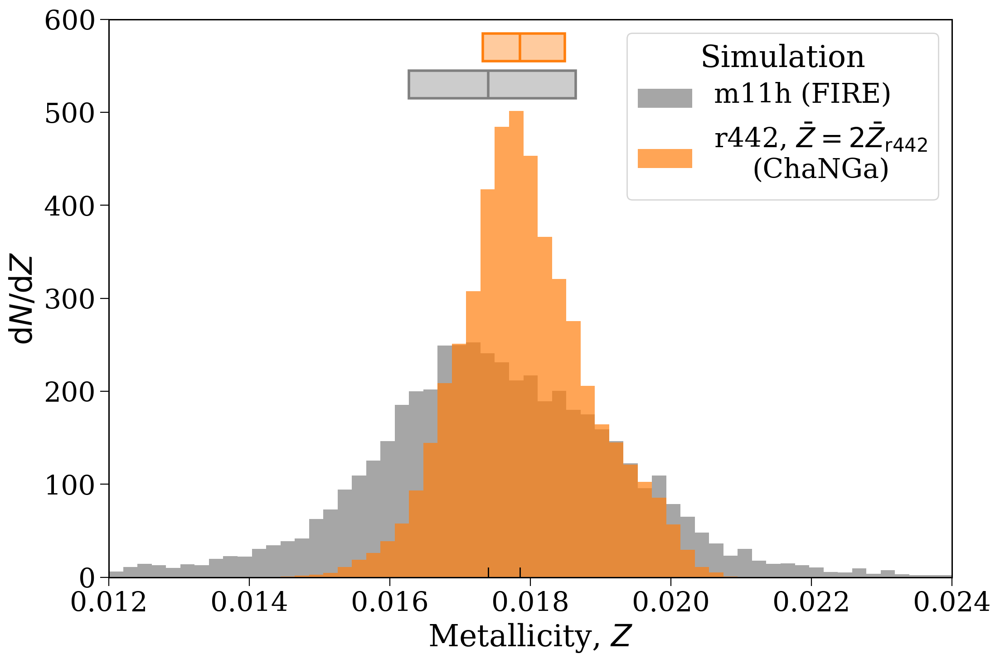

In [13]:
fig, ax = plt.subplots()

right_ax = ax.twinx()
bins=np.linspace(0.006 * 2, 0.012 * 2, 60)

for dist, l, c, ac, pos in zip([pops["fiducial"].initC["metallicity"], pops["r442"].initC["metallicity"]],
                           [r"m11h (FIRE)", "r442, " + r"$\bar{Z} = 2 \bar{Z}_{\rm r442}$" + "\n" + "(ChaNGa)"],
                           ["grey", "tab:orange"],
                           ["#a6a6a6", "#ffa556"],
                           [2.65, 2.85]):
                           #[0.9, 1.7]):
    patches = ax.hist(dist, bins=bins, density=True, label=l, alpha=0.7, color=c, edgecolor="none", rasterized=True)[-1]
    # for patch in patches:
    #     patch.set_edgecolor(ac)

    # ax.axvline(np.median(dist), color=c)

    bplot = right_ax.boxplot(dist, showfliers=False, vert=False, positions=[pos],
                             medianprops=dict(lw=2, color=c), boxprops=dict(lw=2, color=c),
                             whiskerprops=dict(lw=0),
                             showcaps=False, whis=0, zorder=-pos,
                             patch_artist=True)
    right_ax.plot([np.median(dist), np.median(dist)], [0, 0.05], color='k', lw=1, zorder=-pos)

    # fill with colors
    bplot['boxes'][0].set_facecolor(mpl.colors.to_rgba(c, alpha=0.4))

    # print(np.percentile(dist, [25, 50, 75]))

# plt.xlim(0.006, 0.012)

ax.set_ylim(0, 600)
right_ax.set_ylim(0, 3)
right_ax.axis("off")

legend = ax.legend(title="Simulation", title_fontsize=fs, fontsize=0.9*fs)
for text in legend.get_texts():
    text.set_ha('center')
    text.set_va('bottom')
ax.set(xlabel=r"Metallicity, $Z$", ylabel=r"${\rm d}N/{\rm d}Z$", xlim=(bins[0], bins[-1]))

plt.savefig("../plots/metallicity_dists.pdf", format="pdf", bbox_inches="tight")
plt.show()

# Initial condition variations

In [189]:
ini_pop_file_names = ["fiducial", 
                      "imf-1.9", "imf-2.7",
                      "porb-0", "porb-minus1",
                      "q-plus1", "q-minus1"]
ini_pops = {p:pops[p] for p in ini_pop_file_names}
ini_pop_labels = pop_details["labels"][np.isin(pop_details["file_names"], ini_pop_file_names)]

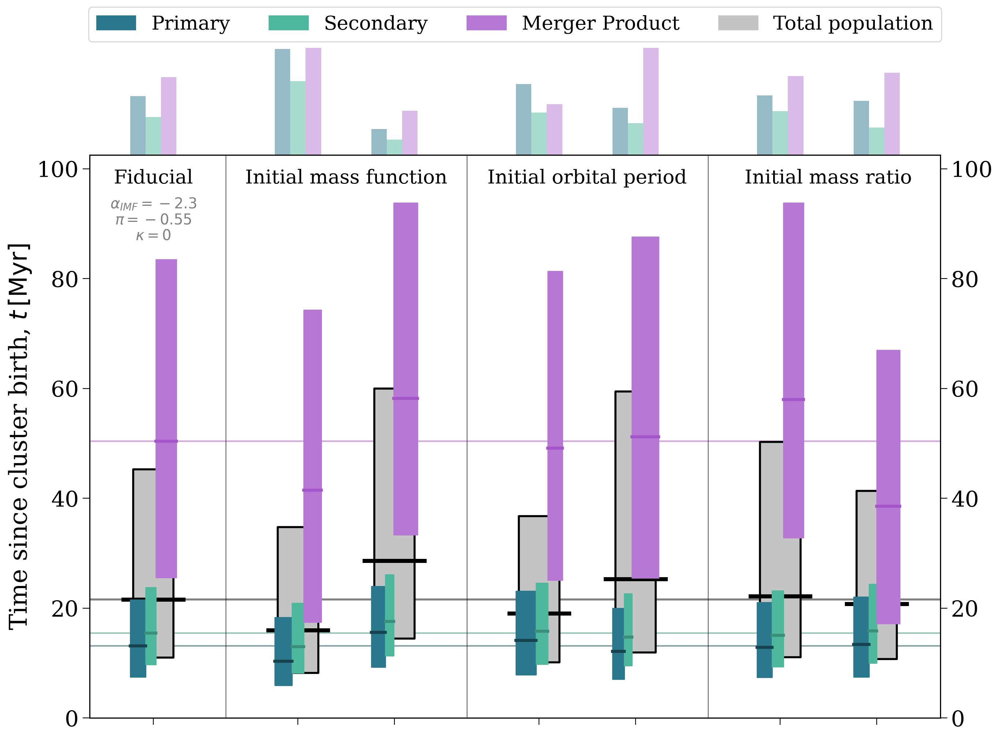

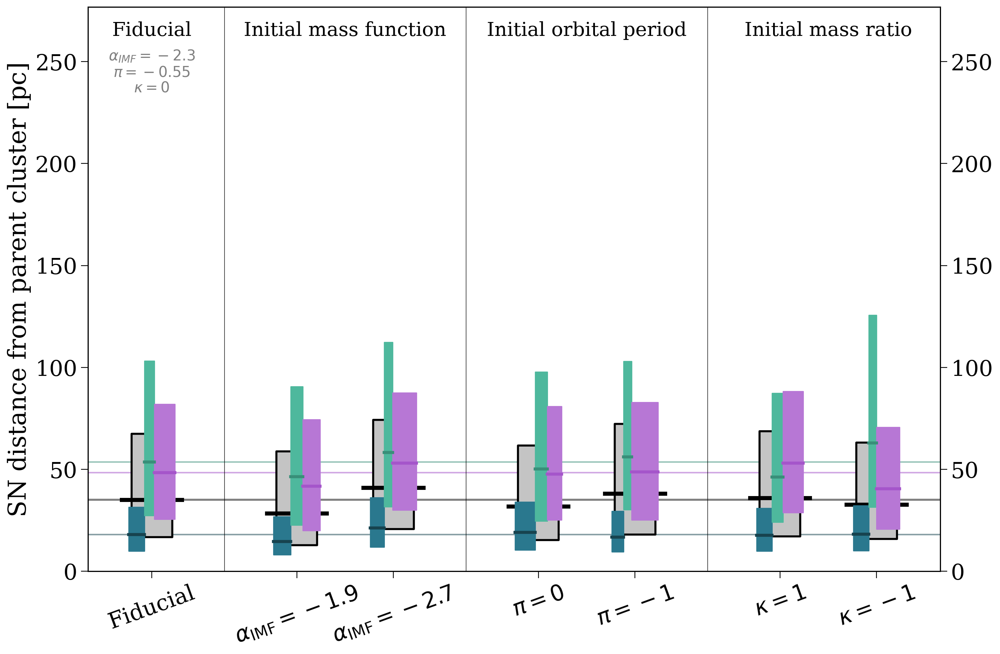

In [190]:
reload(plotting)
fig, ax = plotting.compare_variations(ini_pops, ini_pop_labels, quantity="time", annotate_loc=100,
                                      group_start_inds=[1,3,5], figwidth=15,
                                      group_labels=["Fiducial", "Initial mass function", "Initial orbital period", "Initial mass ratio", "Metallicity"],
                                      fiducial_settings=[r"$\alpha_{IMF} = -2.3$", r"$\pi=-0.55$", r"$\kappa=0$"],
                                      show=False, show_labels=False, an_fs_mod=1.2)
plt.savefig("../plots/variations/var-ini-time.pdf", format="pdf", bbox_inches="tight")
plt.show()

reload(plotting)
fig, ax = plotting.compare_variations(ini_pops, ini_pop_labels, quantity="distance", annotate_loc=270,
                                      group_start_inds=[1,3,5], figwidth=15,
                                      group_labels=["Fiducial", "Initial mass function", "Initial orbital period", "Initial mass ratio"],
                                      fiducial_settings=[r"$\alpha_{IMF} = -2.3$", r"$\pi=-0.55$", r"$\kappa=0$"],
                                      show=False, show_rel_bars=False, show_legend=False, an_fs_mod=1.2, rotate_labels=20)
plt.savefig("../plots/variations/var-ini-dist.pdf", format="pdf", bbox_inches="tight")
plt.show()

## Initial mass function

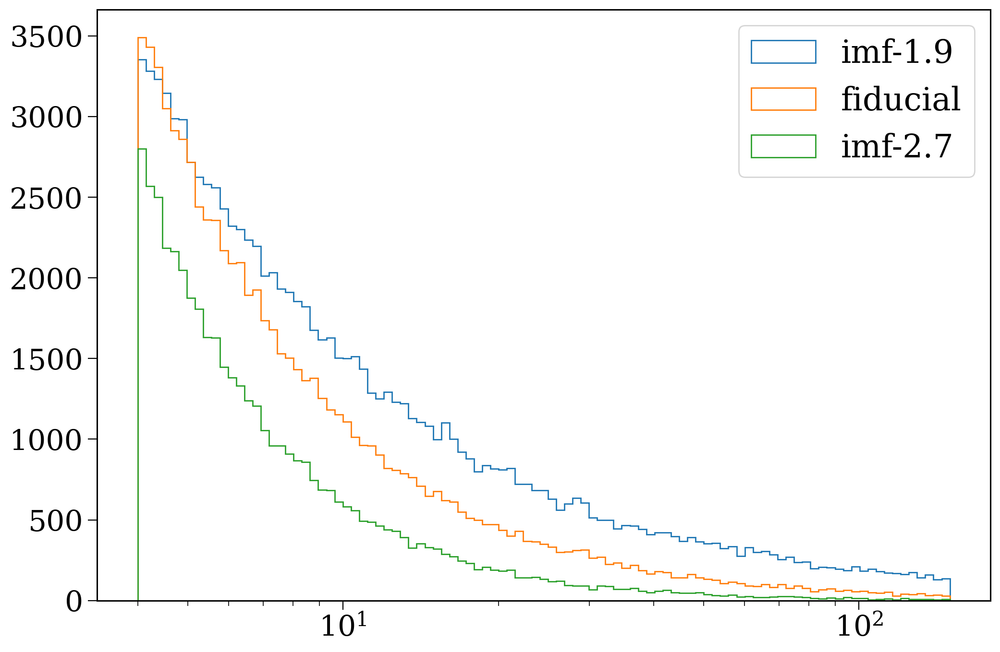

In [86]:
for p in ["imf-1.9", "fiducial", "imf-2.7"]:
    plt.hist(pops[p].initC["mass_1"], bins=np.geomspace(4, 150, 100), histtype="step", label=p)
plt.legend()
plt.xscale("log")
plt.show()

### Timing

imf-1.9
  SN S: 1.9474196689386563
  SN 1: 1.804118830630844
  SN 2: 1.953914083340999
  SN M: 1.3782501678227792
  TOT : 7.083702750733279
fiducial
  SN S: 1.0
  SN 1: 1.0
  SN 2: 1.0
  SN M: 1.0
  TOT : 4.0
imf-2.7
  SN S: 0.44011684518013633
  SN 1: 0.4420641496035034
  SN 2: 0.4095299420476497
  SN M: 0.5675542626985903
  TOT : 1.8592651995298797


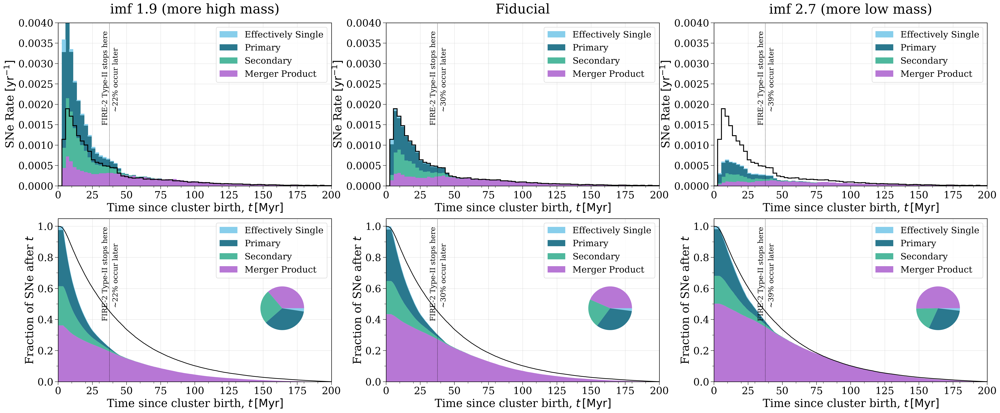

In [99]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["imf-1.9", "fiducial", "imf-2.7"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   ["imf 1.9 (more high mass)", r"Fiducial", "imf 2.7 (more low mass)"]):
    sn_demographics(pops[p], norm=True, show=True)
    plotting.sandpile(pops[p], bins=np.linspace(0, 200, 75), var="time",
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 0.004)}, fig=fig, axes=x, show=False, stacked=True)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

In [117]:
all_times = np.concatenate(plotting.get_data_and_weights(pops["imf-1.9"], "time", [1])[0])
print((all_times > 44).sum())
(all_times > 44).sum() / len(all_times)

15105


0.17870663953433344

In [116]:
all_times = np.concatenate(plotting.get_data_and_weights(pops["fiducial"], "time", [1])[0])
print((all_times > 44).sum())
(all_times > 44).sum() / len(all_times)

12920


0.2526348722160302

In [115]:
all_times = np.concatenate(plotting.get_data_and_weights(pops["imf-2.7"], "time", [1])[0])
print((all_times > 44).sum())
(all_times > 44).sum() / len(all_times)

8244


0.3290229885057471

### Distances

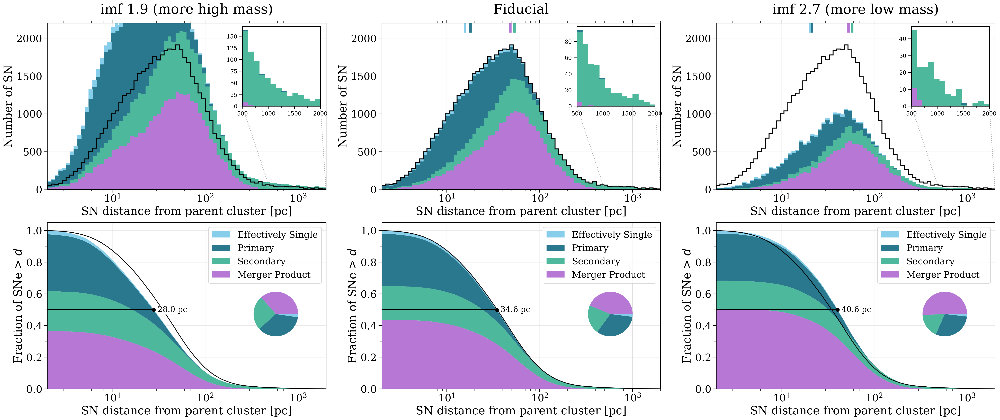

In [94]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["imf-1.9", "fiducial", "imf-2.7"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   ["imf 1.9 (more high mass)", r"Fiducial", "imf 2.7 (more low mass)"]):
    plotting.sandpile(pops[p], bins=np.geomspace(2e0, 2e3, 75), var="distance",
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 2200)}, fig=fig, axes=x, show=False, stacked=True)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

## Initial orbital periods

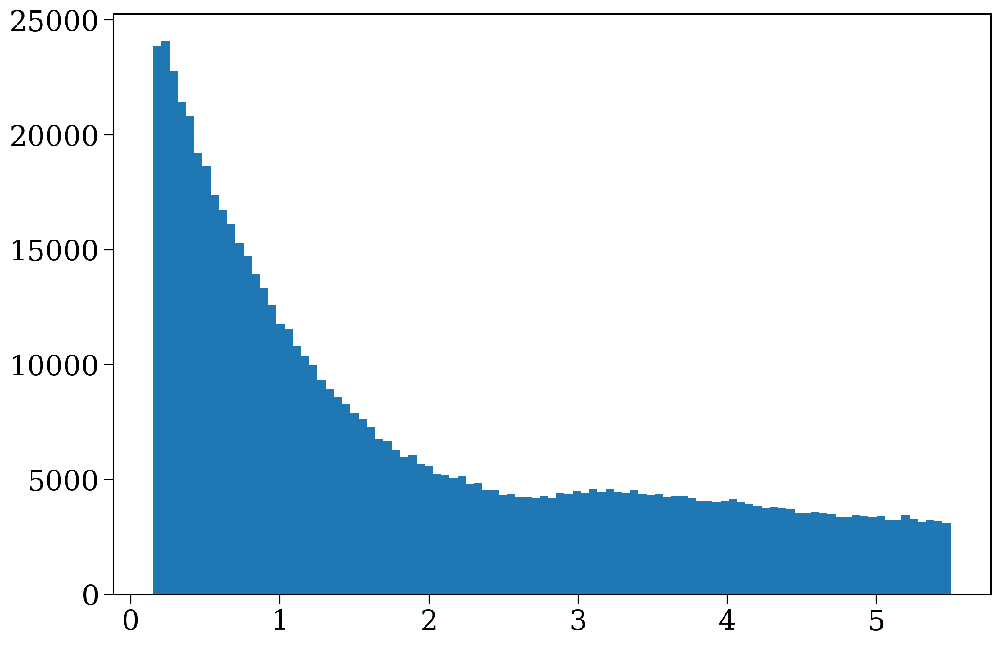

In [31]:
plt.hist(np.log10(pops["porb-max-3"].initC["porb"]), bins="fd");

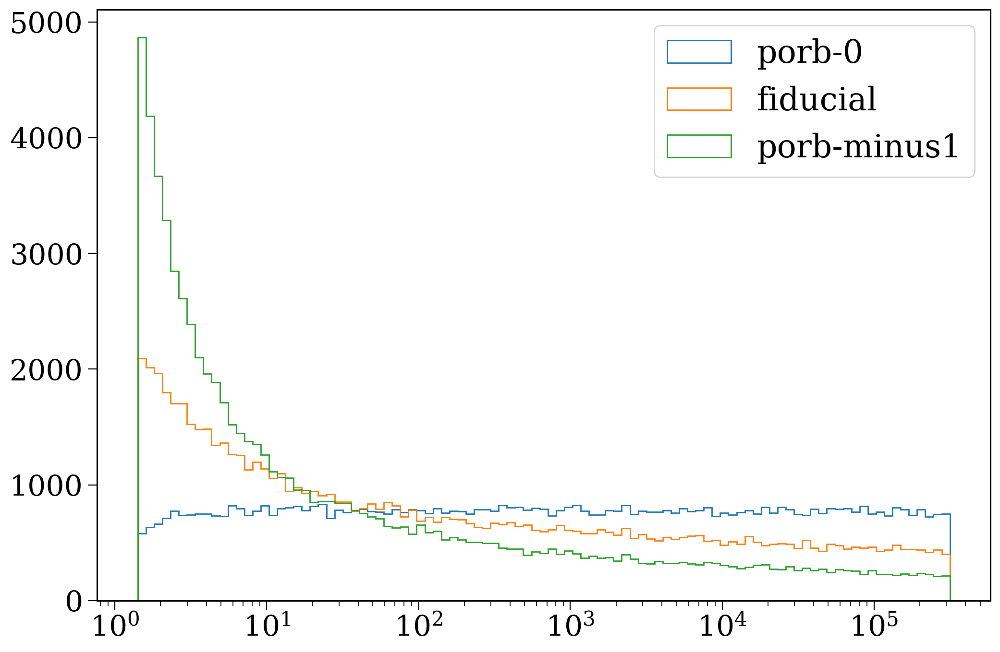

In [25]:
for p in ["porb-0", "fiducial", "porb-minus1"]:
    plt.hist(pops[p].initC["porb"], bins=np.logspace(0.15, 5.5, 100), histtype="step", label=p)
plt.legend()
plt.xscale("log")
plt.show()

### Timing

porb-0
  SN 1: 1.1986677573916091
  SN 2: 1.1179300953245574
  SN M: 0.6488810043668122
  TOT : 0.9397361961965957
fiducial
  SN 1: 1.0
  SN 2: 1.0
  SN M: 1.0
  TOT : 1.0
porb-minus1
  SN 1: 0.8028514666355031
  SN 2: 0.8462097140263277
  SN M: 1.381641193595342
  TOT : 1.0662901841837447


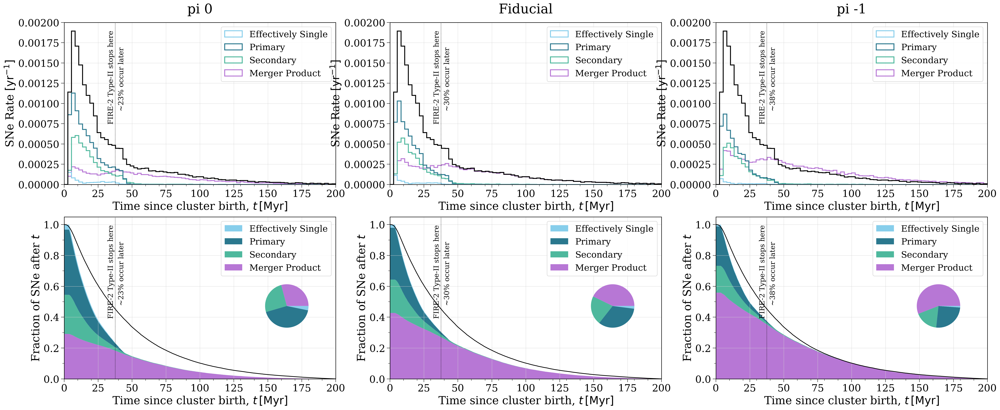

In [277]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["porb-0", "fiducial", "porb-minus1"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   ["pi 0", r"Fiducial", "pi -1"]):
    sn_demographics(pops[p], norm=True)
    plotting.sandpile(pops[p], bins=np.linspace(0, 200, 75), var="time",
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 0.002)}, fig=fig, axes=x, show=False, stacked=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

### Distances

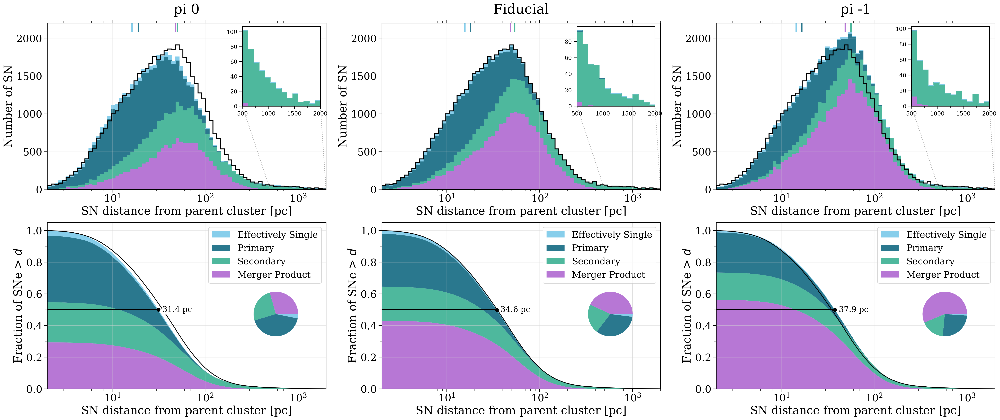

In [274]:
reload(plotting)
fig, axes = plt.subplots(2, 3, figsize=(36, 14))

for p, x, l in zip(["porb-0", "fiducial", "porb-minus1"],
                   [axes[:, 0], axes[:, 1], axes[:, 2]],
                   ["pi 0", r"Fiducial", "pi -1"]):
    plotting.sandpile(pops[p], bins=np.geomspace(2e0, 2e3, 75), var="distance",
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 2200)}, fig=fig, axes=x, show=False, stacked=True)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

## Initial mass ratios

72396
75942
80936


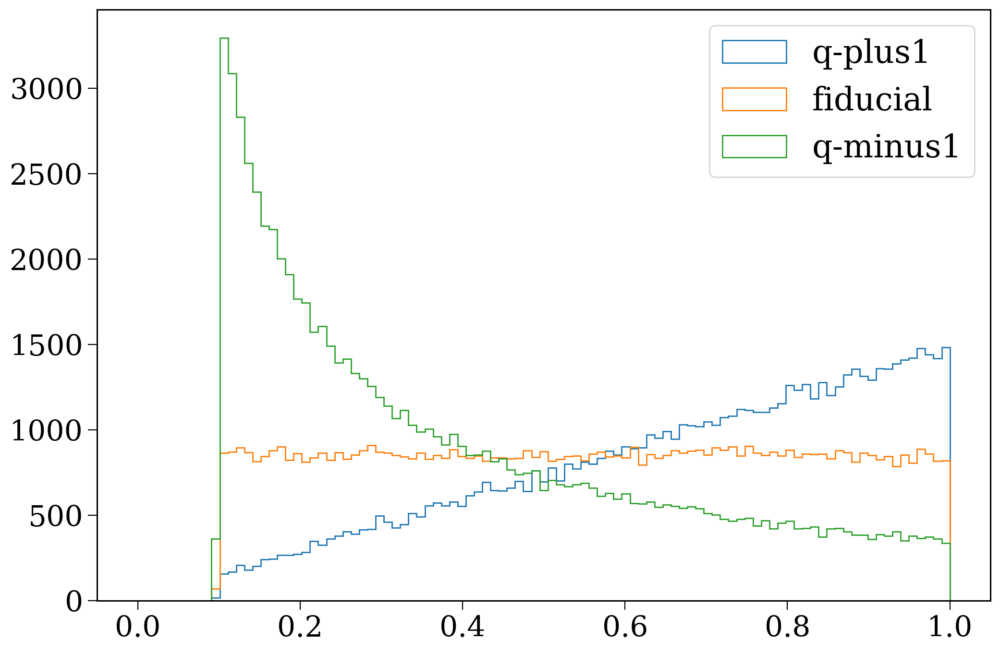

In [53]:
for p in ["q-plus1", "fiducial", "q-minus1"]:
    print(len(pops[p]))
    plt.hist(pops[p].initC["mass_2"] / pops[p].initC["mass_1"], bins=np.linspace(0, 1, 100), histtype="step", label=p)
plt.legend()
plt.show()

### Timing
There seem to be more early merger supernovae when the mass ratio is closer to unity. Maybe it's just early mergers? We should also see fewer secondaries in that case.

In [30]:
def n_ms_merger(p):
    p.bpp["row_id"] = np.arange(len(p.bpp))
    merger_nums = np.unique(np.concatenate((
        p.sn_1_merger[p.sn_1_merger].index,
        p.sn_2_merger[p.sn_2_merger].index,
    )))
    bpp = p.bpp.loc[merger_nums]
    merger_rows = bpp[bpp["sep"] == 0.0].drop_duplicates(subset="bin_num", keep="first")
    merger_rows = bpp[np.isin(bpp["row_id"].values, merger_rows["row_id"] - 1)]
    return len(merger_rows[(merger_rows["kstar_1"] == 1) & (merger_rows["kstar_2"] == 1)])

def n_forward_merger(p):
    last_mt_rows = pops[p].bpp[pops[p].bpp["evol_type"] == 3].drop_duplicates(subset="bin_num", keep="last")
    forward_mt = last_mt_rows[last_mt_rows["RRLO_1"] >= 1]["bin_num"]
    reverse_mt = last_mt_rows[(last_mt_rows["RRLO_2"] >= 1) & (last_mt_rows["RRLO_1"] < 1)]["bin_num"]
    merger_nums = np.concatenate((pops[p].sn_1_merger[pops[p].sn_1_merger].index,
                                  pops[p].sn_2_merger[pops[p].sn_2_merger].index))
    forward_mergers = np.intersect1d(merger_nums, forward_mt)
    reverse_mergers = np.intersect1d(merger_nums, reverse_mt)
    return len(forward_mergers)

In [34]:
for p in ["q-plus1", "fiducial", "q-minus1"]:
    print(p)
    print(f"  Fraction of merger SN that are MS = {n_ms_merger(pops[p])/n_merger_sn(pops[p]):1.2f}")
    print(f"  Fraction of merger SN that are forward = {n_forward_merger(p)/n_merger_sn(pops[p]):1.2f}")

q-plus1
  Fraction of merger SN that are MS = 0.33
  Fraction of merger SN that are forward = 0.39
fiducial
  Fraction of merger SN that are MS = 0.39
  Fraction of merger SN that are forward = 0.52
q-minus1
  Fraction of merger SN that are MS = 0.44
  Fraction of merger SN that are forward = 0.73


q-plus1
  n_total 1.0530308955807588
  n_merger_sn 1.0136008005822417
  n_sn_2 1.1568769859282797
fiducial
  n_total 1.0
  n_merger_sn 1.0
  n_sn_2 1.0
q-minus1
  n_total 0.9287055142745405
  n_merger_sn 1.0588609898107715
  n_sn_2 0.7234679981842942


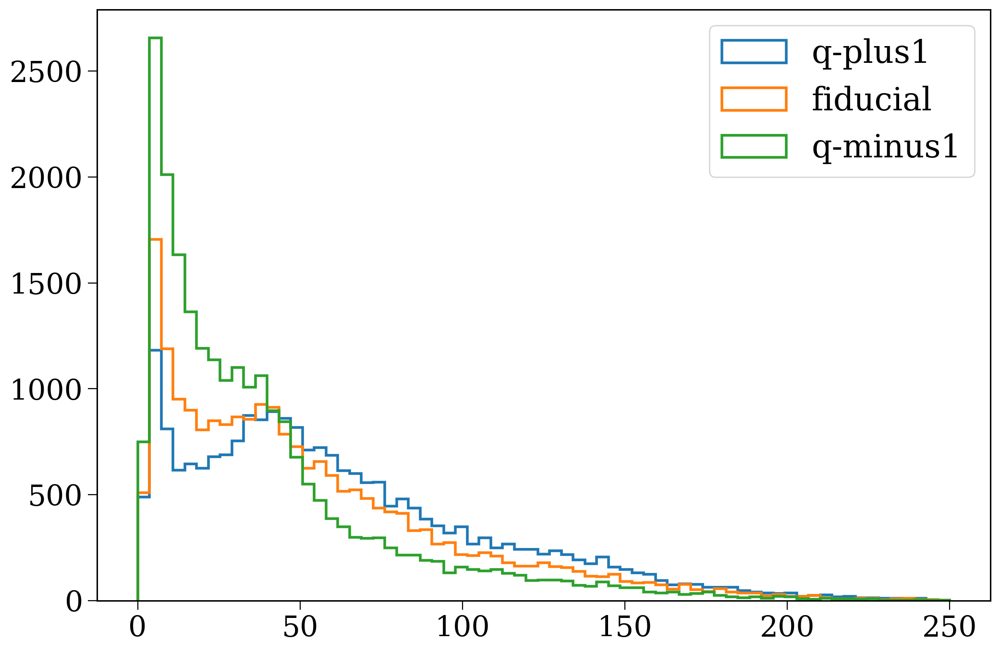

In [73]:
for p in ["q-plus1", "fiducial", "q-minus1"]:
    merger_nums = np.unique(np.concatenate((
        pops[p].sn_1_merger[pops[p].sn_1_merger].index,
        pops[p].sn_2_merger[pops[p].sn_2_merger].index,
    )))
    bpp = pops[p].bpp.loc[merger_nums]
    
    plt.hist(bpp[bpp["sep"] == 0.0].drop_duplicates(subset="bin_num", keep="first")["tphys"],
             bins=np.linspace(0, 250, 70), histtype="step", lw=2,
             label=p)

    # print(bpp[bpp["sep"] == 0.0].drop_duplicates(subset="bin_num", keep="first")["tphys"])
    
    print(p)
    print("  n_total", get_total_sn(pops[p]) / get_total_sn(pops["fiducial"]))
    print("  n_merger_sn", (pops[p].sn_1_merger.sum() + pops[p].sn_2_merger.sum()) / (pops["fiducial"].sn_1_merger.sum() + pops["fiducial"].sn_2_merger.sum()))
    print("  n_sn_2", pops[p].sn_2.sum() / pops["fiducial"].sn_2.sum())
plt.legend()
plt.show()

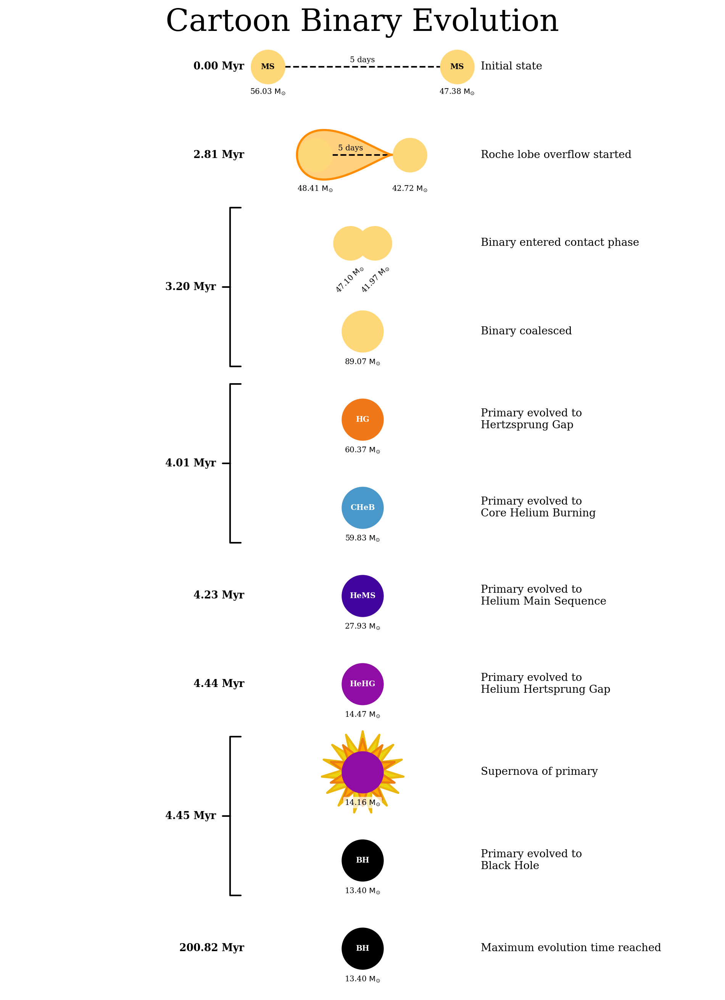

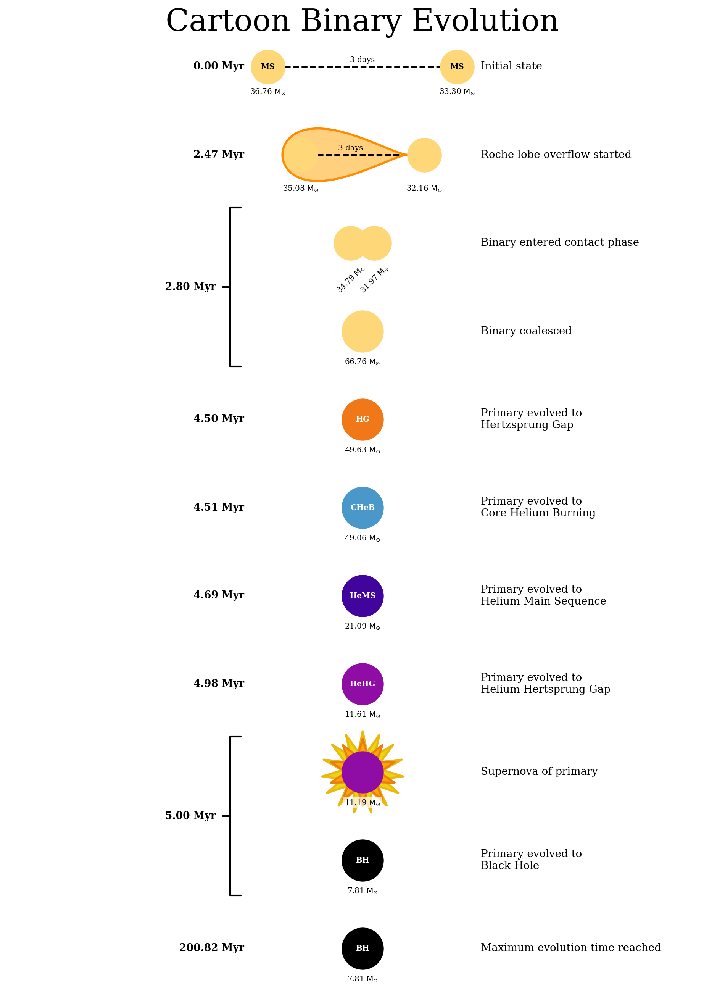

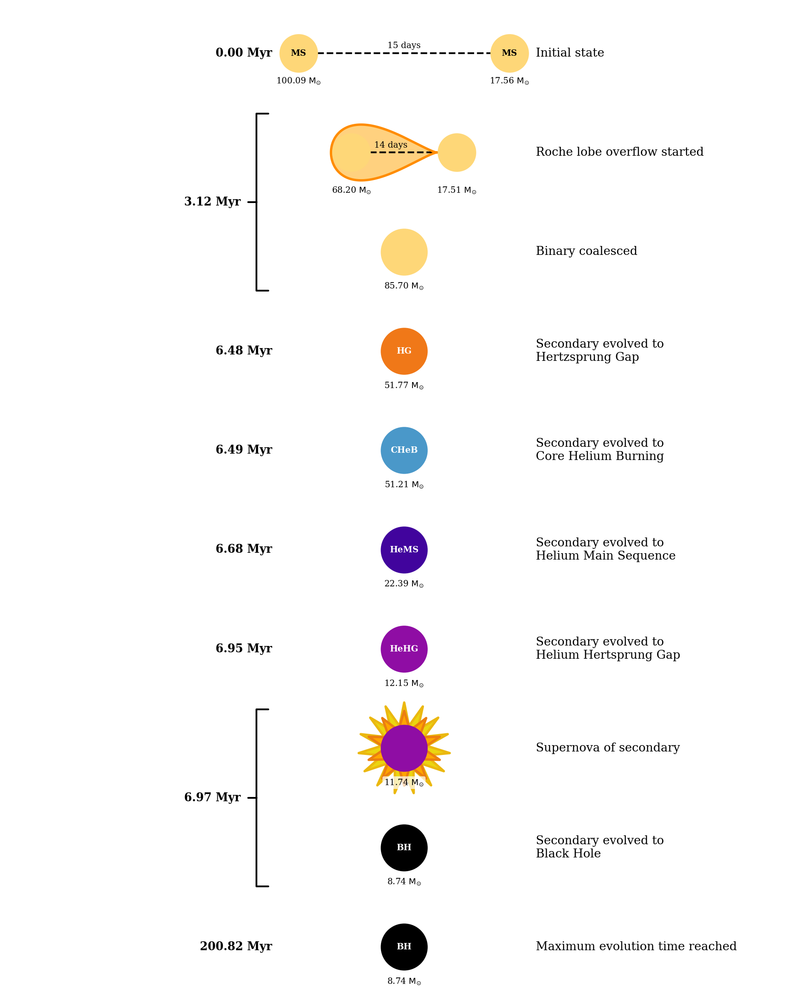

In [381]:
for p, i in zip(["q-plus1", "fiducial", "q-minus1"], [11, 100, 16]):
    pops[p].plot_cartoon_binary(i)

### Distances

I wonder if this is because the more equal mass variation has shorter times between disruptions and the secondary supernova?

In [100]:
for p in ["q-plus1", "fiducial", "q-minus1"]:
    sn_2_bpp = pops[p].bpp.loc[pops[p].sn_2[pops[p].sn_2].index]
    sn_2_rows = sn_2_bpp[(sn_2_bpp["evol_type"] == 16) & (sn_2_bpp["sep"] < 0)]
    disrupt_times = pops[p].bpp[pops[p].bpp["sep"] < 0].drop_duplicates(subset="bin_num")["tphys"]
    print(len(sn_2_rows))
    d_time = disrupt_times.loc[sn_2_rows["bin_num"]]
    sn_time = sn_2_rows["tphys"]
    print(f"Average time between disruption and SN_2: {np.mean(sn_time - d_time):1.1f} Myr")

12220
Average time between disruption and SN_2: 5.2 Myr
10613
Average time between disruption and SN_2: 6.2 Myr
7630
Average time between disruption and SN_2: 7.7 Myr


YUP

# Metallicity

In [38]:
z_pop_file_names = ["fiducial", "Z-0.5", "Z-0.2", "Z-0.1", "Z-0.05"]
z_pops = {p:pops[p] for p in z_pop_file_names}
z_pop_labels = [pop_details["labels"][pop_details["file_names"].index(f)] for f in z_pop_file_names]

/mnt/home/twagg/miniconda3/envs/cogsworth/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/mnt/home/twagg/miniconda3/envs/cogsworth/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


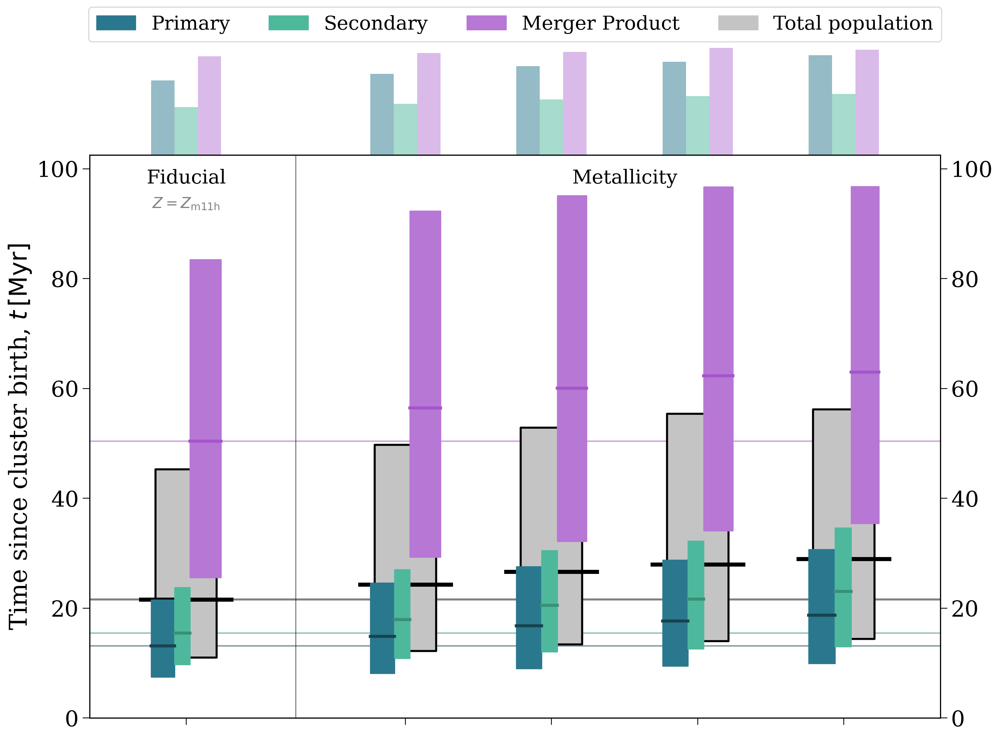

/mnt/home/twagg/miniconda3/envs/cogsworth/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/mnt/home/twagg/miniconda3/envs/cogsworth/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


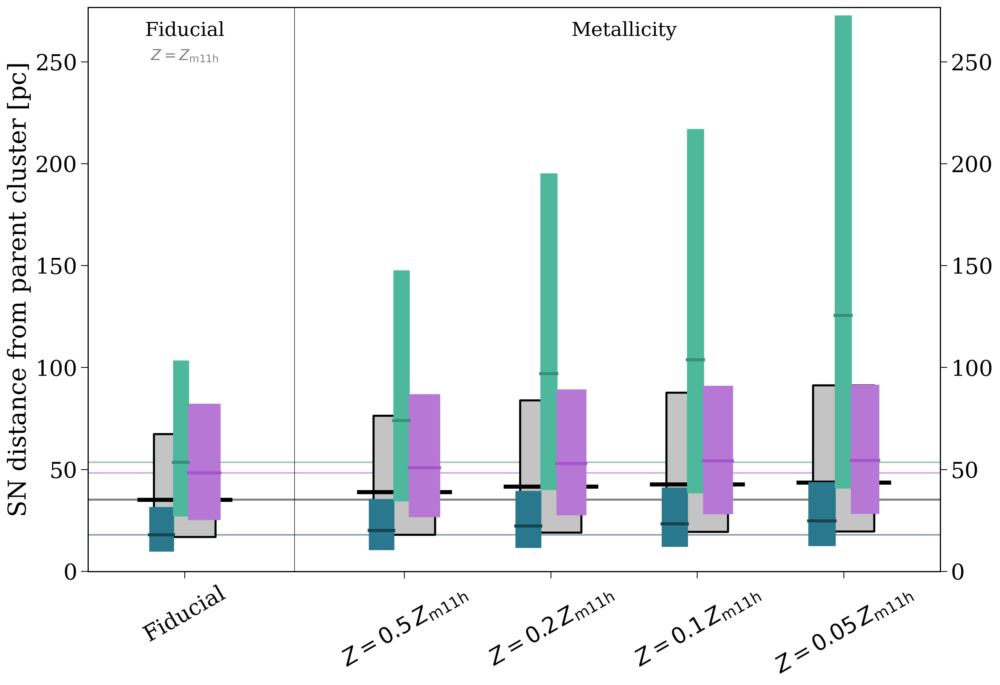

In [191]:
reload(plotting)
fig, ax = plotting.compare_variations(z_pops, z_pop_labels, quantity="time", annotate_loc=100,
                                      group_start_inds=[1, 10], figwidth=15,
                                      group_labels=["Fiducial", "Metallicity"],
                                      fiducial_settings=[r"$Z = Z_{\rm m11h}$"],
                                      show=False, show_labels=False, an_fs_mod=1.2)
plt.savefig("../plots/variations/var-z-time.pdf", format="pdf", bbox_inches="tight")
plt.show()

reload(plotting)
fig, ax = plotting.compare_variations(z_pops, z_pop_labels, quantity="distance", annotate_loc=270,
                                      group_start_inds=[1, 10], figwidth=15,
                                      group_labels=["Fiducial", "Metallicity"],
                                      fiducial_settings=[r"$Z = Z_{\rm m11h}$"],
                                      show=False, show_rel_bars=False, show_legend=False, an_fs_mod=1.2, rotate_labels=30)
plt.savefig("../plots/variations/var-z-dist.pdf", format="pdf", bbox_inches="tight")
plt.show()

## Timing

In [51]:
for p in ["fiducial", "Z-0.1"]:
    sn_demographics(pops[p], norm=True)

    secondary_overflow = pops[p].bpp[pops[p].bpp["RRLO_2"] >= 1]["bin_num"].unique()
    sn_1_nums = pops[p].sn_1[pops[p].sn_1].index
    focus = sn_1_nums[~np.isin(sn_1_nums, secondary_overflow)]
    
    print(pops[p].initC.loc[focus]["mass_1"].min())
    tiny_num = pops[p].initC[pops[p].initC["mass_1"] == pops[p].initC.loc[focus]["mass_1"].min()]["bin_num"].iloc[0]
    # print(tiny_num)
    # pops[p].plot_cartoon_binary(tiny_num)
    # print(len(pops[p]))

7.024426944075158
6.155183402440931


In [52]:
import numpy as np
from scipy.integrate import quad
from scipy.interpolate import interp1d
import h5py as h5
import functools

@functools.lru_cache()
def __get_imf_normalisation_values(m1=0.01, m2=0.08, m3=0.5, m4=200.0, a12=0.3, a23=1.3, a34=2.3):
    b1 = 1 / (
            (m2 ** (1 - a12) - m1 ** (1 - a12)) / (1 - a12)
            + m2 ** (-(a12 - a23)) * (m3 ** (1 - a23) - m2 ** (1 - a23)) / (1 - a23)
            + m2 ** (-(a12 - a23)) * m3 ** (-(a23 - a34)) * (m4 ** (1 - a34) - m3 ** (1 - a34)) / (1 - a34)
    )
    b2 = b1 * m2 ** (-(a12 - a23))
    b3 = b2 * m3 ** (-(a23 - a34))
    return b1, b2, b3

@np.vectorize
def IMF(m, m1=0.01, m2=0.08, m3=0.5, m4=200.0, a12=0.3, a23=1.3, a34=2.3):
    """Calculate the fraction of stellar mass between m and m + dm for a three part broken power law.

    Default values follow Kroupa (2001)
    https://arxiv.org/abs/astro-ph/0009005
    Equation 1-2

            zeta(m) ~ m^(-a_ij)
    Parameters
    ----------
    m : `float` or `np.ndarray`
        Mass at which to evaluate
    mi : float, optional
        masses at which to transition the slope
    aij : float, optional
        slope of the IMF between mi and mj
    Returns
    -------
    imf_vals
        IMF evaluated at the given masses
    """
    # calculate normalisation constants that ensure the IMF is continuous
    b1, b2, b3 = __get_imf_normalisation_values(m1, m2, m3, m4, a12, a23, a34)

    # evaluate IMF either at a point or for a list of points
    if m1 <= m < m2:
        return b1 * m ** (-a12)
    elif m2 <= m < m3:
        return b2 * m ** (-a23)
    elif m3 <= m < m4:
        return b3 * m ** (-a34)
    else:
        return 0.0

In [53]:
quad(IMF, 6.2, 150)[0] / quad(IMF, 7.0, 150)[0]

1.1741362148840977

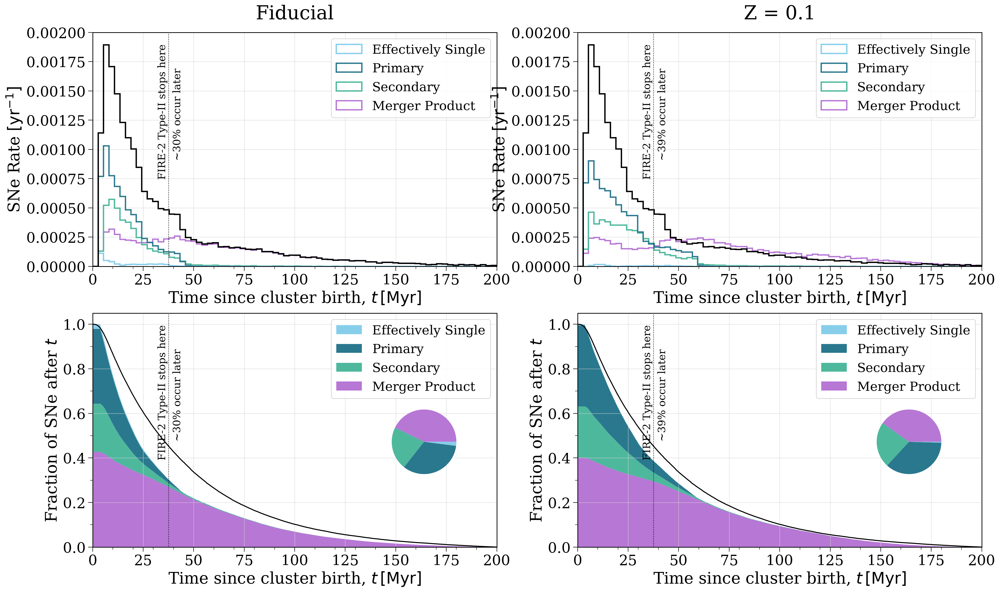

In [136]:
reload(plotting)
fig, axes = plt.subplots(2, 2, figsize=(24, 14))

for p, x, l in zip(["fiducial", "Z-0.1"],
                   [axes[:, 0], axes[:, 1]],
                   [r"Fiducial", r"Z = 0.1"]):
    plotting.sandpile(pops[p], bins=np.linspace(0, 200, 75), var="time",
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 0.002)}, fig=fig, axes=x, show=False, stacked=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

### Compare to Manos

Doesn't look like the definition of $f_{\rm late}$ matters

In [50]:
z_late_fracs = []
for p in z_pops:
    sn_times = np.concatenate(plotting.get_data_and_weights(pops[p], "time", [1])[0])
    z_late_fracs.append((sn_times > 44).sum() / len(sn_times))
    print((sn_times > 44).sum() / len(sn_times), (sn_times > 50).sum() / len(sn_times))

0.2526348722160302 0.22271758471676345
0.2908949185256672 0.24425596674214023
0.31759049773755654 0.2680818721719457
0.33483863300680783 0.28699726669269815
0.3439222202115584 0.2941418395380591


Minimum mass and fraction of IMF is definitely changing a lot

In [54]:
last_sn_times = []

for p in z_pops:
    forward_mt_nums = pops[p].bpp["bin_num"][(pops[p].bpp["evol_type"] == 3) & (pops[p].bpp["RRLO_1"] >= 1)]
    reverse_mt_nums = pops[p].bpp["bin_num"][(pops[p].bpp["evol_type"] == 3) & (pops[p].bpp["RRLO_2"] >= 1)]
    primary_sn_nums = pops[p].sn_1[pops[p].sn_1].index
    secondary_sn_nums = pops[p].sn_2[pops[p].sn_2].index
    m1s = pops[p].initC["mass_1"][~np.isin(pops[p].bin_nums, reverse_mt_nums)
                                  & np.isin(pops[p].bin_nums, primary_sn_nums)]
    m2s = pops[p].initC["mass_2"][~np.isin(pops[p].bin_nums, forward_mt_nums)
                                  & np.isin(pops[p].bin_nums, secondary_sn_nums)]
    bpp_rows = pops[p].bpp.loc[m1s.iloc[[m1s.argmin()]].index]
    last_sn_times.append(bpp_rows[bpp_rows["evol_type"] == 15]["tphys"].values[0])
    # print(m2s.iloc[[m2s.argmin()]])
    imf_min = min(m1s.min(), m2s.min())
    imf_min = m1s.min()

    regular_norm = quad(IMF, 7.02, 150)[0]
    print(p, imf_min.round(2), round(quad(IMF, imf_min, 150)[0] / regular_norm, 2))

fiducial 7.02 1.0
Z-0.5 6.66 1.07
Z-0.2 6.42 1.13
Z-0.1 6.16 1.19
Z-0.05 6.06 1.21


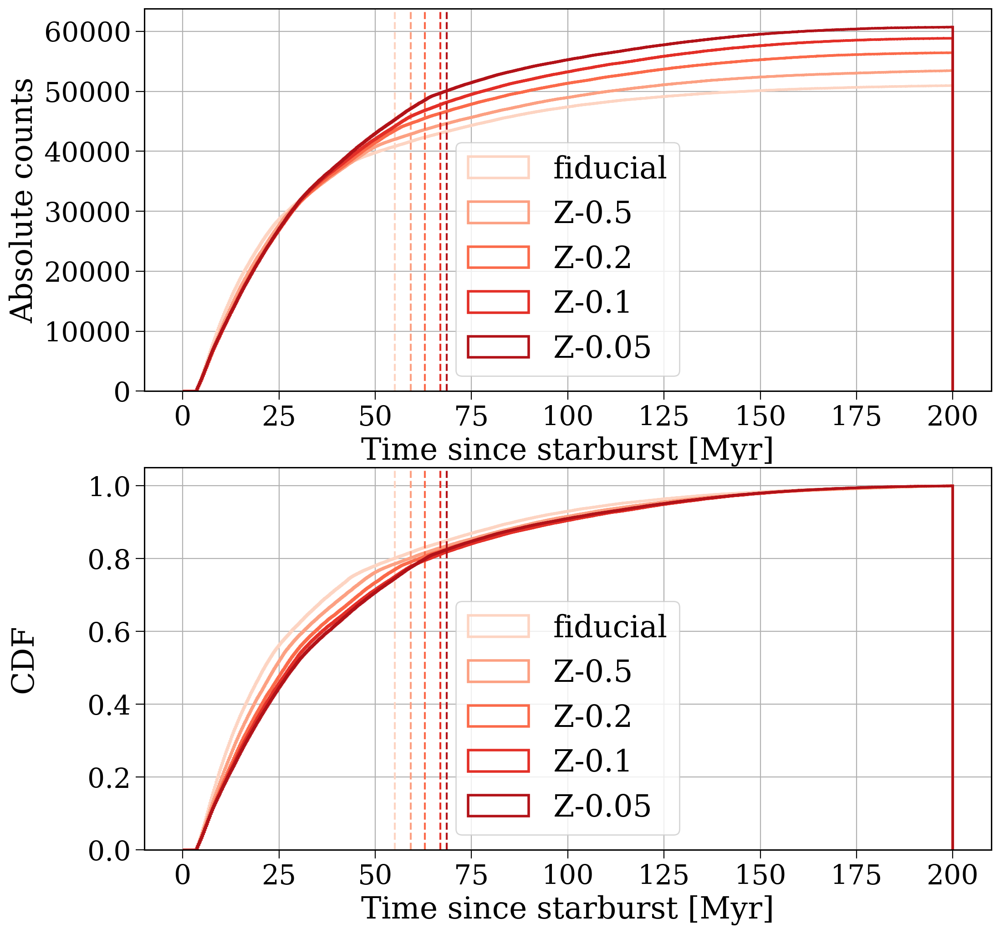

In [315]:
fig, axes = plt.subplots(2, 1, figsize=(12, 12))

cs = [plt.get_cmap("Reds", len(z_pops) + 2)(i + 1) for i in range(len(z_pops))]

after_singles_sn = []

for ax, density in zip(axes, [False, True]):
    for p, c, lst in zip(z_pops, cs, last_sn_times):
        sn_times = np.concatenate(plotting.get_data_and_weights(pops[p], "time", [1])[0])
        # sn_times = plotting.get_data_and_weights(pops[p], "time", [1])[0][1]
        ax.axvline(lst, color=c, linestyle="--")

        if density:
            after_singles_sn.append((sn_times > lst).sum() / len(sn_times))
        ax.hist(sn_times, bins=1000, histtype="step", color=c, label=p,
                 cumulative=True, range=(0, 200), density=density, lw=2)

    ax.legend()
    ax.grid()
    ax.set(xlabel="Time since starburst [Myr]",
           ylabel="Absolute counts" if not density else "CDF")

fig.align_ylabels()
plt.show()

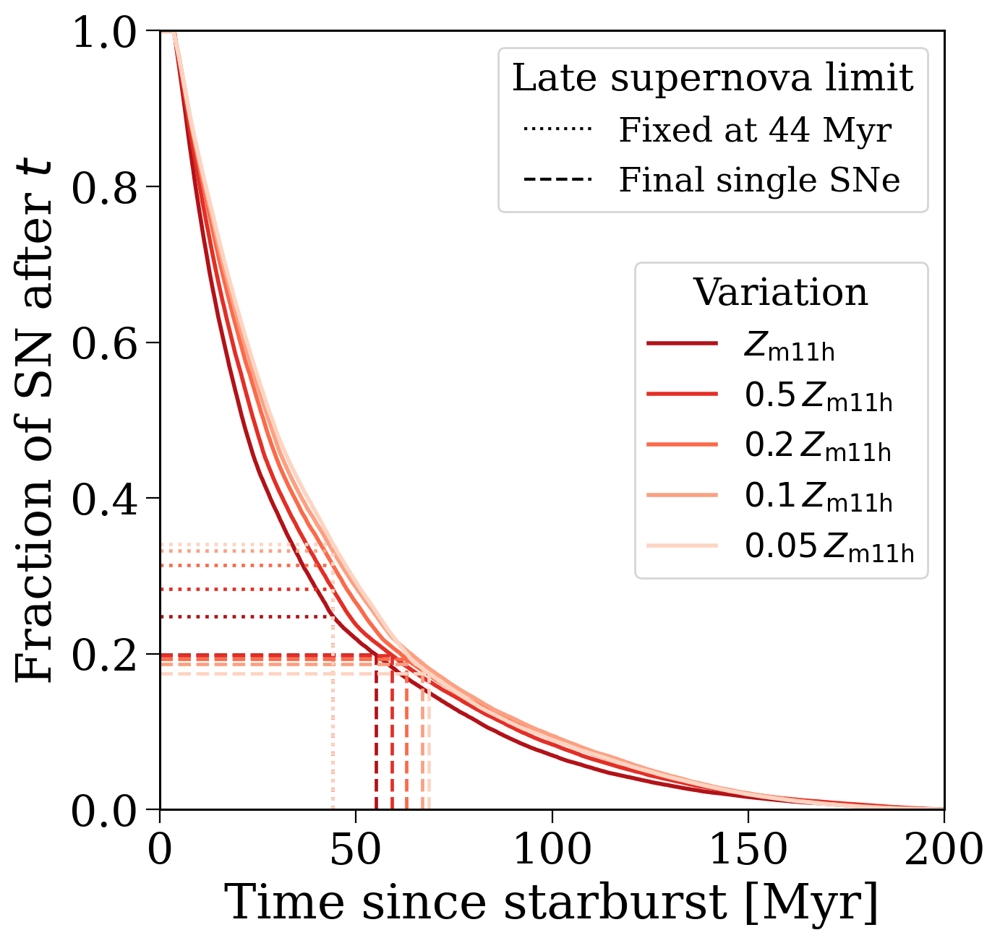

In [62]:
fig, ax = plt.subplots(figsize=(7, 7))

ls = "--"
lw = 1.7

cs = list(reversed([plt.get_cmap("Reds", len(z_pops) + 2)(i + 1) for i in range(len(z_pops))]))
labels = [r"$Z_{\rm m11h}$", r"$0.5 \, Z_{\rm m11h}$", r"$0.2 \, Z_{\rm m11h}$", r"$0.1 \, Z_{\rm m11h}$", r"$0.05 \, Z_{\rm m11h}$"]

for p, c, lst, l in zip(z_pops, cs, last_sn_times, labels):
    sn_times = np.concatenate(plotting.get_data_and_weights(pops[p], "time", [1])[0])

    h, bins = np.histogram(sn_times, bins=1000, range=(0, 200))
    centres = plotting.get_centres_widths(bins)[0]
    y_vals = 1 - np.cumsum(h) / np.sum(h)
    ax.plot(centres, y_vals, color=c, label=l, lw=2)

    for val, ls in zip([lst, 44], ["--", "dotted"]):
        ax.plot([val, val], [0, y_vals[centres > val][0]], color=c, linestyle=ls, lw=lw)
        ax.plot([0, val], [y_vals[centres > val][0], y_vals[centres > val][0]], color=c, linestyle=ls, lw=lw)

leg = ax.legend(title="Variation", title_fontsize=0.8*fs, fontsize=0.7*fs, loc="center right")
ax.set(xlabel="Time since starburst [Myr]",
       ylabel="Fraction of SN after $t$",
       xlim=(0, 200),
       ylim=(0, 1))

plot_lines = []
plot_lines.append(ax.plot([1e6, 1e6], [1e6, 1e6], linestyle="dotted", color="black", label="Fixed at 44 Myr"))
plot_lines.append(ax.plot([1e6, 1e6], [1e6, 1e6], linestyle="--", color="black", label="Final single SNe"))

handles, labels = ax.get_legend_handles_labels()

ax.legend(handles[-2:], labels[-2:], title="Late supernova limit", title_fontsize=0.8*fs, fontsize=0.7*fs)
ax.add_artist(leg)

plt.savefig("../plots/metallicity_explain_manos.pdf", format="pdf", bbox_inches="tight")

plt.show()

Text(0.32, 1.05, 'Decreasing metallicity')

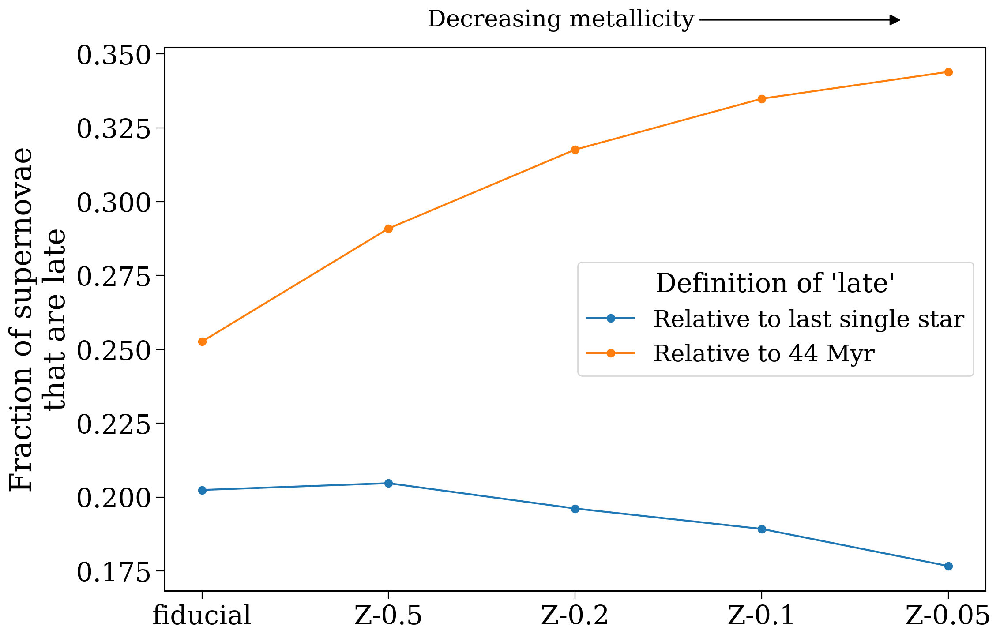

In [312]:
plt.plot([p for p in z_pops], after_singles_sn, marker='o', label="Relative to last single star")
plt.plot([p for p in z_pops], z_late_fracs, marker='o', label="Relative to 44 Myr")
plt.ylabel("Fraction of supernovae\nthat are late")
plt.legend(title="Definition of 'late'", fontsize=0.8*fs, title_fontsize=0.9*fs)

plt.annotate("Decreasing metallicity", xy=(0.9, 1.05), xytext=(0.32, 1.05), xycoords="axes fraction", arrowprops=dict(arrowstyle="-|>", color='k'), fontsize=0.8*fs, va="center")

In [287]:
after_singles_sn

[0.20240120451301305,
 0.20468802197394306,
 0.19612556561085973,
 0.18922635519413272,
 0.17666606346751773]

## Distances

Ejection velocities are changing for secondaries from angular momentum loss?

In [380]:
0.4 * 10000 * 2/3

2666.6666666666665

In [375]:
quad(IMF, 0.08, 4)[0]

0.6185241471825722

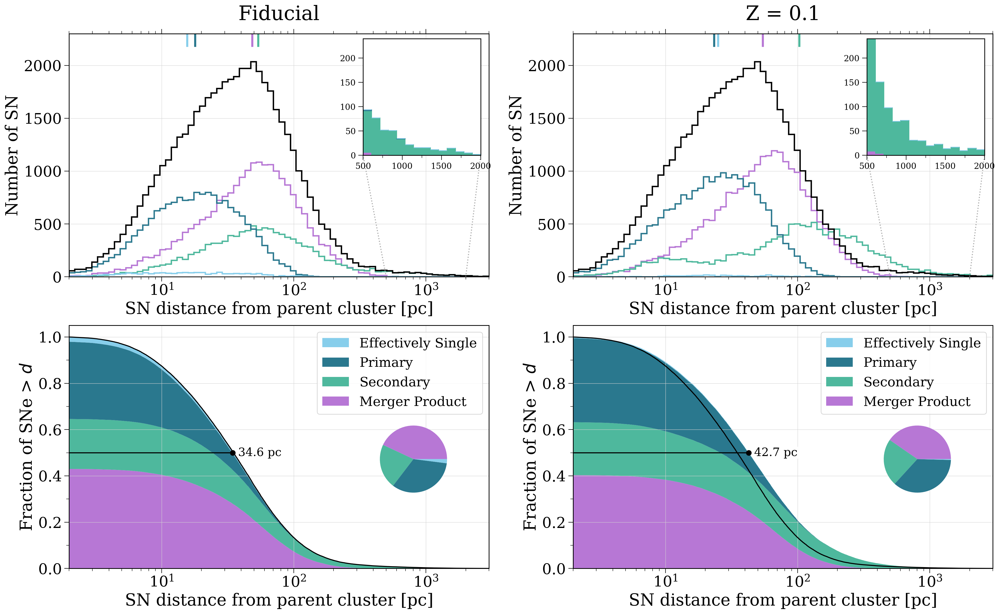

In [193]:
reload(plotting)
fig, axes = plt.subplots(2, 2, figsize=(24, 14))

for p, x, l in zip(["fiducial", "Z-0.1"],
                   [axes[:, 0], axes[:, 1]],
                   [r"Fiducial", r"Z = 0.1"]):
    plotting.sandpile(pops[p], bins=np.geomspace(2e0, 3e3, 75),
                      comparison_pop=pops["fiducial"],
                      top_ax_dict={"ylim": (0, 2300)},
                      inset_ax_dict={"ylim": (0, 240)}, fig=fig, axes=x, show=False, stacked=False)
    x[0].set_title(l, fontsize=1.2 * fs, pad=20)
plt.show()

In [77]:
for p in ["fiducial", "Z-0.5", "Z-0.2", "Z-0.1", "Z-0.05"]:
    sn_1_nums = pops[p].sn_1[pops[p].sn_1].index
    sn_2_nums = pops[p].sn_2[pops[p].sn_2].index
    sn_2_nums = sn_2_nums[np.isin(sn_2_nums, sn_1_nums)]
    ki = pops[p].kick_info.loc[sn_2_nums]
    v_ej = ki[ki["star"] == 1]["vsys_2_total"]

    print((v_ej != 0.0).sum())
    
    print(np.mean(v_ej), np.mean(v_ej[v_ej > 0.0]))

10410
14.689544966379762 14.99434244118649
10044
16.844975703156432 18.740119325674033
10316
18.481372955295647 21.856606248023155
10811
18.315100502503114 22.28611110077037
10713
21.252519846101666 26.690133670255936


1188.071815152779
593.528474332251
437.69079957079845
483.82586630088826
354.8449955180605


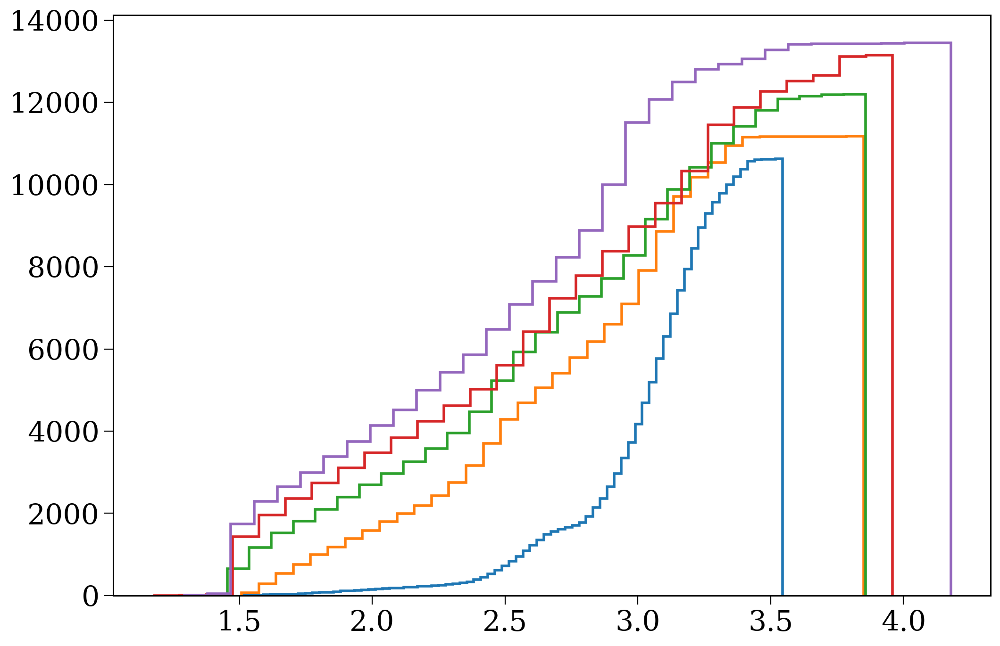

In [80]:
for p in ["fiducial", "Z-0.5", "Z-0.2", "Z-0.1", "Z-0.05"]:
    sn_1_nums = pops[p].sn_1[pops[p].sn_1].index
    sn_2_nums = pops[p].sn_2[pops[p].sn_2].index
    sn_2_nums = sn_2_nums[np.isin(sn_2_nums, sn_1_nums)]
    # b = 125
    print(np.median(pops[p].bpp.loc[sn_2_nums].groupby("bin_num")["rad_1"].max()))
    plt.hist(np.log10(pops[p].bpp.loc[sn_2_nums].groupby("bin_num")["rad_1"].max()), bins="fd", histtype="step", lw=2, cumulative=True)
    # plt.plot(pops[p].bpp.loc[b]["tphys"], )
# plt.xscale("log")

plt.show()

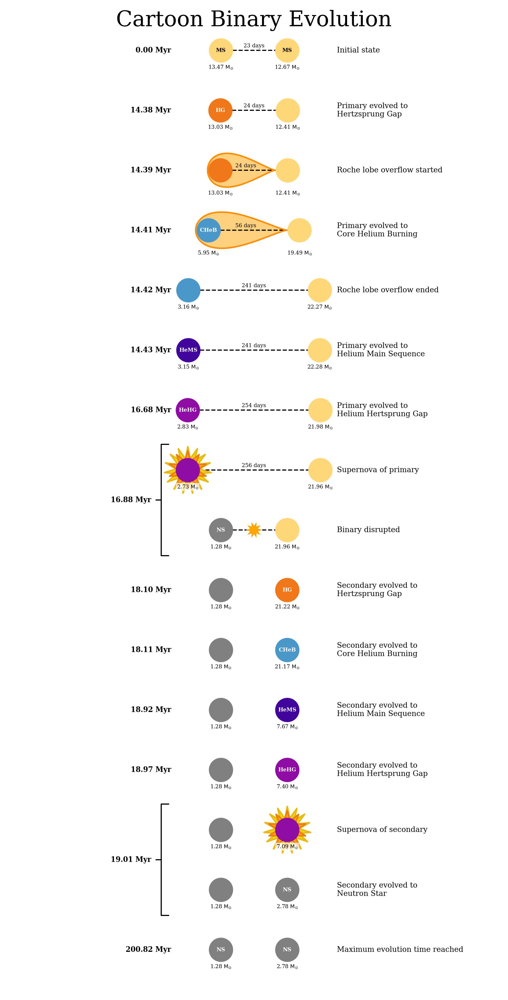

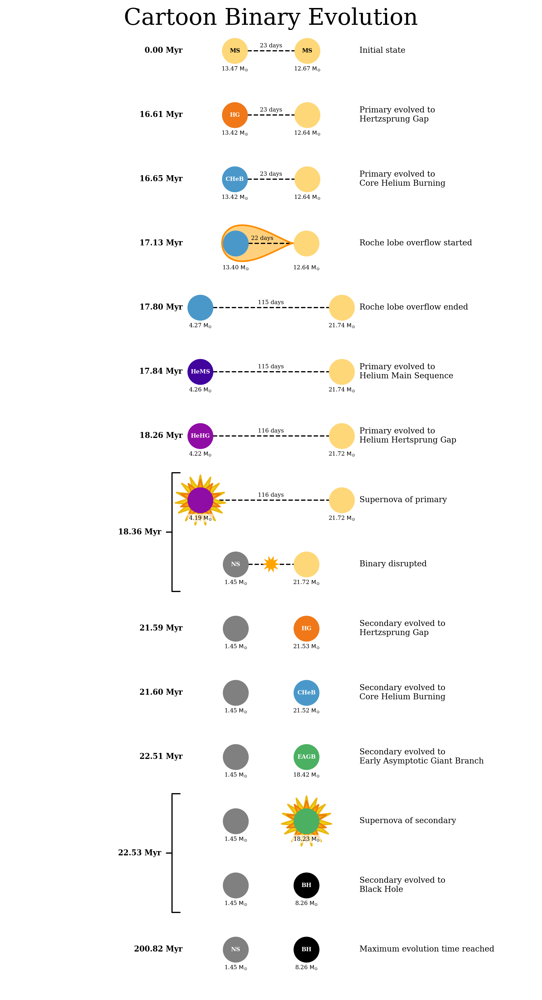

In [240]:
for p in ["fiducial", "Z-0.1"]:
    pops[p].plot_cartoon_binary(125)

## Could it be CE vs. stable as Manos suggests

In [20]:
for p in ["fiducial", "Z-0.1"]:
    sn_1_nums = pops[p].sn_1[pops[p].sn_1].index
    sn_2_nums = pops[p].sn_2[pops[p].sn_2].index
    sn_2_nums = sn_2_nums[np.isin(sn_2_nums, sn_1_nums)]

    bpp = pops[p].bpp.loc[sn_2_nums]

    print(bpp[bpp["evol_type"] == 3].drop_duplicates(subset="bin_num")["kstar_1"].value_counts())
    
    print(len(sn_2_nums))
    print(len(bpp[bpp["evol_type"] == 7].drop_duplicates(subset="bin_num")))

plt.show()

kstar_1
2     6228
1     1142
4      546
5      301
3       66
6       38
14       3
Name: count, dtype: int64
10626
686
kstar_1
2     4778
4     3991
1     1016
5      591
6       45
3       24
14       6
13       1
Name: count, dtype: int64
13155
1962


# Overall trends

## Percentiles

In [146]:
time_percs = {}
dist_percs = {}
for p in pops:
    times = np.concatenate(plotting.get_data_and_weights(pops[p], var="time", widths=[1])[0])
    time_percs[p] = [f"{x:1.1f}" for x in np.percentile(times, [2.5, 25, 50, 75, 97.5])]
    
    dists = np.concatenate(plotting.get_data_and_weights(pops[p], var="distance")[0])
    dist_percs[p] = [f"{x:1.1f}" for x in np.percentile(dists, [2.5, 25, 50, 75, 97.5])]

## Demographics


In [387]:
def get_total_sn(p):
    return p.sn_1.sum() + p.sn_2.sum() + p.sn_1_singles.sum() + p.sn_2_singles.sum() + p.sn_1_merger.sum() + p.sn_2_merger.sum()
    
def sn_demographics(p, norm=False, show=False, mod=1):
    norm_vals = [mod, mod, mod, mod] if not norm else [pops["fiducial"].sn_1_singles.sum() + pops["fiducial"].sn_2_singles.sum(),
                                            pops["fiducial"].sn_1.sum(),
                                            pops["fiducial"].sn_2.sum(),
                                            pops["fiducial"].sn_1_merger.sum() + pops["fiducial"].sn_2_merger.sum()]
    sn_singles = (p.sn_1_singles.sum() + p.sn_2_singles.sum()) / norm_vals[0]
    sn_1 = p.sn_1.sum() / norm_vals[1]
    sn_2 = p.sn_2.sum() / norm_vals[2]
    sn_M = (p.sn_1_merger.sum() + p.sn_2_merger.sum()) / norm_vals[3]
    total = (sn_1 + sn_2 + sn_M + sn_singles)

    if show:
        print(p._file.split("/")[-1].split(".h5")[0])
        print(f"  SN S: {sn_singles}")
        print(f"  SN 1: {sn_1}")
        print(f"  SN 2: {sn_2}")
        print(f"  SN M: {sn_M}")
        print(f"  TOT : {total}")
    return [sn_1, sn_2, sn_M, sn_singles, total]

In [148]:
get_total_sn(pops["fiducial"])

51141

In [149]:
sn_demographics(pops["fiducial"])

[16898.0, 10871.0, 22345.0, 1027.0, 51141.0]

In [155]:
table_labels

['Fiducial',
 'Singles, $f_{\\rm bin} = 0.0$',
 'Initial mass function slope, $\\alpha_{\\rm IMF} = -1.9',
 'Initial mass function slope, $\\alpha_{\\rm IMF} = -2.7',
 'Orbital period slope, $\\pi = 0$',
 'Orbital period slope, $\\pi = -1$',
 'Mass ratio slope, $\\kappa = 1$',
 'Mass ratio slope, $\\kappa = -1$',
 'Metallicity, $Z = 0.05 \\, Z_{\\rm m11h}$',
 'Metallicity, $Z = 0.1 \\, Z_{\\rm m11h}$',
 'Metallicity, $Z = 0.2 \\, Z_{\\rm m11h}$',
 'Metallicity, $Z = 0.5 \\, Z_{\\rm m11h}$',
 'Common-envelope, $\\alpha_{\\rm CE} = 0.1$',
 'Common-envelope, $\\alpha_{\\rm CE} = 10.0$',
 'Case B Unstable',
 'Case B Stable',
 'Mass transfer efficiency, $\\beta = 0.0$',
 'Mass transfer efficiency, $\\beta = 0.5$',
 'Mass transfer efficiency, $\\beta = 1.0$',
 '%$\\gamma = \\gamma_{\\rm disc}$',
 'Supernova kicks, $\\sigma_{\\rm CC} = 20 \\, {\\rm km/s}$',
 'Supernova kicks, $\\sigma_{\\rm low} = 265 \\, {\\rm km/s}$',
 'Supernova kicks, No fallback',
 'Velocity dispersion, $v_{\\rm disp} = 

In [167]:
indent = 8
table_rows = []

table_labels = ['Fiducial', 'Singles, $f_{\\rm bin} = 0.0$', 'Initial mass function slope, $\\alpha_{\\rm IMF} = -1.9$',
                'Initial mass function slope, $\\alpha_{\\rm IMF} = -2.7$',
                'Orbital period slope, $\\pi = 0$', 'Orbital period slope, $\\pi = -1$',
       'Mass ratio slope, $\\kappa = 1$', 'Mass ratio slope, $\\kappa = -1$',
                'Metallicity, $Z = 0.05 \\, Z_{\\rm m11h}$',
                'Metallicity, $Z = 0.1 \\, Z_{\\rm m11h}$',
                'Metallicity, $Z = 0.2 \\, Z_{\\rm m11h}$',
                'Metallicity, $Z = 0.5 \\, Z_{\\rm m11h}$',
       'Common-envelope, $\\alpha_{\\rm CE} = 0.1$', 'Common-envelope, $\\alpha_{\\rm CE} = 10.0$',
       'Case B Unstable', 'Case B Stable', 'Mass transfer efficiency, $\\beta = 0.0$',
       'Mass transfer efficiency, $\\beta = 0.5$', 'Mass transfer efficiency, $\\beta = 1.0$',
       'Supernova kicks, $\\sigma_{\\rm CC} = 20 \\, {\\rm km/s}$',
       'Supernova kicks, $\\sigma_{\\rm low} = 265 \\, {\\rm km/s}$', 'Supernova kicks, No fallback',
       'Velocity dispersion, $v_{\\rm disp} = 0.5 \ {\\rm km/s}$', 'Velocity dispersion, $v_{\\rm disp} = 5 \ {\\rm km/s}$',
       'ChaNGa (r442)']

table_rows.append(r'\textbf{Fiducial} & ' + ' & '.join([f"{x:1.0f}" for x in sn_demographics(pops["fiducial"])]) + " \\\\")
table_rows.append(r'\textbf{Binary physics} ' + '&' * 5 + r' \\')
for p, l in zip([p for p in bin_pops if p != "fiducial"], table_labels[12:22]):
    # print(p, l)
    table_rows.append(f'\quad {l} & ' + ' & '.join([f"{x:1.0f}" for x in sn_demographics(pops[p])]) + " \\\\")
    
table_rows.append(r'\textbf{Initial conditions} ' + '&' * 5 + r' \\')
for p, l in zip(["singles"] + [p for p in ini_pops if p != "fiducial"], table_labels[1:8]):
    # print(p, l)
    table_rows.append(f'\quad {l} & ' + ' & '.join([f"{x:1.0f}" for x in sn_demographics(pops[p])]) + " \\\\")
for p, l in zip([p for p in z_pops if p != "fiducial"], table_labels[8:12]):
    # print(p, l)
    table_rows.append(f'\quad {l} & ' + ' & '.join([f"{x:1.0f}" for x in sn_demographics(pops[p])]) + " \\\\")

table_rows.append(r'\textbf{Galaxy settings} ' + '&' * 5 + r' \\')
for p, l in zip([p for p in gal_pops if p != "fiducial"], table_labels[22:]):
    # print(p, l)
    table_rows.append(f'\quad {l} & ' + ' & '.join([f"{x:1.0f}" for x in sn_demographics(pops[p], mod=10 if p == "r442" else 1)]) + " \\\\")

for i in range(len(table_rows)):
    table_rows[i] = " " * indent + table_rows[i]

print("\n".join(table_rows))

        \textbf{Fiducial} & 16898 & 10871 & 22345 & 1027 & 51141 \\
        \textbf{Binary physics} &&&&& \\
        \quad Common-envelope, $\alpha_{\rm CE} = 0.1$ & 15114 & 10267 & 26329 & 1027 & 52737 \\
        \quad Common-envelope, $\alpha_{\rm CE} = 10.0$ & 18758 & 13866 & 10708 & 1027 & 44359 \\
        \quad Case B Unstable & 7790 & 3418 & 36864 & 1027 & 49099 \\
        \quad Case B Stable & 28024 & 17685 & 12887 & 1027 & 59623 \\
        \quad Mass transfer efficiency, $\beta = 0.0$ & 16723 & 10063 & 13240 & 1027 & 41053 \\
        \quad Mass transfer efficiency, $\beta = 0.5$ & 17129 & 11389 & 16820 & 1027 & 46365 \\
        \quad Mass transfer efficiency, $\beta = 1.0$ & 16962 & 11148 & 23549 & 1027 & 52686 \\
        \quad Supernova kicks, $\sigma_{\rm CC} = 20 \, {\rm km/s}$ & 17221 & 5275 & 22131 & 879 & 45506 \\
        \quad Supernova kicks, $\sigma_{\rm low} = 265 \, {\rm km/s}$ & 16903 & 11291 & 22373 & 1027 & 51594 \\
        \quad Supernova kicks, No fallback & 169

In [168]:
indent = 8
table_rows = []

table_rows.append(r'\textbf{Fiducial} & ' + ' & '.join(np.concatenate((time_percs["fiducial"],
                                                                       dist_percs["fiducial"]))) + " \\\\")
table_rows.append(r'\textbf{Binary physics} ' + '&' * 10 + r' \\')
for p, l in zip([p for p in bin_pops if p != "fiducial"], table_labels[12:22]):
    # print(p, l)
    table_rows.append(f'\quad {l} & ' + ' & '.join(np.concatenate((time_percs[p],
                                                                   dist_percs[p]))) + " \\\\")
    
table_rows.append(r'\textbf{Initial conditions} ' + '&' * 10 + r' \\')
for p, l in zip(["singles"] + [p for p in ini_pops if p != "fiducial"], table_labels[1:8]):
    # print(p, l)
    table_rows.append(f'\quad {l} & ' + ' & '.join(np.concatenate((time_percs[p],
                                                                   dist_percs[p]))) + " \\\\")
for p, l in zip(["singles"] + [p for p in z_pops if p != "fiducial"], table_labels[8:12]):
    # print(p, l)
    table_rows.append(f'\quad {l} & ' + ' & '.join(np.concatenate((time_percs[p],
                                                                   dist_percs[p]))) + " \\\\")

table_rows.append(r'\textbf{Galaxy settings} ' + '&' * 10 + r' \\')
for p, l in zip([p for p in gal_pops if p != "fiducial"], table_labels[22:]):
    # print(p, l)
    table_rows.append(f'\quad {l} & ' + ' & '.join(np.concatenate((time_percs[p],
                                                                   dist_percs[p]))) + " \\\\")

for i in range(len(table_rows)):
    table_rows[i] = " " * indent + table_rows[i]

print("\n".join(table_rows))

        \textbf{Fiducial} & 4.4 & 10.8 & 21.4 & 44.4 & 142.1 & 4.5 & 16.5 & 34.6 & 66.6 & 239.7 \\
        \textbf{Binary physics} &&&&&&&&&& \\
        \quad Common-envelope, $\alpha_{\rm CE} = 0.1$ & 4.4 & 11.1 & 22.2 & 43.8 & 138.1 & 4.5 & 16.8 & 34.7 & 65.2 & 205.7 \\
        \quad Common-envelope, $\alpha_{\rm CE} = 10.0$ & 4.3 & 9.6 & 17.6 & 31.5 & 104.0 & 4.2 & 14.8 & 30.4 & 59.2 & 246.8 \\
        \quad Case B Unstable & 4.3 & 12.1 & 27.0 & 53.8 & 142.4 & 4.3 & 15.9 & 33.5 & 63.4 & 200.7 \\
        \quad Case B Stable & 4.5 & 12.1 & 25.3 & 57.8 & 185.3 & 4.8 & 18.5 & 40.4 & 85.3 & 541.2 \\
        \quad Mass transfer efficiency, $\beta = 0.0$ & 4.2 & 9.1 & 17.1 & 31.1 & 92.3 & 4.0 & 13.5 & 28.2 & 59.4 & 422.6 \\
        \quad Mass transfer efficiency, $\beta = 0.5$ & 4.3 & 10.0 & 19.2 & 36.1 & 99.3 & 4.3 & 15.2 & 32.0 & 64.5 & 333.9 \\
        \quad Mass transfer efficiency, $\beta = 1.0$ & 4.4 & 11.0 & 22.0 & 46.6 & 141.7 & 4.5 & 16.8 & 35.5 & 68.4 & 235.1 \\
        \quad Sup